<a href="https://colab.research.google.com/github/Alaa-c/MachineLearningProj/blob/main/HeadPoseProj/headPose.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install mediapipe

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 32.8 MB 1.3 MB/s 


In [ ]:
import numpy as np
import os,cv2,math,glob,random
import scipy.io as sio
from math import cos, sin
from pathlib import Path
import pandas as pd
import mediapipe
import warnings
warnings.filterwarnings('ignore')
from google.colab.patches import cv2_imshow
from sklearn.model_selection import train_test_split
from sklearn import svm
import xgboost as xgb
from sklearn.model_selection import GridSearchCV #optimze parameters
from sklearn.ensemble import RandomForestRegressor as rf
from sklearn.metrics import mean_squared_error as mse

In [ ]:
def get_list_from_filenames(file_path):
  lines=[Path(f).stem for f in glob.glob(file_path)]
  return lines

In [ ]:
def get_ypr_from_mat(mat_path):#get yaw,pitch,roll in radians
  mat=sio.loadmat(mat_path)
  pre_pose_params=mat['Pose_Para'][0]
  #get ypr
  pose_params=pre_pose_params[:3]
  return pose_params
    

In [ ]:
# Loading AFLW2000 Data
%%capture
if os.path.isfile('/content/AFLW2000-3D.zip') == False:
  !gdown --id  1fP3zvSCYjll_o_m7S12nvQLZ9MnsEoap
  !unzip /content/AFLW2000-3D.zip

In [5]:
def draw_axis(img, pitch,yaw,roll, tdx=None, tdy=None, size = 100):

    yaw = -yaw
    if tdx != None and tdy != None:
        tdx = tdx
        tdy = tdy
    else:
        height, width = img.shape[:2]
        tdx = width / 2
        tdy = height / 2

    # X-Axis pointing to right. drawn in red
    x1 = size * (cos(yaw) * cos(roll)) + tdx
    y1 = size * (cos(pitch) * sin(roll) + cos(roll) * sin(pitch) * sin(yaw)) + tdy

    # Y-Axis | drawn in green
    #        v
    x2 = size * (-cos(yaw) * sin(roll)) + tdx
    y2 = size * (cos(pitch) * cos(roll) - sin(pitch) * sin(yaw) * sin(roll)) + tdy

    # Z-Axis (out of the screen) drawn in blue
    x3 = size * (sin(yaw)) + tdx
    y3 = size * (-cos(yaw) * sin(pitch)) + tdy

    cv2.line(img, (int(tdx), int(tdy)), (int(x1),int(y1)),(0,0,255),3)
    cv2.line(img, (int(tdx), int(tdy)), (int(x2),int(y2)),(0,255,0),3)
    cv2.line(img, (int(tdx), int(tdy)), (int(x3),int(y3)),(255,0,0),2)

    return img

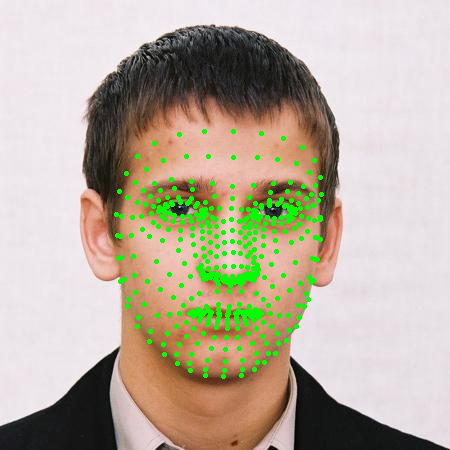

In [ ]:
# choosing random image
random_file = 'image00053'
ltest=[]
lfeatures=[]
faceModule = mediapipe.solutions.face_mesh
# loading image and its correspinding mat file
with faceModule.FaceMesh(static_image_mode=True) as faces:
    # loading the image
    image = cv2.imread('/content/AFLW2000/'+random_file+'.jpg')
    # processing the face to extract the landmark points (468 point) for each x,y,z
    results = faces.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    if results.multi_face_landmarks != None: 
      # looping over the faces in the image
      for face in results.multi_face_landmarks:
          for landmark in face.landmark:
              x = landmark.x
              y = landmark.y
              # note: the x and y values are scaled to the their width and height so we will get back their actual value in the image
              shape = image.shape 
              relative_x = int(x * shape[1])
              relative_y = int(y * shape[0])
              lfeatures.append(relative_x)
              lfeatures.append(relative_y)
      
              
              # cv2.putText(image, str(relative_y), (int(relative_x),int(relative_y)), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 2)
              cv2.circle(image, (relative_x, relative_y), radius=1, color=(0, 255, 0), thickness=2)
      cv2_imshow(image)
      ltest.append(lfeatures)
      

dict_keys(['__header__', '__version__', '__globals__', 'pt2d', 'Illum_Para', 'Color_Para', 'Tex_Para', 'Shape_Para', 'Exp_Para', 'Pose_Para', 'roi', 'pt3d_68'])


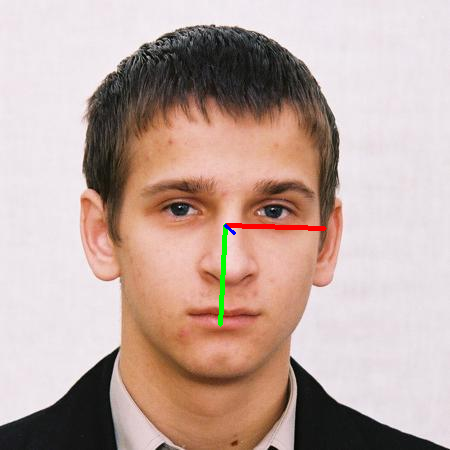

In [ ]:
image = cv2.imread('/content/AFLW2000/'+random_file+'.jpg')
# loading the mat file to extract the 3 angels of the face (pitch,yaw,roll)
mat_file = sio.loadmat('/content/AFLW2000/'+random_file+'.mat')
# extracting the labels 3 angels
pose_para = mat_file["Pose_Para"][0][:3]
print(mat_file.keys())
pitch = pose_para[0]
yaw = pose_para[1]
roll = pose_para[2]
cv2_imshow(draw_axis(image,pitch,yaw,roll))

In [6]:
def dataset_images_operations(imj_path):
    
    faceModule = mediapipe.solutions.face_mesh
    listxy=[]
    labels=[]
    c=0
    for imj in os.listdir(imj_path):
      
      if (imj.endswith('.jpg')):
        #print(c)
        # loading image and its correspinding mat file
        with faceModule.FaceMesh(static_image_mode=True) as faces:
        # loading the image
          image = cv2.imread('/content/AFLW2000/'+imj)
          # processing the face to extract the landmark points (468 point) for each x,y,z
          results = faces.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
          lfeatures=[]
          ylabels=[]
          if results.multi_face_landmarks != None: 
            # looping over the faces in the image
            for face in results.multi_face_landmarks:
                for landmark in face.landmark:
                    x = landmark.x
                    y = landmark.y
                    
                    # note: the x and y values are scaled to the their width and height so we will get back their actual value in the image
                    shape = image.shape 
                    relative_x = int(x * shape[1])
                    relative_y = int(y * shape[0])
                    lfeatures.append(relative_x)
                    lfeatures.append(relative_y)
                    cv2.circle(image, (relative_x, relative_y), radius=1, color=(0, 255, 0), thickness=2)
            #cv2_imshow(image)
            listxy.append(lfeatures)
            mat_file = sio.loadmat('/content/AFLW2000/'+imj.split('.')[0]+'.mat')
            # extracting the labels 3 angels
            pose_para = mat_file["Pose_Para"][0][:3]
            pitch = pose_para[0]
            yaw = pose_para[1]
            roll = pose_para[2]
            ylabels.append(pitch)
            ylabels.append(yaw)
            ylabels.append(roll)
            #print(ylabels)
            labels.append(ylabels)
            #cv2_imshow(draw_axis(image,pitch,yaw,roll))
    return listxy,labels


**Convert points and labels to dataframe**

In [7]:
path="/content/AFLW2000/"
listxy,labels=dataset_images_operations(path)


In [8]:
df1=pd.DataFrame(labels)
df=pd.DataFrame(listxy)
df1.rename(columns={0:'pitch',1:'yaw',2:'roll'},inplace=True)
df3=pd.concat([df,df1],axis=1)
df3

,0,1,2,3,4,5,6,7,8,9,...,929,930,931,932,933,934,935,pitch,yaw,roll
0,269,323,285,277,261,294,256,240,286,264,...,206,241,209,261,190,261,186,0.225152,-0.858014,-0.263081
1,227,311,228,287,227,292,221,251,228,278,...,221,247,224,302,212,307,209,-0.331075,0.014285,0.067926
2,226,309,231,282,228,290,224,246,232,272,...,220,245,222,295,211,299,210,-0.252363,-0.085357,0.042692
3,235,286,255,273,240,275,250,251,258,267,...,233,247,236,255,232,256,230,-0.324275,-1.004428,0.431792
4,246,273,257,252,243,260,244,235,258,246,...,219,237,221,247,215,247,212,0.138026,-0.754013,-0.034957
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1848,202,292,190,271,204,278,197,250,189,264,...,234,222,236,253,229,257,227,-0.320829,1.258194,-0.308974
1849,227,302,230,281,228,288,223,247,231,271,...,223,242,225,289,218,293,215,-0.095902,-0.078198,0.001859
1850,241,307,248,277,242,285,237,244,249,267,...,223,250,224,295,218,298,215,-0.041509,-0.216011,0.039515
1851,204,300,209,281,209,287,218,250,212,274,...,239,252,240,304,255,310,254,-0.173407,0.285409,0.461780


**Transform the points to be relative to the nose point**

In [9]:
def centeralize_imj(df4):
    df4.iloc[:,0::2]=df4.iloc[:,0::2].sub(df4[2],axis=0)
    df4.iloc[:,1::2]=df4.iloc[:,1::2].sub(df4[3],axis=0)
    return df4


In [10]:
df4=df3.copy()
df4=df4.drop(columns=['pitch','yaw','roll'],axis=1)
df4=centeralize_imj(df4)
df4

,0,1,2,3,4,5,6,7,8,9,...,926,927,928,929,930,931,932,933,934,935
0,-16,46,0,0,-24,17,-29,-37,1,-13,...,-49,-75,-48,-71,-44,-68,-24,-87,-24,-91
1,-1,24,0,0,-1,5,-7,-36,0,-9,...,26,-69,21,-66,19,-63,74,-75,79,-78
2,-5,27,0,0,-3,8,-7,-36,1,-10,...,22,-65,17,-62,14,-60,64,-71,68,-72
3,-20,13,0,0,-15,2,-5,-22,3,-6,...,-10,-42,-10,-40,-8,-37,0,-41,1,-43
4,-11,21,0,0,-14,8,-13,-17,1,-6,...,-22,-35,-22,-33,-20,-31,-10,-37,-10,-40
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1848,12,21,0,0,14,7,7,-21,-1,-7,...,40,-39,36,-37,32,-35,63,-42,67,-44
1849,-3,21,0,0,-2,7,-7,-34,1,-10,...,18,-60,14,-58,12,-56,59,-63,63,-66
1850,-7,30,0,0,-6,8,-11,-33,1,-10,...,7,-55,3,-54,2,-53,47,-59,50,-62
1851,-5,19,0,0,0,6,9,-31,3,-7,...,52,-42,47,-42,43,-41,95,-26,101,-27


**Divide by euclidean distance to scale the centered points**

In [11]:
def standarize_imj(df4):
  scale=np.sqrt((df4[8]-df4[170])**2+(df4[9]-df4[171])**2)
  df4=df4.divide(scale,axis=0)
  return df4

In [12]:
df4=standarize_imj(df4)
df4

,0,1,2,3,4,5,6,7,8,9,...,926,927,928,929,930,931,932,933,934,935
0,-0.145370,0.417940,0.0,0.0,-0.218056,0.154456,-0.263484,-0.336169,0.009086,-0.118114,...,-0.445197,-0.681424,-0.436111,-0.645081,-0.399769,-0.617825,-0.218056,-0.790452,-0.218056,-0.826795
1,-0.017843,0.428230,0.0,0.0,-0.017843,0.089215,-0.124900,-0.642345,0.000000,-0.160586,...,0.463916,-1.231162,0.374701,-1.177633,0.339016,-1.124104,1.320376,-1.338219,1.409591,-1.391748
2,-0.091871,0.496102,0.0,0.0,-0.055122,0.146993,-0.128619,-0.661470,0.018374,-0.183742,...,0.404232,-1.194320,0.312361,-1.139198,0.257238,-1.102450,1.175946,-1.304565,1.249443,-1.322939
3,-0.376288,0.244587,0.0,0.0,-0.282216,0.037629,-0.094072,-0.413917,0.056443,-0.112887,...,-0.188144,-0.790206,-0.188144,-0.752577,-0.150515,-0.696133,0.000000,-0.771391,0.018814,-0.809020
4,-0.213683,0.407940,0.0,0.0,-0.271960,0.155406,-0.252534,-0.330237,0.019426,-0.116554,...,-0.427366,-0.679900,-0.427366,-0.641049,-0.388514,-0.602197,-0.194257,-0.718752,-0.194257,-0.777029
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1848,0.276980,0.484716,0.0,0.0,0.323144,0.161572,0.161572,-0.484716,-0.023082,-0.161572,...,0.923268,-0.900186,0.830941,-0.854023,0.738615,-0.807860,1.454147,-0.969432,1.546474,-1.015595
1849,-0.048156,0.337091,0.0,0.0,-0.032104,0.112364,-0.112364,-0.545767,0.016052,-0.160520,...,0.288935,-0.963118,0.224727,-0.931014,0.192624,-0.898910,0.947066,-1.011274,1.011274,-1.059430
1850,-0.115235,0.493865,0.0,0.0,-0.098773,0.131697,-0.181084,-0.543251,0.016462,-0.164622,...,0.115235,-0.905419,0.049386,-0.888957,0.032924,-0.872494,0.773722,-0.971267,0.823108,-1.020654
1851,-0.094882,0.360550,0.0,0.0,0.000000,0.113858,0.170787,-0.588266,0.056929,-0.132834,...,0.986769,-0.797006,0.891887,-0.797006,0.815982,-0.778029,1.802751,-0.493384,1.916609,-0.512361


In [13]:
x=df4
y=df1
y


,pitch,yaw,roll
0,0.225152,-0.858014,-0.263081
1,-0.331075,0.014285,0.067926
2,-0.252363,-0.085357,0.042692
3,-0.324275,-1.004428,0.431792
4,0.138026,-0.754013,-0.034957
...,...,...,...
1848,-0.320829,1.258194,-0.308974
1849,-0.095902,-0.078198,0.001859
1850,-0.041509,-0.216011,0.039515
1851,-0.173407,0.285409,0.461780


split data into training and testing

In [14]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2)
y_test

,pitch,yaw,roll
1427,0.392175,0.691749,0.151684
1767,-0.123677,-0.246394,0.092440
219,-0.017282,-0.623240,0.098033
1430,0.012390,-0.512611,0.029883
227,-0.197102,-0.070430,0.105118
...,...,...,...
910,-0.297849,-0.202252,0.193086
63,0.075204,-0.243854,-0.162533
391,-0.035426,-0.058997,-0.104905
1762,0.101413,0.066464,-0.005796


Train the model to predict pitch

using svr

In [15]:
pitch_sv=svm.SVR()
pitch_sv.fit(x_train,y_train['pitch'])


SVR()

test the model

In [16]:
pitch_sv.score(x_test,y_test['pitch'])
yp_test=pitch_sv.predict(x_test)
print('mse in pitch using svr=',mse(y_test['pitch'],yp_test))

print('r2 in pitch using svr=',pitch_sv.score(x_test,y_test['pitch']))

mse in pitch using svr= 0.01870554753056753
r2 in pitch using svr= 0.7553864302706492


using random forest

In [ ]:
randf=rf()
randf.fit(x_train,y_train['pitch'])
yp_test=randf.predict(x_test)
print('mse in pitch using randomforest=',mse(y_test['pitch'],yp_test))
print('r2 in pitch using rf=',randf.score(x_test,y_test['pitch']))

mse in pitch using randomforest= 0.7333430607648805
r2 in pitch using rf= 0.013597881416961832


Train the model to predict yaw

In [17]:
#yaw_xg=xgb.XGBRegressor()
yaw_sv=svm.SVR()
param={'n_estimators':[15,50,100],
       'max_depth':[5,10,20],
       'learning_rate':[0.001,0.1,0.01]   
}
yaw_sv.fit(x_train,y_train['yaw'])


SVR()

test the model

In [18]:


yp_test=yaw_sv.predict(x_test)
print('mse in yaw using xgboost=',mse(y_test['yaw'],yp_test))
print('r2 in yaw using xgboost=',yaw_sv.score(x_test,y_test['yaw']))


mse in yaw using xgboost= 0.01805751484769887
r2 in yaw using xgboost= 0.9380388758224071


Train the model to predict roll

using xgboost

In [ ]:
xg2=xgb.XGBRegressor()
param={'n_estimators':[15,50,100],
       'max_depth':[5,10,20],
       'learning_rate':[0.001,0.1,0.01]   
}
xg2.fit(x_train,y_train['roll'])

[01:39:22] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor()

Test the model

In [ ]:

yp_test=xg2.predict(x_test)
print('mse in roll using xgboost=',mse(y_test['roll'],yp_test))
print('r2 in roll using xgboost=',xg2.score(x_test,y_test['roll']))

mse in roll using xgboost= 0.685003757417396
r2 in roll using xgboost= 0.18559078248338845


use svr

In [19]:
roll_sv=svm.SVR()
roll_sv.fit(x_train,y_train['roll'])

yp_test=roll_sv.predict(x_test)
print('mse in roll using svr=',mse(y_test['roll'],yp_test))
print('r2 in roll using svr=',roll_sv.score(x_test,y_test['roll']))


mse in roll using svr= 0.018772430343734714
r2 in roll using svr= 0.8076201828924092


Test on a video

In [80]:
def video_reading(video_path):
  videocap=cv2.VideoCapture(video_path)
  success,image=videocap.read()
  fw = int(videocap.get(3))
  fh= int(videocap.get(4))
  fps=int(videocap.get(cv2.CAP_PROP_FPS))

  vid=cv2.VideoWriter('output.avi',cv2.VideoWriter_fourcc('M','J','P','G'),fps,(fw,fh))
  count=0
  
  while success:
    #cv2.imwrite("/content/sample_data/Fr/frame%d.jpg"%count,image)

    ypred=[]
    success,image=videocap.read()
    print("read a new frame:",success)
    #transform imj
    features,image=test_imj(image,verbose=1)
    features=pd.DataFrame(features).T
    f=features.copy()
    origx=f[2]
    origy=f[3]
    print(origx)
    print(origy)
    c_features=centeralize_imj(features)
    imj_transf=standarize_imj(c_features)
    pitch=pitch_sv.predict(imj_transf)
    yaw=yaw_sv.predict(imj_transf)
    roll=roll_sv.predict(imj_transf)
    print(origx)
    image_mod=draw_axis(image,pitch,yaw,roll,float(origx),float(origy))
    vid.write(image_mod)
    cv2_imshow(image_mod)
    count+=1
  videocap.release()
  vid.release()  
 


read a new frame: True
0    184
Name: 2, dtype: int64
0    223
Name: 3, dtype: int64
0    184
Name: 2, dtype: int64


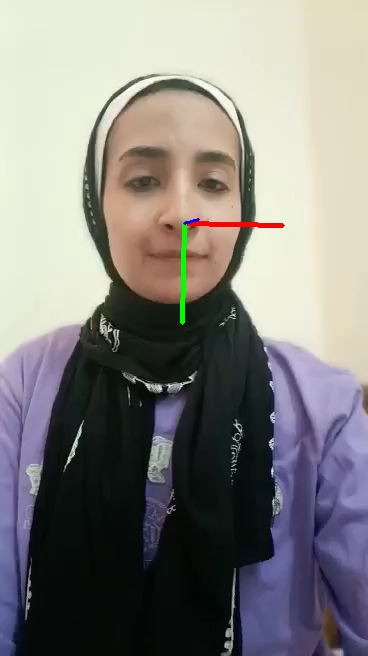

read a new frame: True
0    184
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    184
Name: 2, dtype: int64


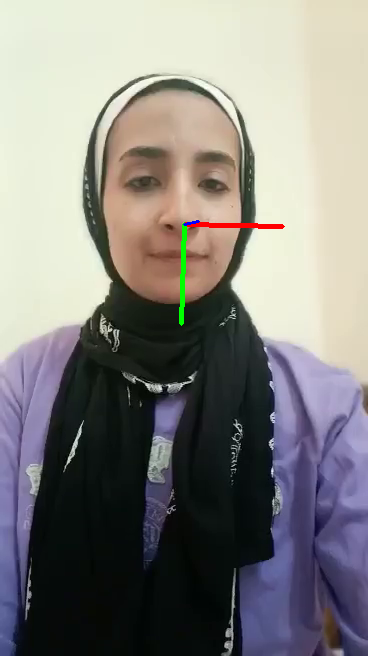

read a new frame: True
0    184
Name: 2, dtype: int64
0    228
Name: 3, dtype: int64
0    184
Name: 2, dtype: int64


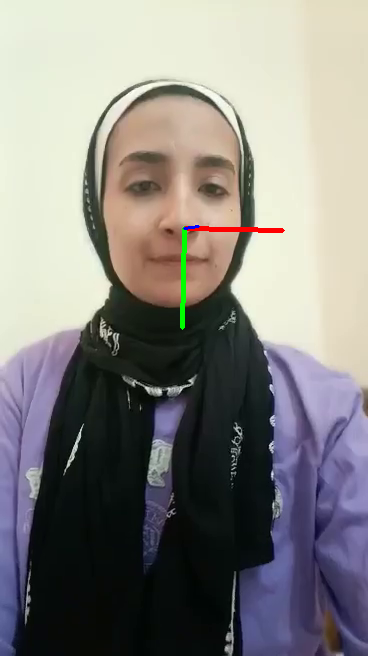

read a new frame: True
0    184
Name: 2, dtype: int64
0    229
Name: 3, dtype: int64
0    184
Name: 2, dtype: int64


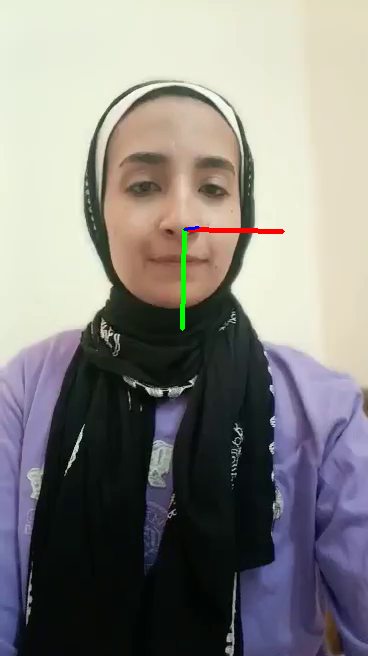

read a new frame: True
0    183
Name: 2, dtype: int64
0    229
Name: 3, dtype: int64
0    183
Name: 2, dtype: int64


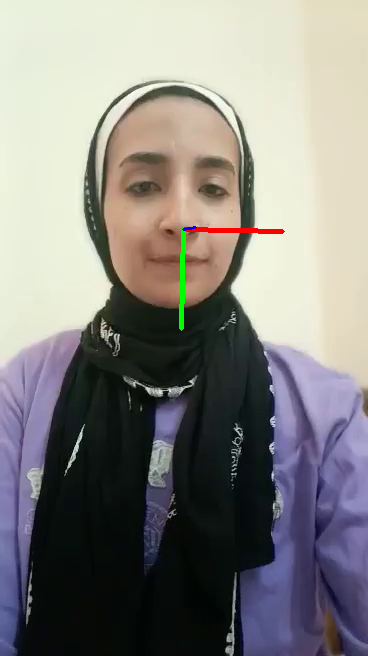

read a new frame: True
0    184
Name: 2, dtype: int64
0    226
Name: 3, dtype: int64
0    184
Name: 2, dtype: int64


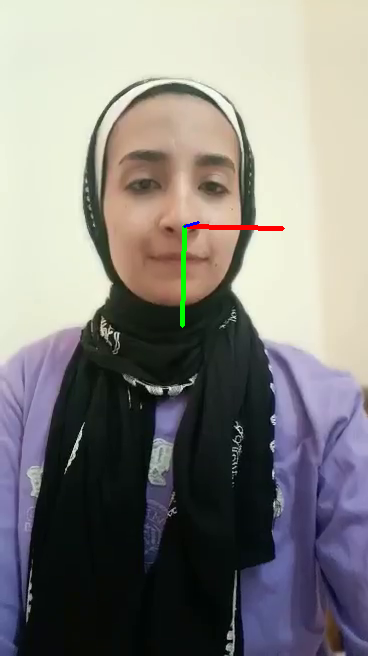

read a new frame: True
0    184
Name: 2, dtype: int64
0    226
Name: 3, dtype: int64
0    184
Name: 2, dtype: int64


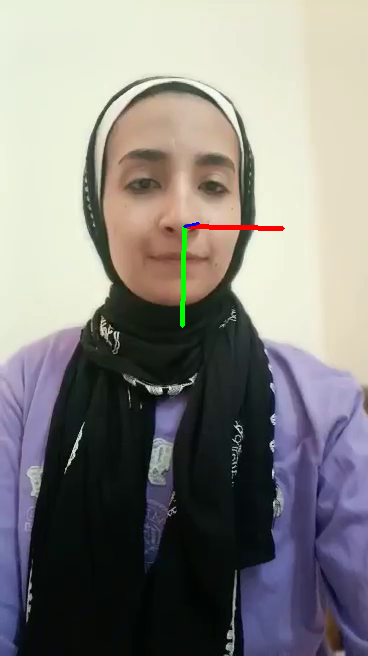

read a new frame: True
0    184
Name: 2, dtype: int64
0    226
Name: 3, dtype: int64
0    184
Name: 2, dtype: int64


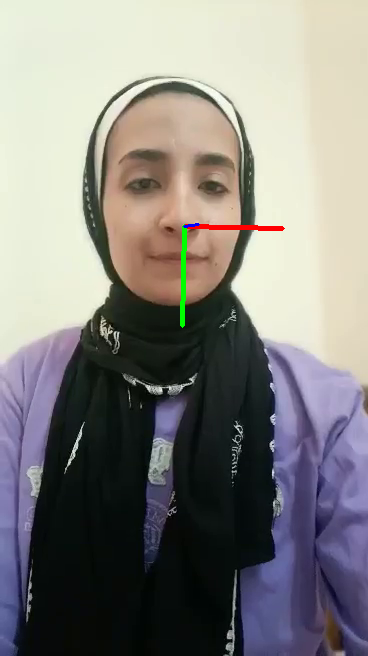

read a new frame: True
0    184
Name: 2, dtype: int64
0    225
Name: 3, dtype: int64
0    184
Name: 2, dtype: int64


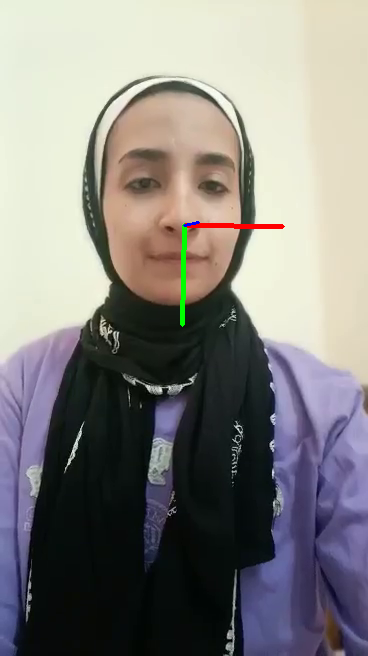

read a new frame: True
0    184
Name: 2, dtype: int64
0    226
Name: 3, dtype: int64
0    184
Name: 2, dtype: int64


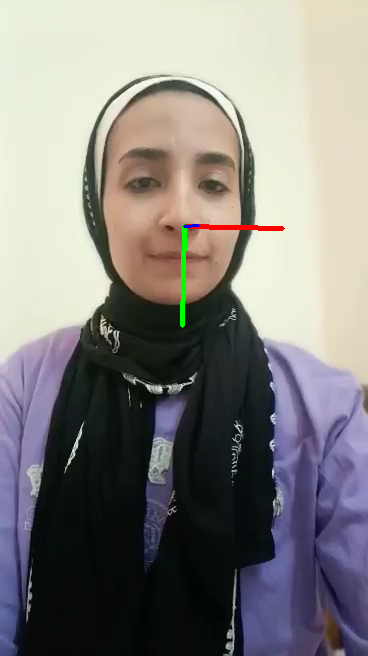

read a new frame: True
0    186
Name: 2, dtype: int64
0    225
Name: 3, dtype: int64
0    186
Name: 2, dtype: int64


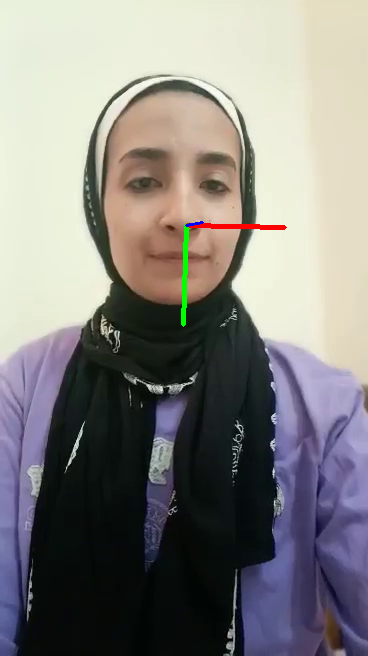

read a new frame: True
0    186
Name: 2, dtype: int64
0    226
Name: 3, dtype: int64
0    186
Name: 2, dtype: int64


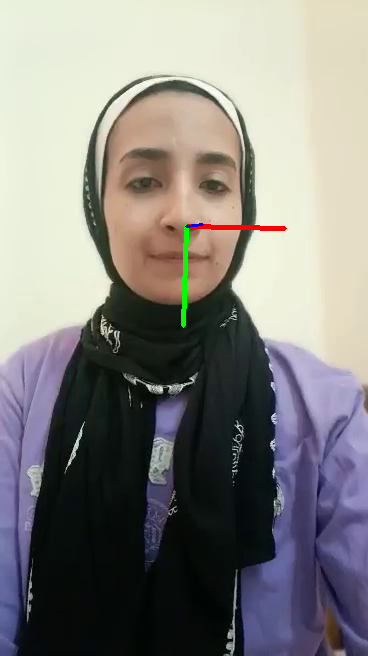

read a new frame: True
0    185
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    185
Name: 2, dtype: int64


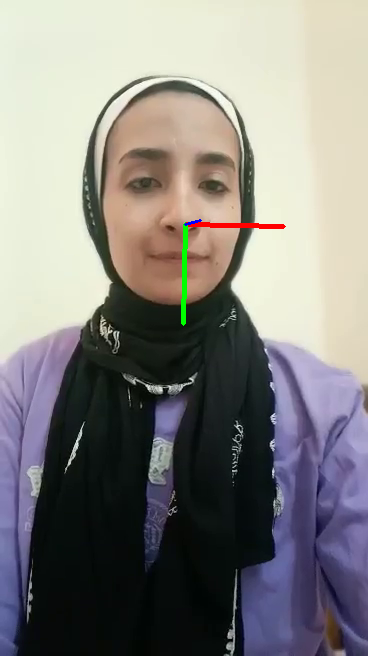

read a new frame: True
0    185
Name: 2, dtype: int64
0    226
Name: 3, dtype: int64
0    185
Name: 2, dtype: int64


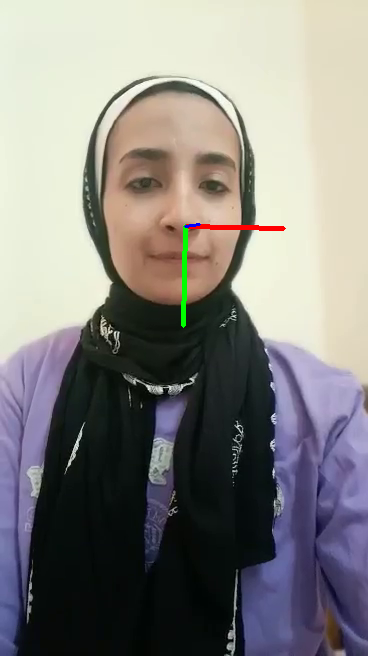

read a new frame: True
0    185
Name: 2, dtype: int64
0    225
Name: 3, dtype: int64
0    185
Name: 2, dtype: int64


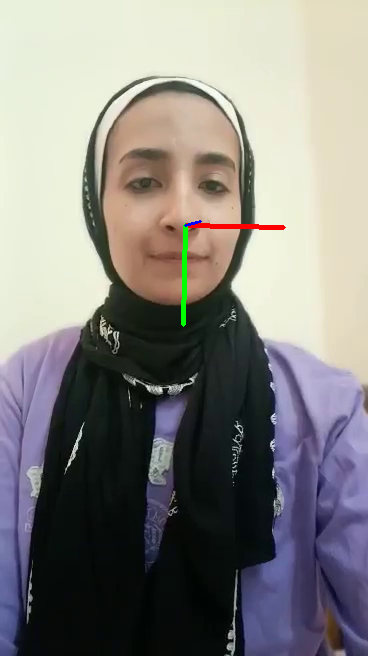

read a new frame: True
0    185
Name: 2, dtype: int64
0    225
Name: 3, dtype: int64
0    185
Name: 2, dtype: int64


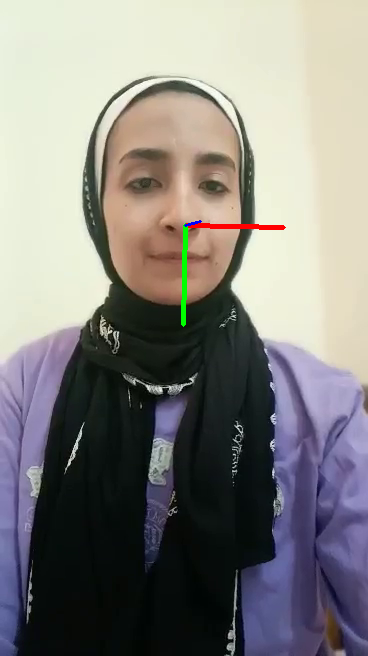

read a new frame: True
0    186
Name: 2, dtype: int64
0    226
Name: 3, dtype: int64
0    186
Name: 2, dtype: int64


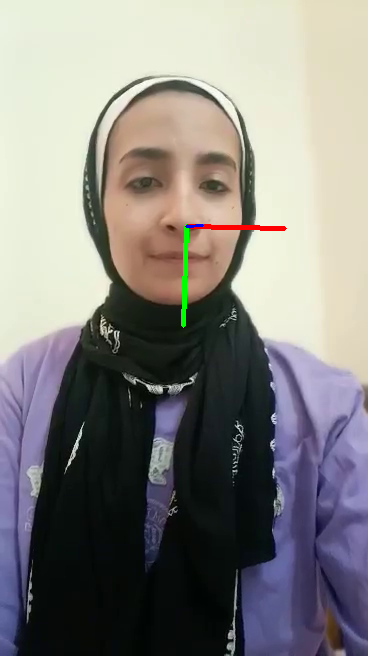

read a new frame: True
0    186
Name: 2, dtype: int64
0    225
Name: 3, dtype: int64
0    186
Name: 2, dtype: int64


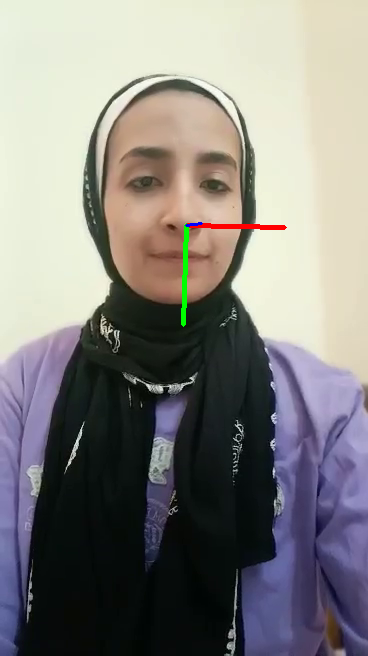

read a new frame: True
0    187
Name: 2, dtype: int64
0    225
Name: 3, dtype: int64
0    187
Name: 2, dtype: int64


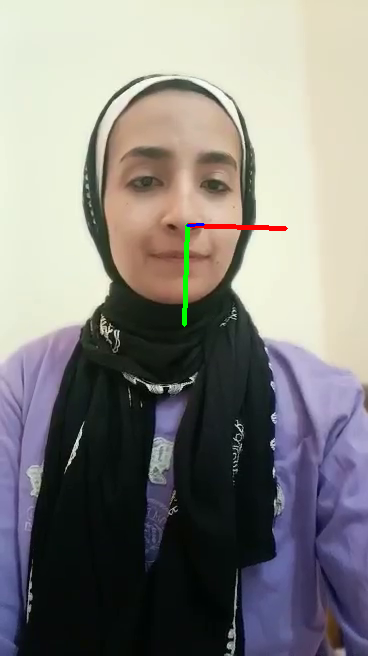

read a new frame: True
0    188
Name: 2, dtype: int64
0    225
Name: 3, dtype: int64
0    188
Name: 2, dtype: int64


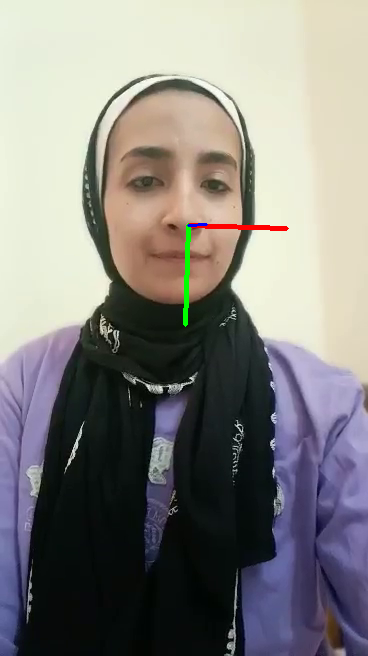

read a new frame: True
0    189
Name: 2, dtype: int64
0    225
Name: 3, dtype: int64
0    189
Name: 2, dtype: int64


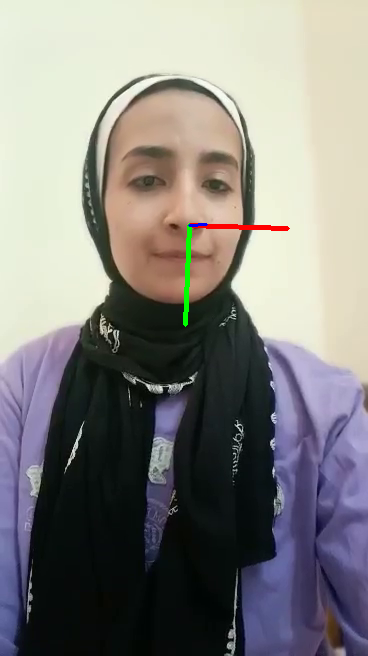

read a new frame: True
0    192
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    192
Name: 2, dtype: int64


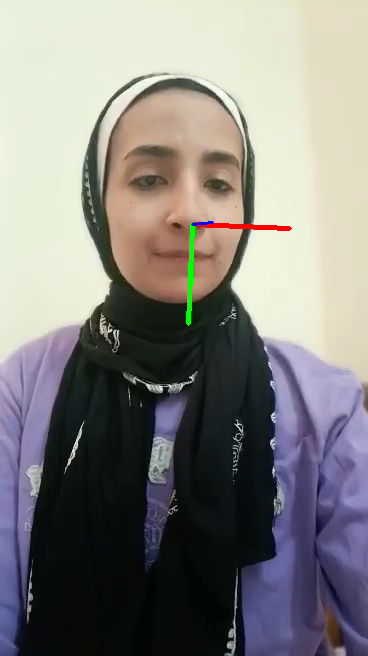

read a new frame: True
0    196
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    196
Name: 2, dtype: int64


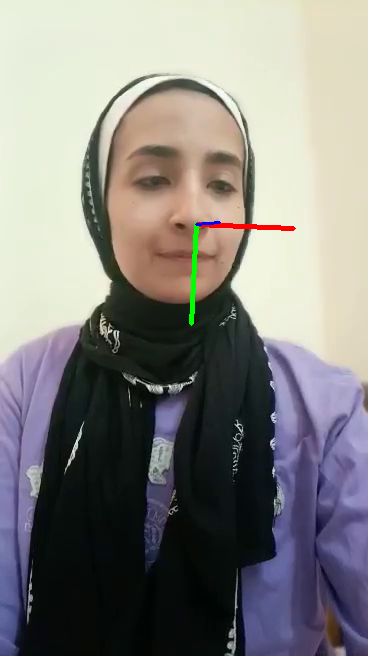

read a new frame: True
0    202
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    202
Name: 2, dtype: int64


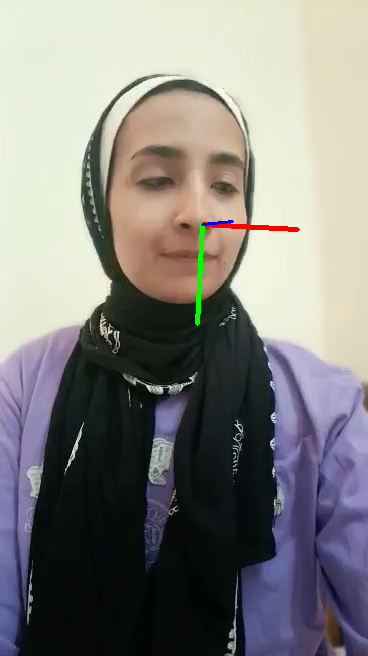

read a new frame: True
0    208
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    208
Name: 2, dtype: int64


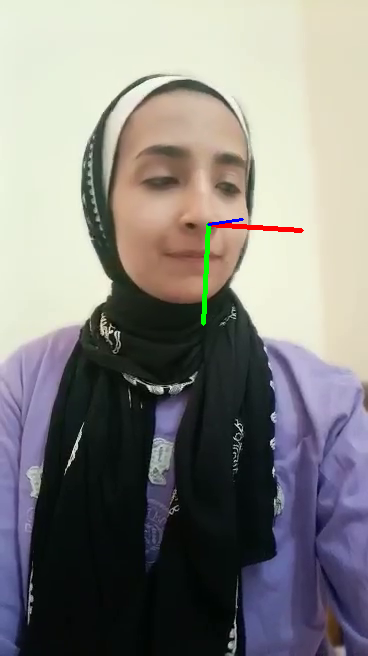

read a new frame: True
0    215
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    215
Name: 2, dtype: int64


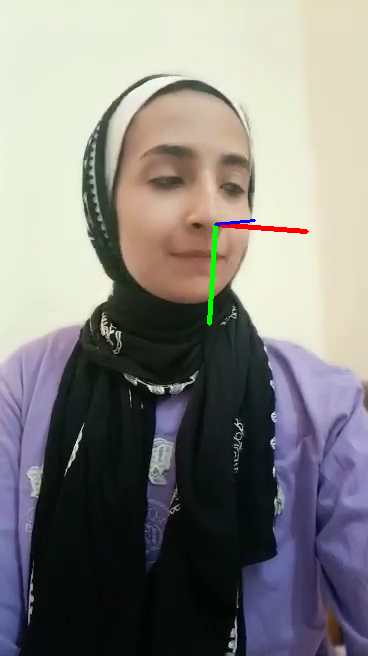

read a new frame: True
0    222
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    222
Name: 2, dtype: int64


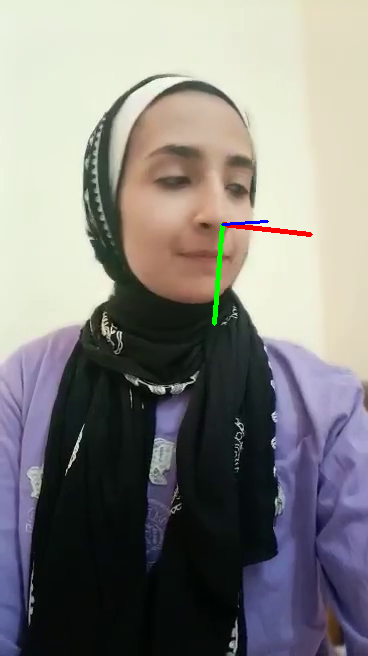

read a new frame: True
0    230
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    230
Name: 2, dtype: int64


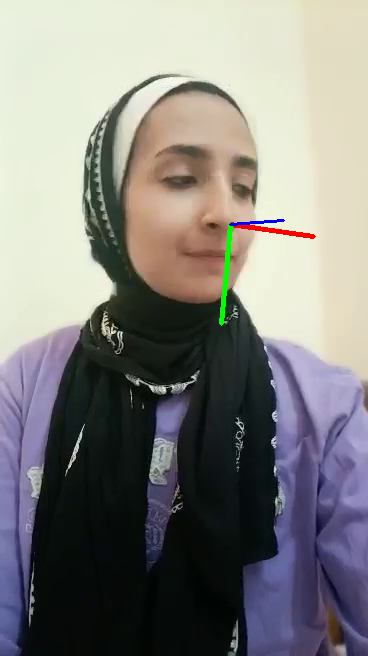

read a new frame: True
0    238
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    238
Name: 2, dtype: int64


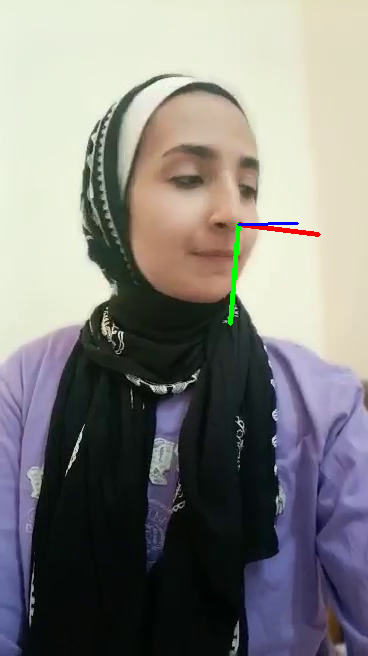

read a new frame: True
0    248
Name: 2, dtype: int64
0    225
Name: 3, dtype: int64
0    248
Name: 2, dtype: int64


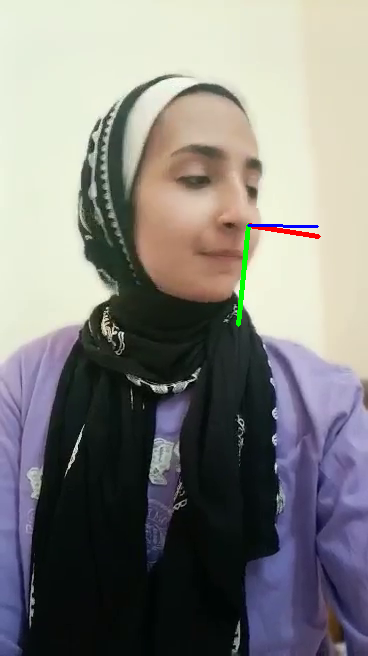

read a new frame: True
0    256
Name: 2, dtype: int64
0    222
Name: 3, dtype: int64
0    256
Name: 2, dtype: int64


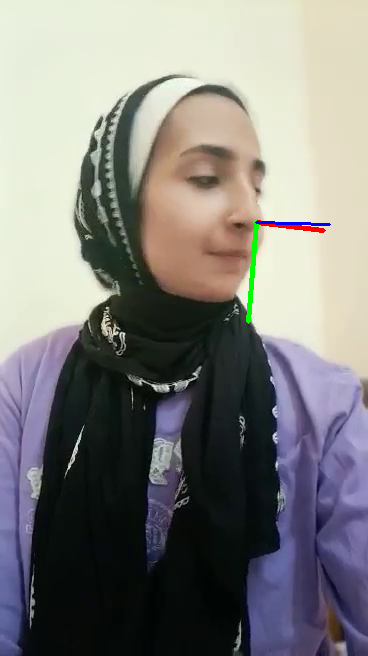

read a new frame: True
0    265
Name: 2, dtype: int64
0    221
Name: 3, dtype: int64
0    265
Name: 2, dtype: int64


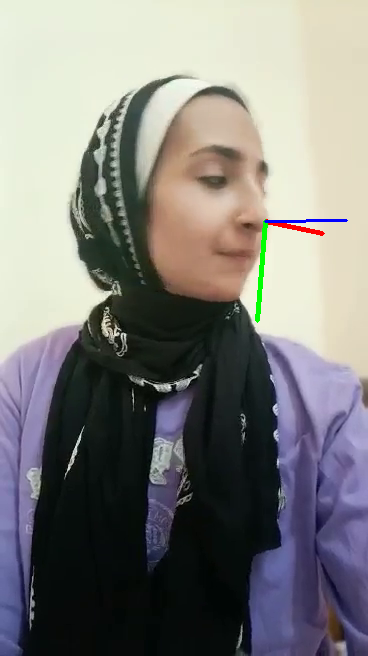

read a new frame: True
0    270
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    270
Name: 2, dtype: int64


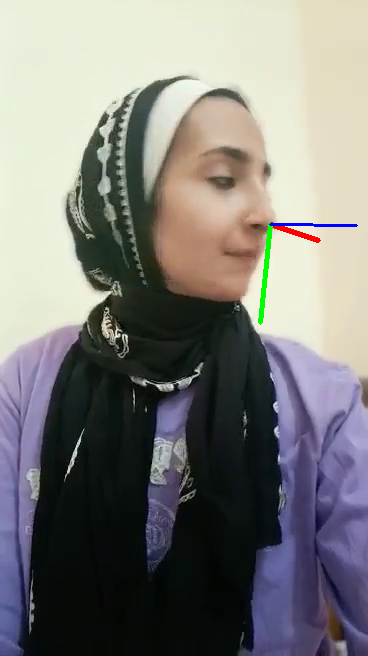

read a new frame: True
0    276
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    276
Name: 2, dtype: int64


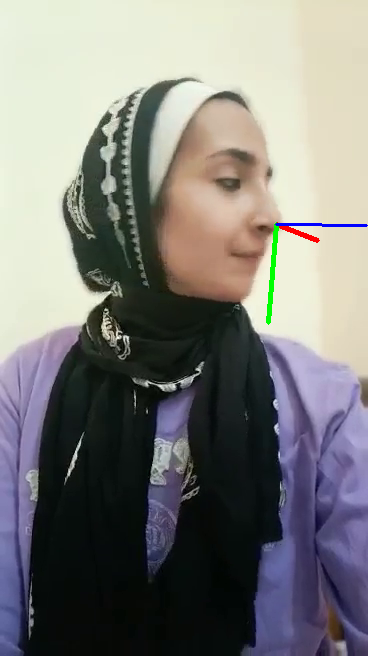

read a new frame: True
0    281
Name: 2, dtype: int64
0    230
Name: 3, dtype: int64
0    281
Name: 2, dtype: int64


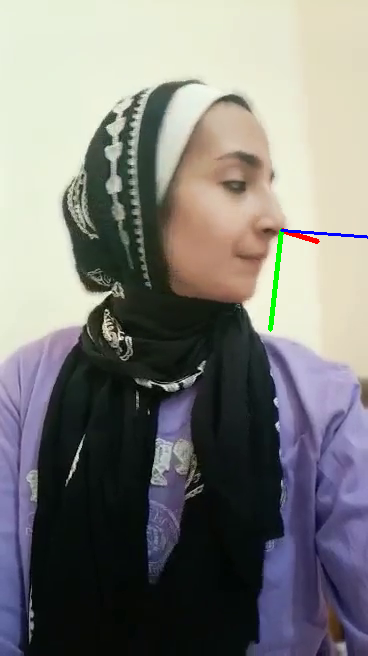

read a new frame: True
0    284
Name: 2, dtype: int64
0    231
Name: 3, dtype: int64
0    284
Name: 2, dtype: int64


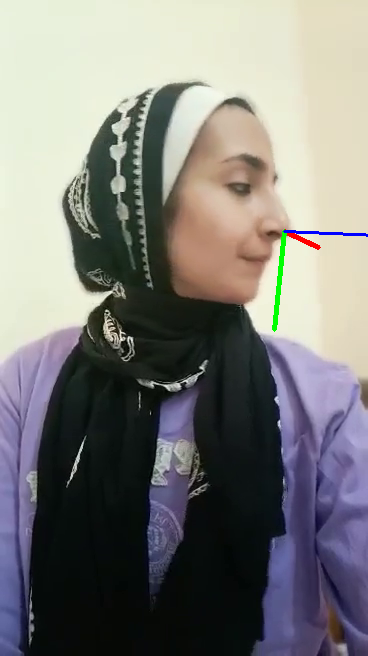

read a new frame: True
0    285
Name: 2, dtype: int64
0    234
Name: 3, dtype: int64
0    285
Name: 2, dtype: int64


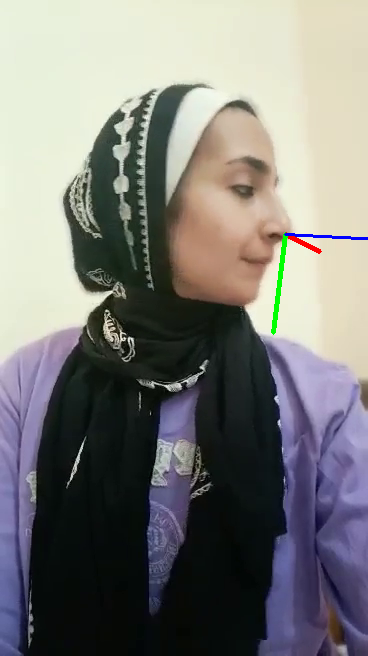

read a new frame: True
0    289
Name: 2, dtype: int64
0    238
Name: 3, dtype: int64
0    289
Name: 2, dtype: int64


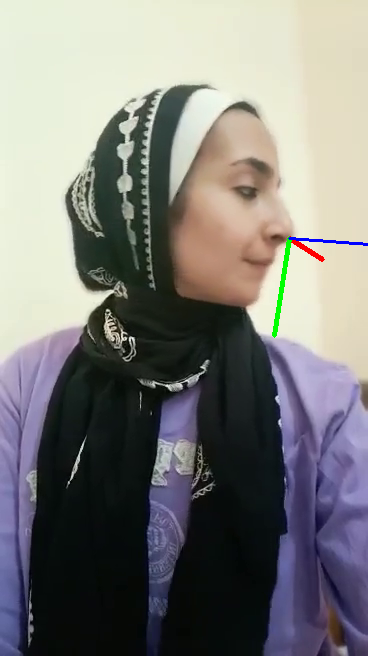

read a new frame: True
0    288
Name: 2, dtype: int64
0    238
Name: 3, dtype: int64
0    288
Name: 2, dtype: int64


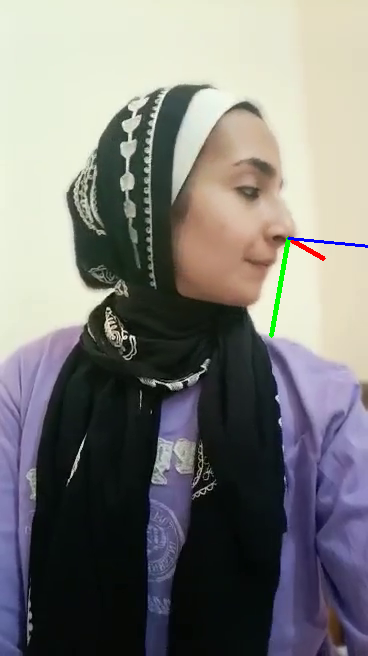

read a new frame: True
0    291
Name: 2, dtype: int64
0    237
Name: 3, dtype: int64
0    291
Name: 2, dtype: int64


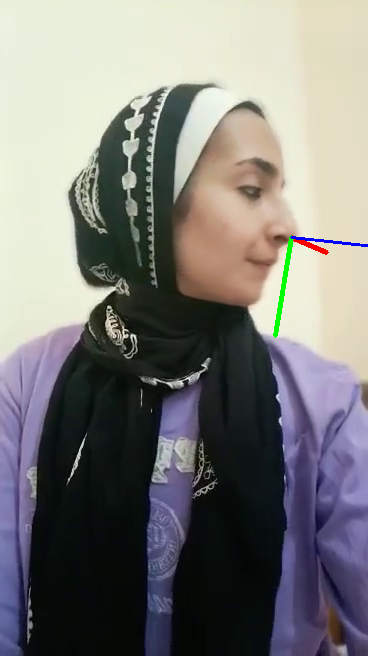

read a new frame: True
0    292
Name: 2, dtype: int64
0    237
Name: 3, dtype: int64
0    292
Name: 2, dtype: int64


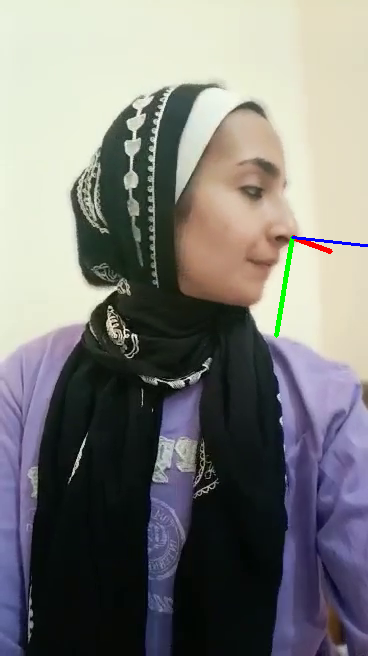

read a new frame: True
0    293
Name: 2, dtype: int64
0    236
Name: 3, dtype: int64
0    293
Name: 2, dtype: int64


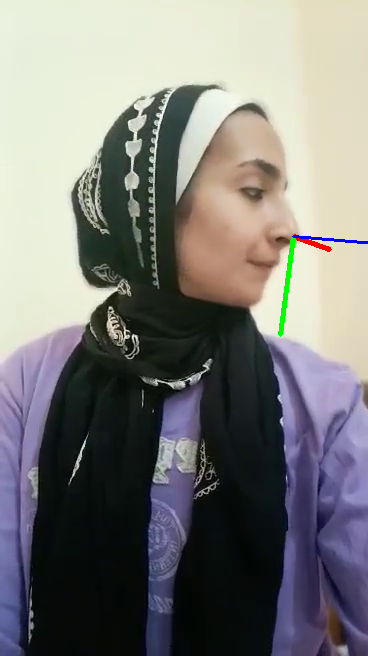

read a new frame: True
0    292
Name: 2, dtype: int64
0    238
Name: 3, dtype: int64
0    292
Name: 2, dtype: int64


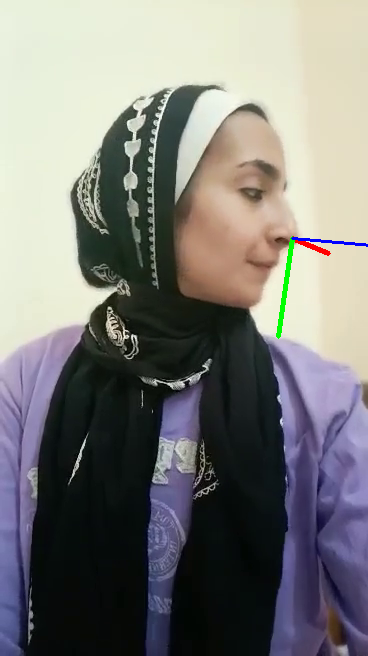

read a new frame: True
0    293
Name: 2, dtype: int64
0    237
Name: 3, dtype: int64
0    293
Name: 2, dtype: int64


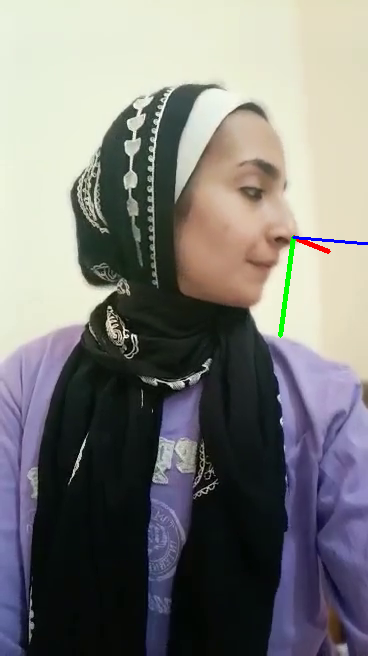

read a new frame: True
0    293
Name: 2, dtype: int64
0    237
Name: 3, dtype: int64
0    293
Name: 2, dtype: int64


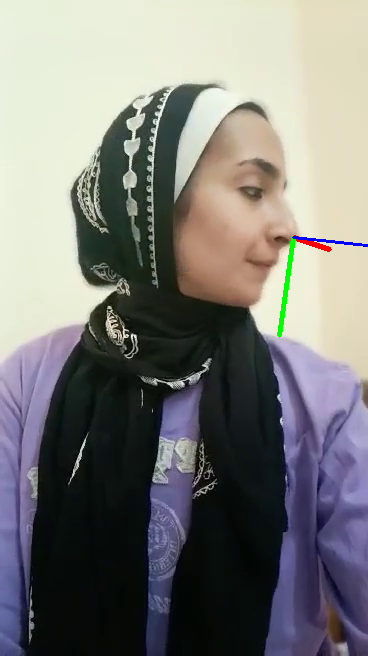

read a new frame: True
0    291
Name: 2, dtype: int64
0    238
Name: 3, dtype: int64
0    291
Name: 2, dtype: int64


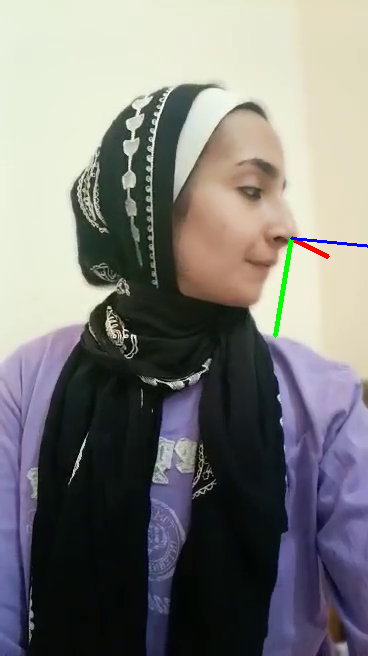

read a new frame: True
0    290
Name: 2, dtype: int64
0    239
Name: 3, dtype: int64
0    290
Name: 2, dtype: int64


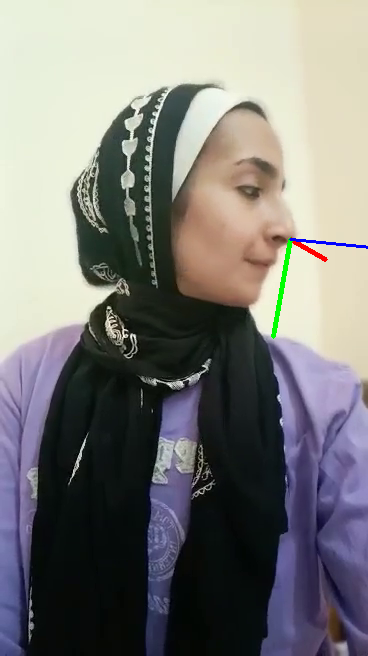

read a new frame: True
0    289
Name: 2, dtype: int64
0    237
Name: 3, dtype: int64
0    289
Name: 2, dtype: int64


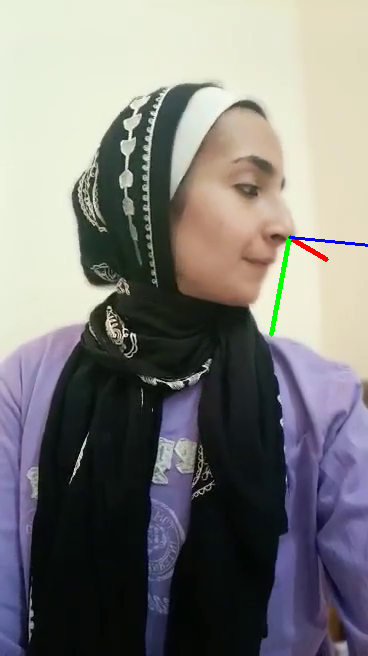

read a new frame: True
0    286
Name: 2, dtype: int64
0    233
Name: 3, dtype: int64
0    286
Name: 2, dtype: int64


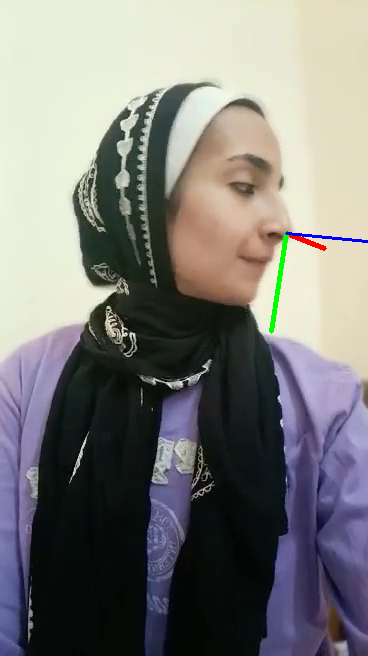

read a new frame: True
0    282
Name: 2, dtype: int64
0    229
Name: 3, dtype: int64
0    282
Name: 2, dtype: int64


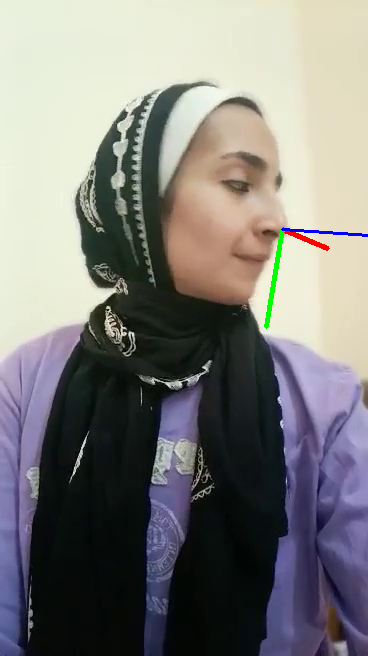

read a new frame: True
0    277
Name: 2, dtype: int64
0    228
Name: 3, dtype: int64
0    277
Name: 2, dtype: int64


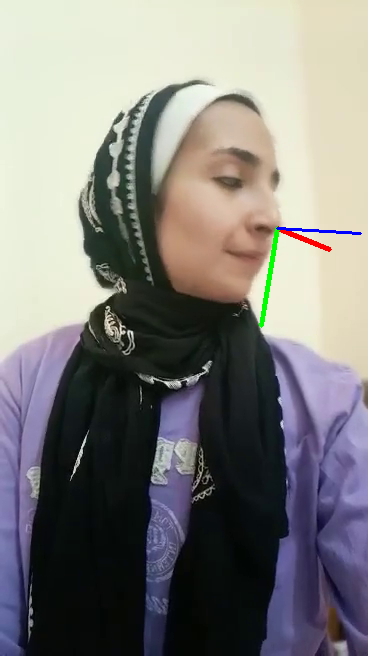

read a new frame: True
0    270
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    270
Name: 2, dtype: int64


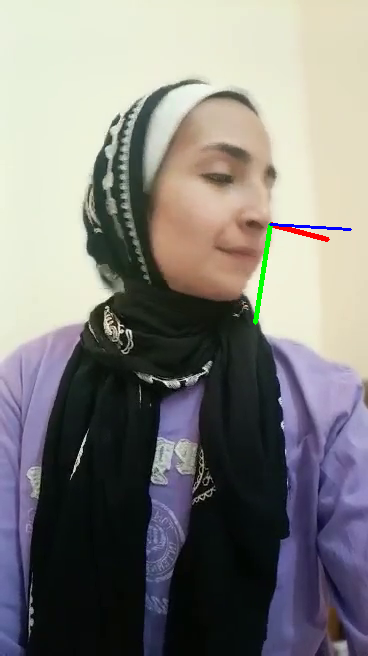

read a new frame: True
0    259
Name: 2, dtype: int64
0    220
Name: 3, dtype: int64
0    259
Name: 2, dtype: int64


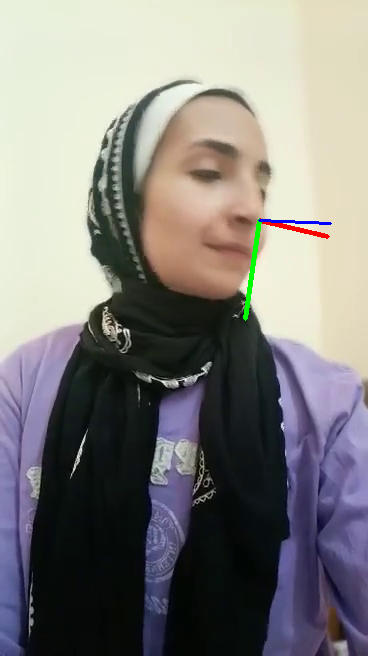

read a new frame: True
0    243
Name: 2, dtype: int64
0    214
Name: 3, dtype: int64
0    243
Name: 2, dtype: int64


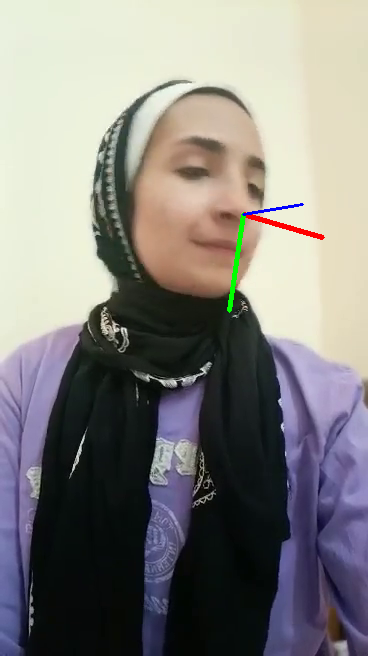

read a new frame: True
0    225
Name: 2, dtype: int64
0    211
Name: 3, dtype: int64
0    225
Name: 2, dtype: int64


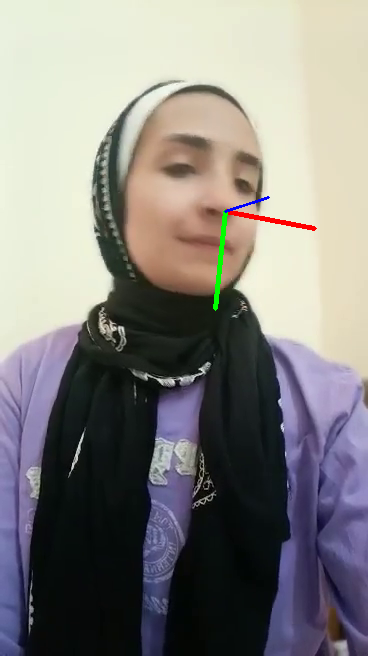

read a new frame: True
0    208
Name: 2, dtype: int64
0    208
Name: 3, dtype: int64
0    208
Name: 2, dtype: int64


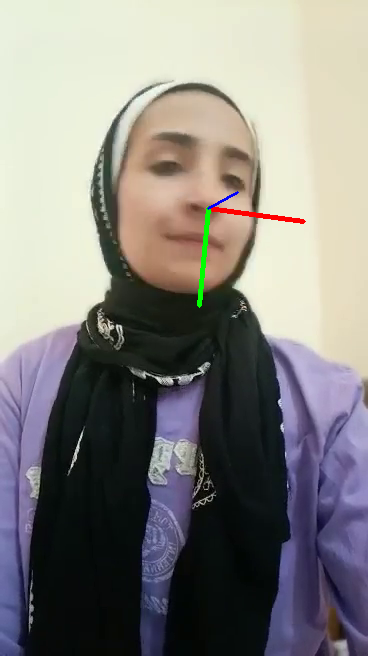

read a new frame: True
0    192
Name: 2, dtype: int64
0    203
Name: 3, dtype: int64
0    192
Name: 2, dtype: int64


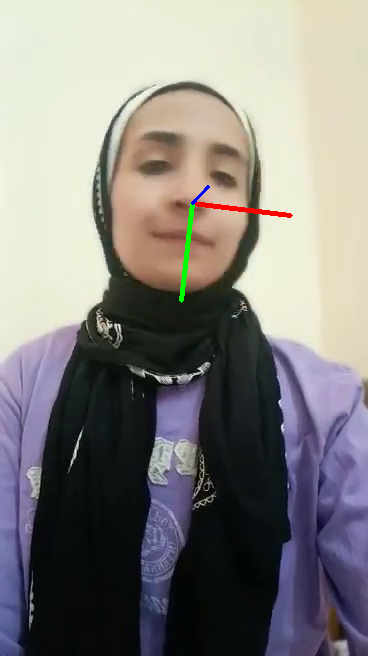

read a new frame: True
0    176
Name: 2, dtype: int64
0    201
Name: 3, dtype: int64
0    176
Name: 2, dtype: int64


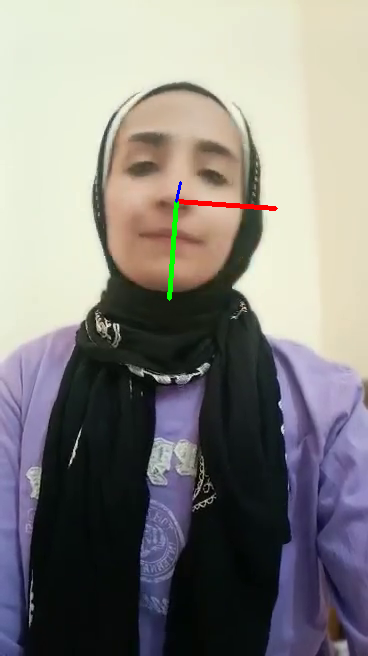

read a new frame: True
0    157
Name: 2, dtype: int64
0    200
Name: 3, dtype: int64
0    157
Name: 2, dtype: int64


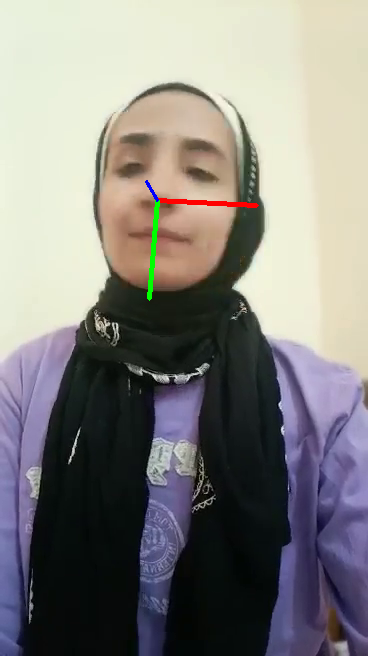

read a new frame: True
0    141
Name: 2, dtype: int64
0    198
Name: 3, dtype: int64
0    141
Name: 2, dtype: int64


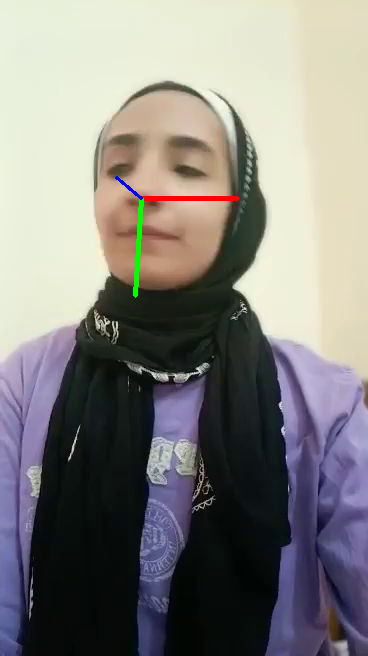

read a new frame: True
0    122
Name: 2, dtype: int64
0    197
Name: 3, dtype: int64
0    122
Name: 2, dtype: int64


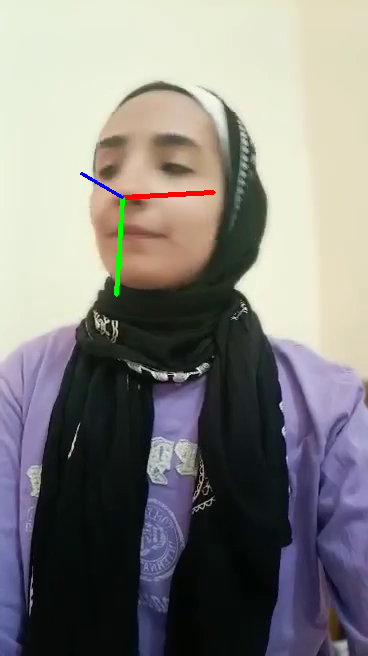

read a new frame: True
0    106
Name: 2, dtype: int64
0    198
Name: 3, dtype: int64
0    106
Name: 2, dtype: int64


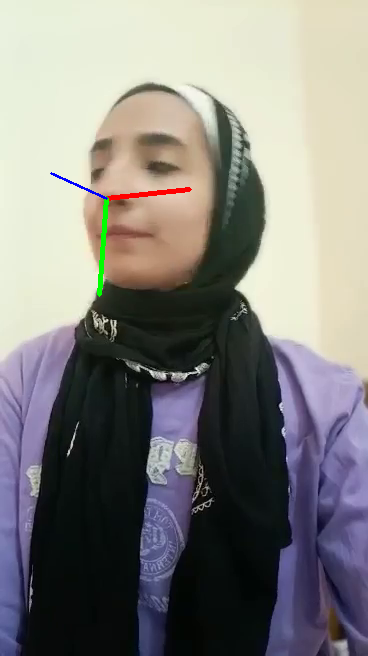

read a new frame: True
0    91
Name: 2, dtype: int64
0    200
Name: 3, dtype: int64
0    91
Name: 2, dtype: int64


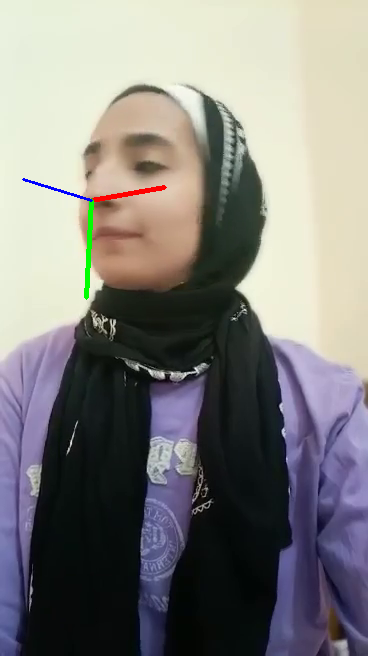

read a new frame: True
0    84
Name: 2, dtype: int64
0    203
Name: 3, dtype: int64
0    84
Name: 2, dtype: int64


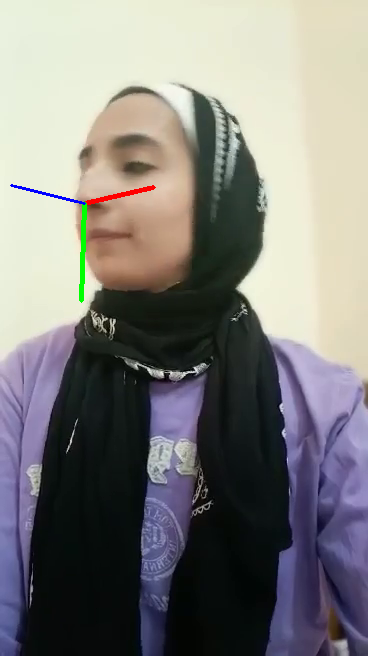

read a new frame: True
0    73
Name: 2, dtype: int64
0    208
Name: 3, dtype: int64
0    73
Name: 2, dtype: int64


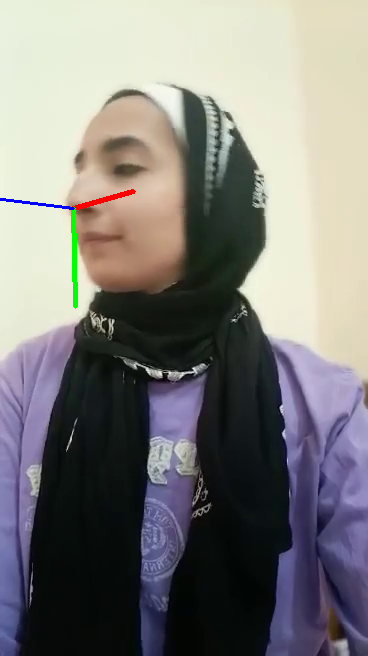

read a new frame: True
0    65
Name: 2, dtype: int64
0    211
Name: 3, dtype: int64
0    65
Name: 2, dtype: int64


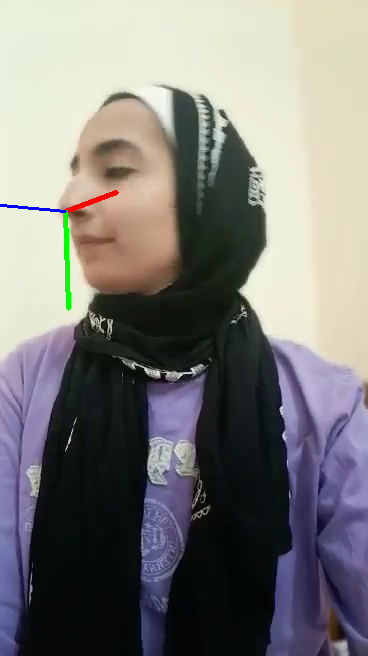

read a new frame: True
0    61
Name: 2, dtype: int64
0    215
Name: 3, dtype: int64
0    61
Name: 2, dtype: int64


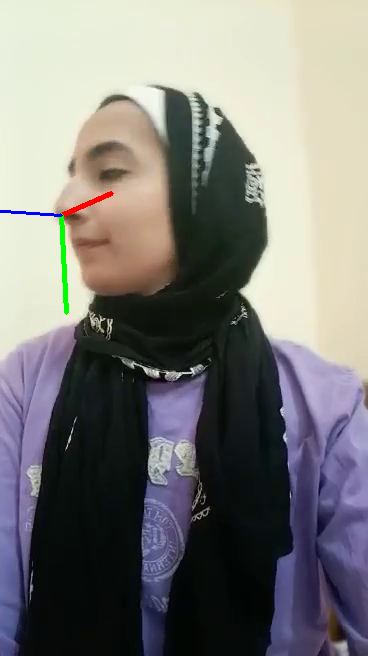

read a new frame: True
0    54
Name: 2, dtype: int64
0    217
Name: 3, dtype: int64
0    54
Name: 2, dtype: int64


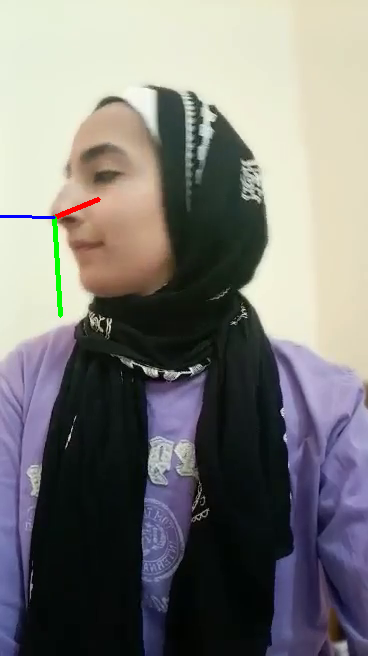

read a new frame: True
0    52
Name: 2, dtype: int64
0    220
Name: 3, dtype: int64
0    52
Name: 2, dtype: int64


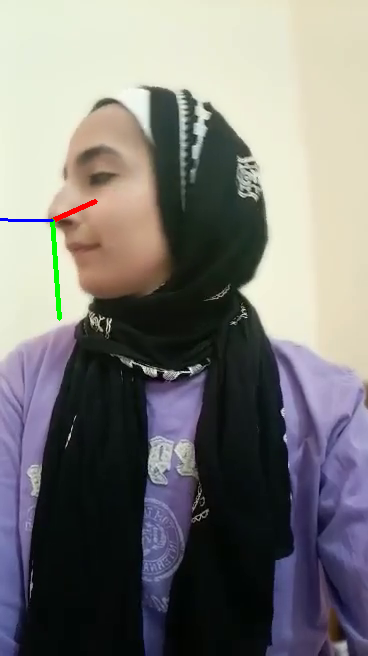

read a new frame: True
0    54
Name: 2, dtype: int64
0    222
Name: 3, dtype: int64
0    54
Name: 2, dtype: int64


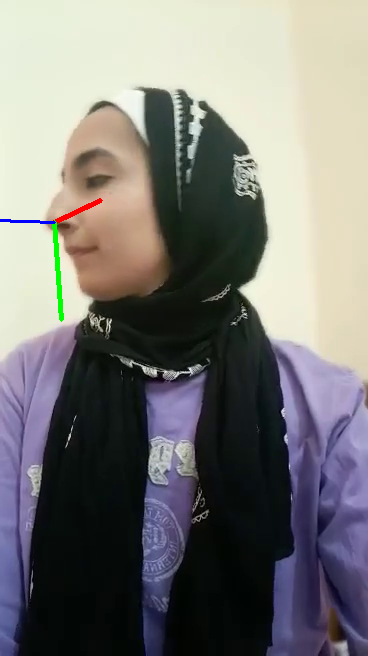

read a new frame: True
0    48
Name: 2, dtype: int64
0    225
Name: 3, dtype: int64
0    48
Name: 2, dtype: int64


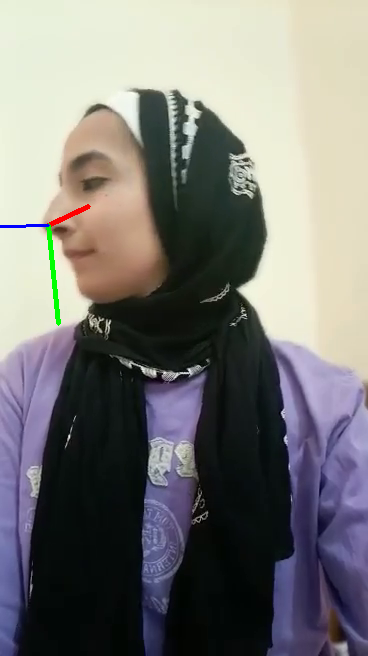

read a new frame: True
0    47
Name: 2, dtype: int64
0    229
Name: 3, dtype: int64
0    47
Name: 2, dtype: int64


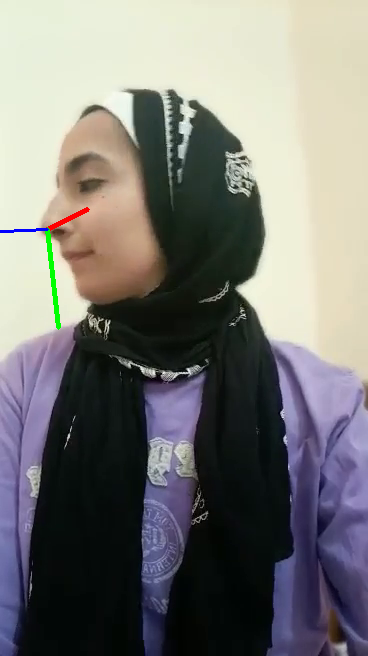

read a new frame: True
0    47
Name: 2, dtype: int64
0    229
Name: 3, dtype: int64
0    47
Name: 2, dtype: int64


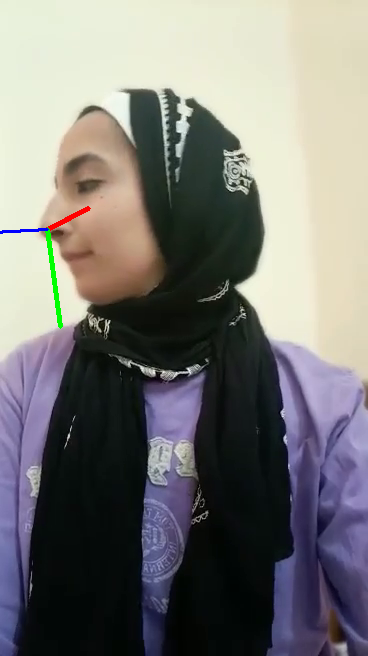

read a new frame: True
0    46
Name: 2, dtype: int64
0    232
Name: 3, dtype: int64
0    46
Name: 2, dtype: int64


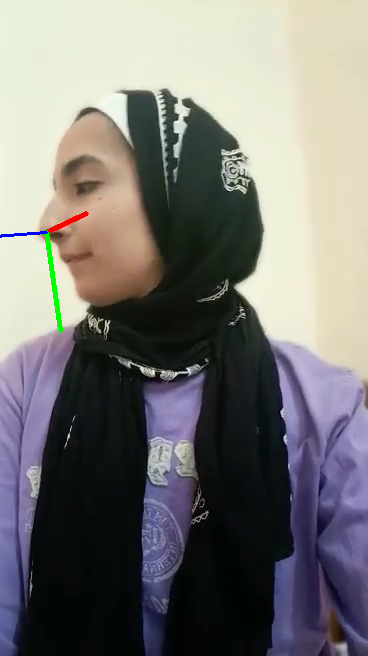

read a new frame: True
0    41
Name: 2, dtype: int64
0    233
Name: 3, dtype: int64
0    41
Name: 2, dtype: int64


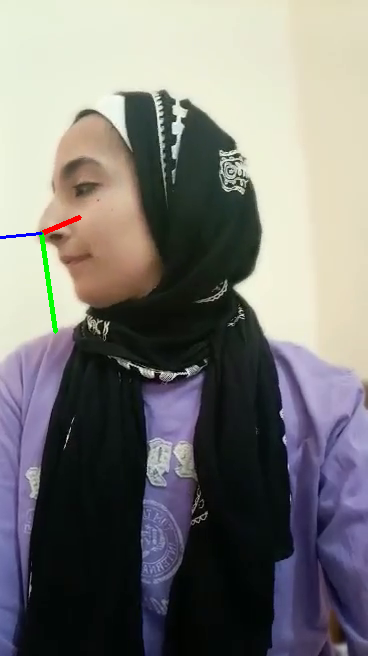

read a new frame: True
0    41
Name: 2, dtype: int64
0    233
Name: 3, dtype: int64
0    41
Name: 2, dtype: int64


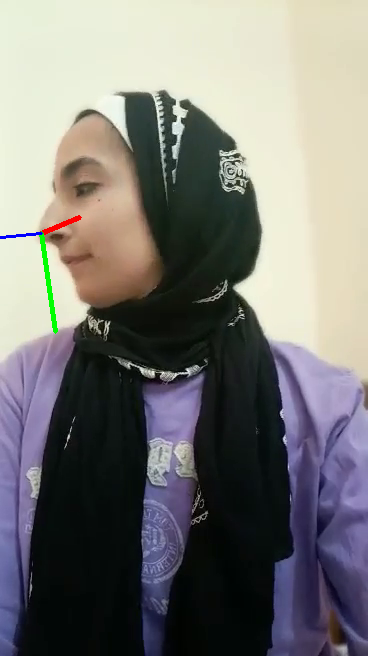

read a new frame: True
0    42
Name: 2, dtype: int64
0    231
Name: 3, dtype: int64
0    42
Name: 2, dtype: int64


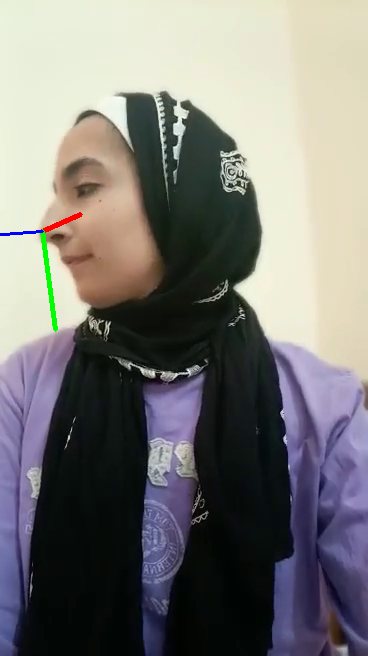

read a new frame: True
0    44
Name: 2, dtype: int64
0    233
Name: 3, dtype: int64
0    44
Name: 2, dtype: int64


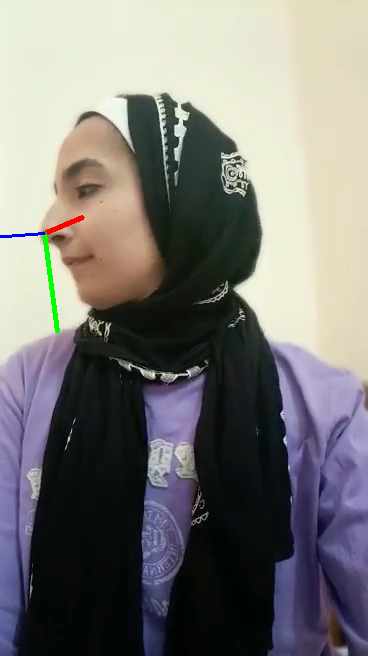

read a new frame: True
0    47
Name: 2, dtype: int64
0    235
Name: 3, dtype: int64
0    47
Name: 2, dtype: int64


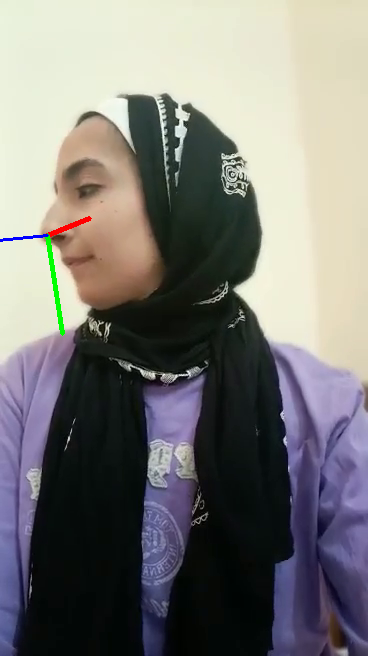

read a new frame: True
0    47
Name: 2, dtype: int64
0    234
Name: 3, dtype: int64
0    47
Name: 2, dtype: int64


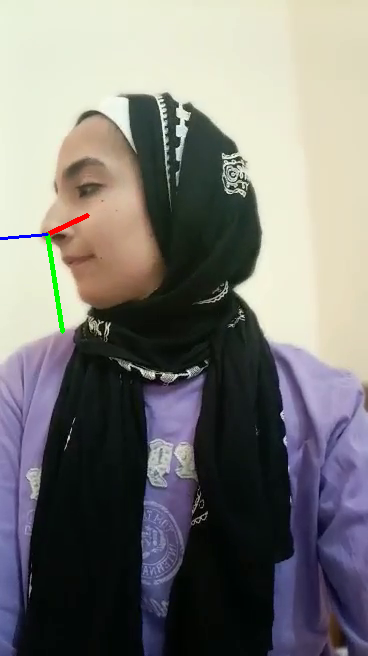

read a new frame: True
0    48
Name: 2, dtype: int64
0    233
Name: 3, dtype: int64
0    48
Name: 2, dtype: int64


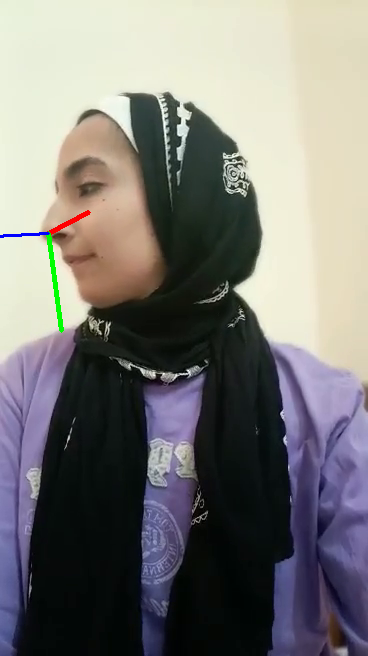

read a new frame: True
0    48
Name: 2, dtype: int64
0    234
Name: 3, dtype: int64
0    48
Name: 2, dtype: int64


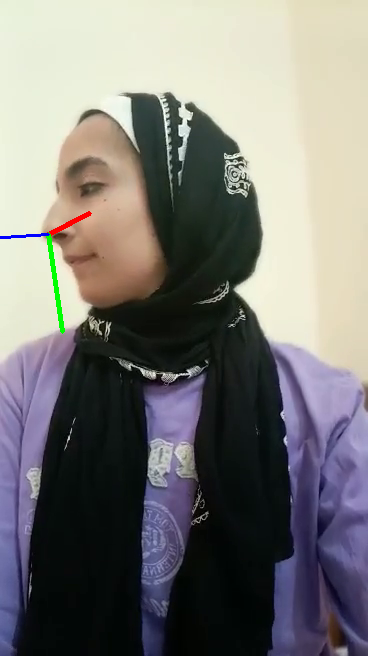

read a new frame: True
0    50
Name: 2, dtype: int64
0    233
Name: 3, dtype: int64
0    50
Name: 2, dtype: int64


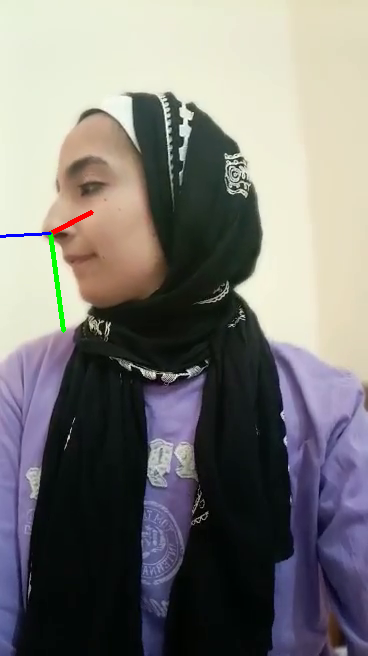

read a new frame: True
0    46
Name: 2, dtype: int64
0    231
Name: 3, dtype: int64
0    46
Name: 2, dtype: int64


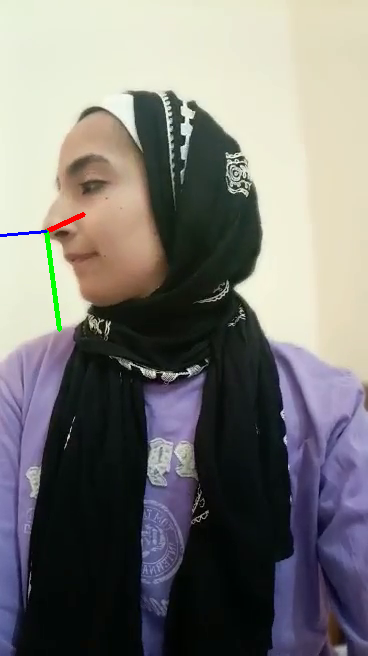

read a new frame: True
0    49
Name: 2, dtype: int64
0    230
Name: 3, dtype: int64
0    49
Name: 2, dtype: int64


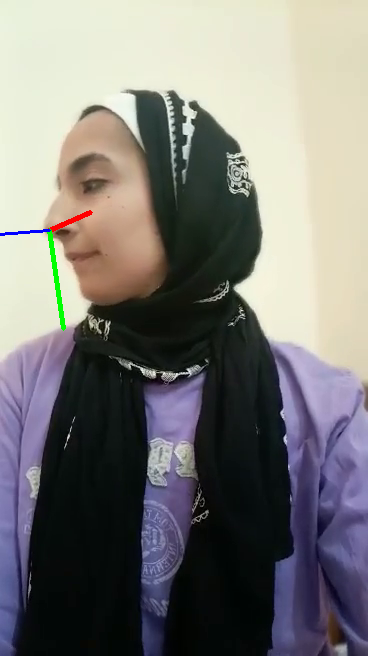

read a new frame: True
0    51
Name: 2, dtype: int64
0    229
Name: 3, dtype: int64
0    51
Name: 2, dtype: int64


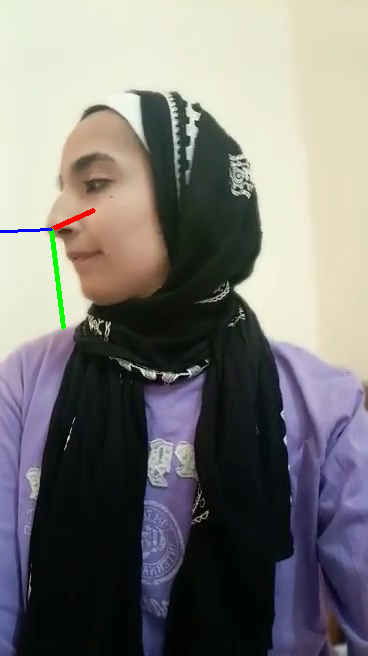

read a new frame: True
0    54
Name: 2, dtype: int64
0    228
Name: 3, dtype: int64
0    54
Name: 2, dtype: int64


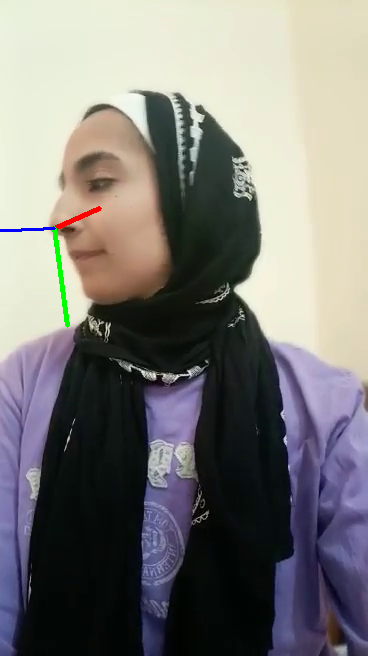

read a new frame: True
0    59
Name: 2, dtype: int64
0    227
Name: 3, dtype: int64
0    59
Name: 2, dtype: int64


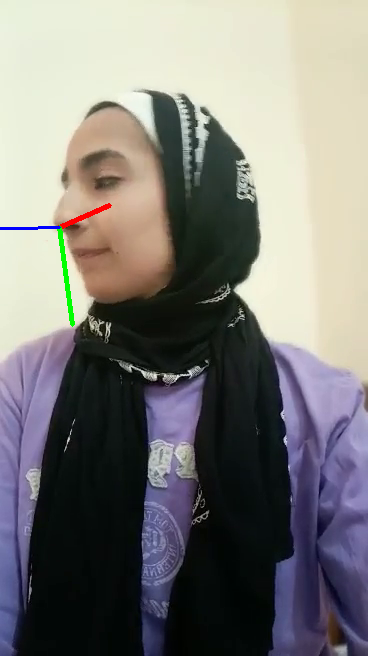

read a new frame: True
0    65
Name: 2, dtype: int64
0    223
Name: 3, dtype: int64
0    65
Name: 2, dtype: int64


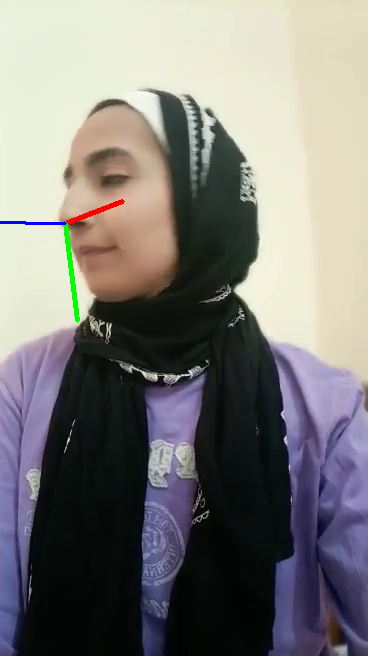

read a new frame: True
0    73
Name: 2, dtype: int64
0    220
Name: 3, dtype: int64
0    73
Name: 2, dtype: int64


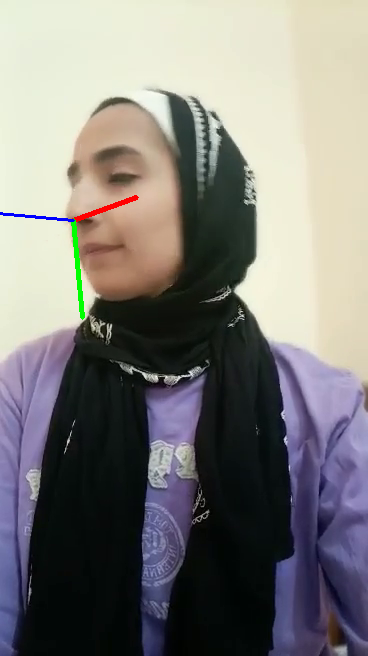

read a new frame: True
0    82
Name: 2, dtype: int64
0    216
Name: 3, dtype: int64
0    82
Name: 2, dtype: int64


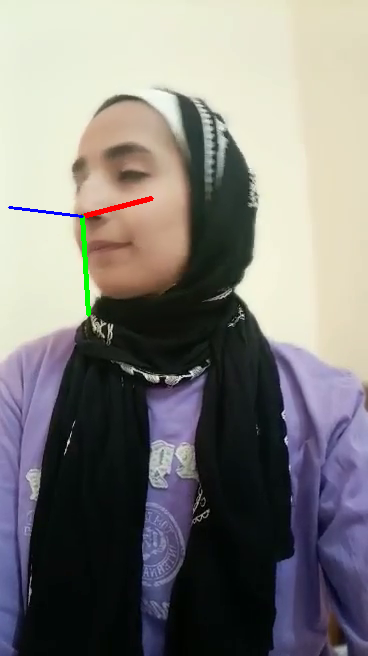

read a new frame: True
0    93
Name: 2, dtype: int64
0    212
Name: 3, dtype: int64
0    93
Name: 2, dtype: int64


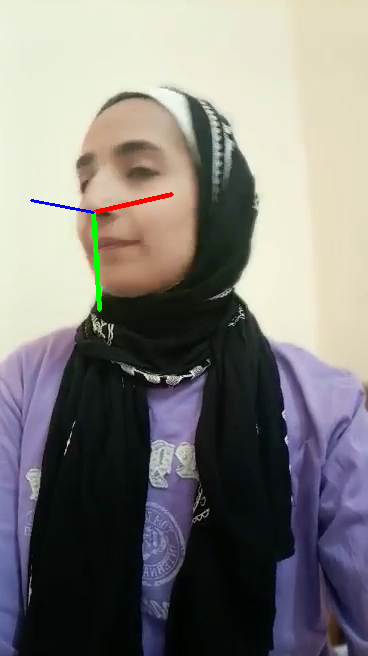

read a new frame: True
0    101
Name: 2, dtype: int64
0    209
Name: 3, dtype: int64
0    101
Name: 2, dtype: int64


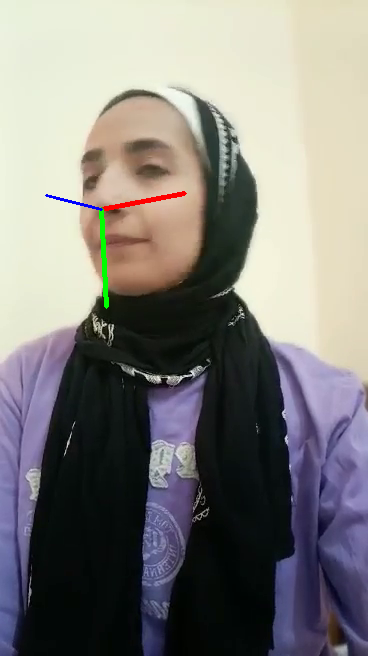

read a new frame: True
0    114
Name: 2, dtype: int64
0    205
Name: 3, dtype: int64
0    114
Name: 2, dtype: int64


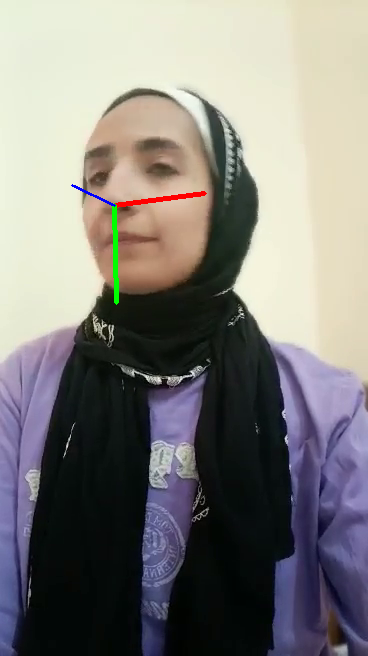

read a new frame: True
0    126
Name: 2, dtype: int64
0    201
Name: 3, dtype: int64
0    126
Name: 2, dtype: int64


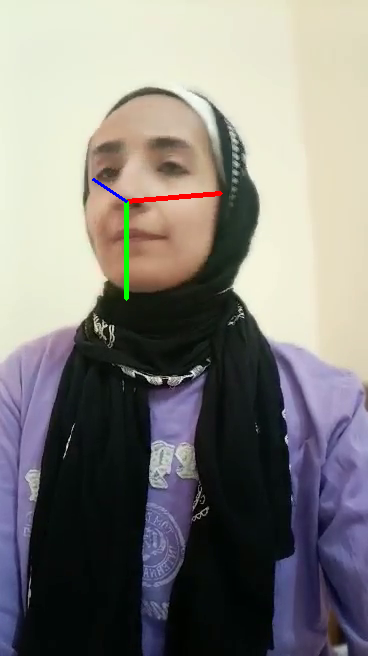

read a new frame: True
0    138
Name: 2, dtype: int64
0    197
Name: 3, dtype: int64
0    138
Name: 2, dtype: int64


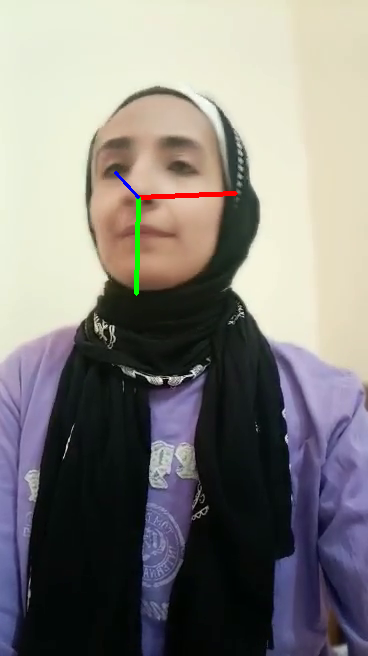

read a new frame: True
0    150
Name: 2, dtype: int64
0    192
Name: 3, dtype: int64
0    150
Name: 2, dtype: int64


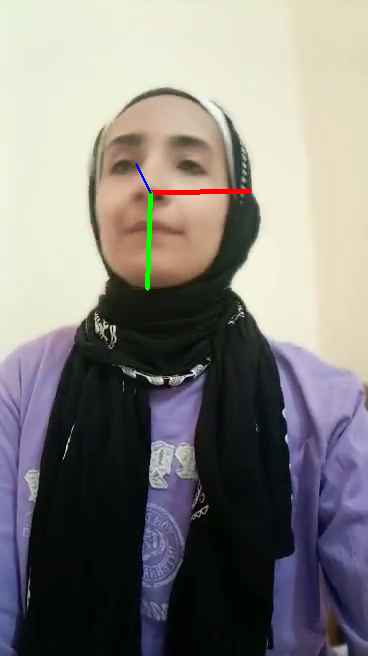

read a new frame: True
0    160
Name: 2, dtype: int64
0    186
Name: 3, dtype: int64
0    160
Name: 2, dtype: int64


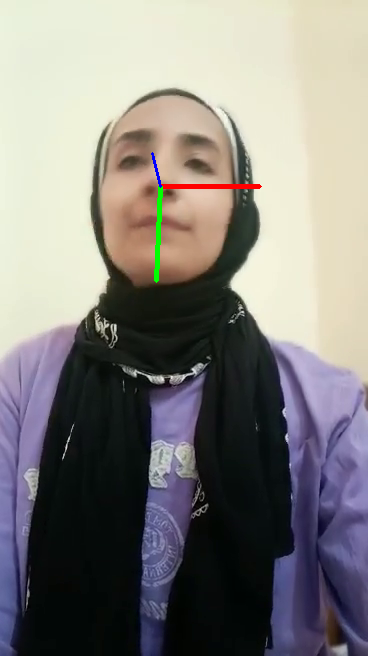

read a new frame: True
0    170
Name: 2, dtype: int64
0    177
Name: 3, dtype: int64
0    170
Name: 2, dtype: int64


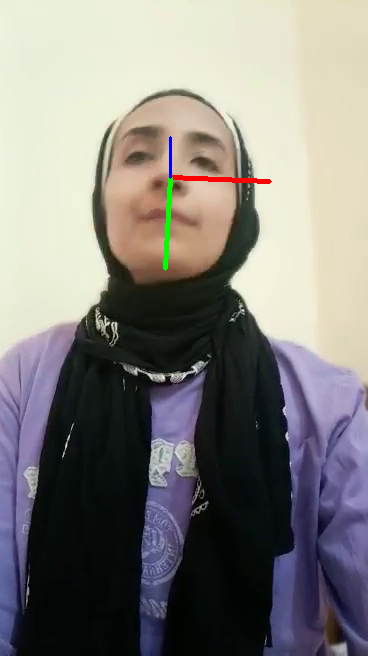

read a new frame: True
0    178
Name: 2, dtype: int64
0    169
Name: 3, dtype: int64
0    178
Name: 2, dtype: int64


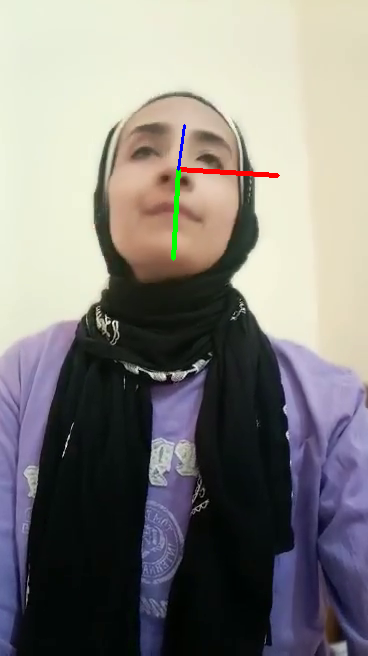

read a new frame: True
0    184
Name: 2, dtype: int64
0    166
Name: 3, dtype: int64
0    184
Name: 2, dtype: int64


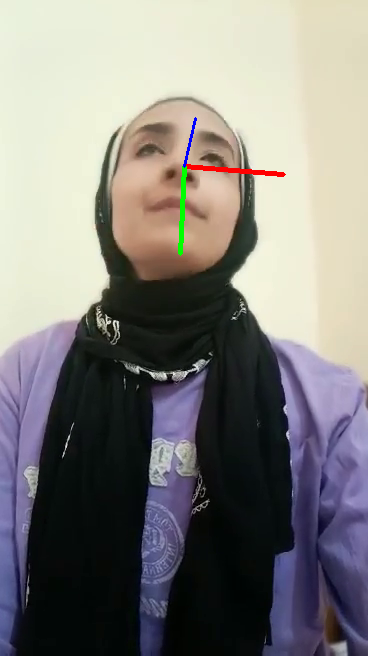

read a new frame: True
0    187
Name: 2, dtype: int64
0    162
Name: 3, dtype: int64
0    187
Name: 2, dtype: int64


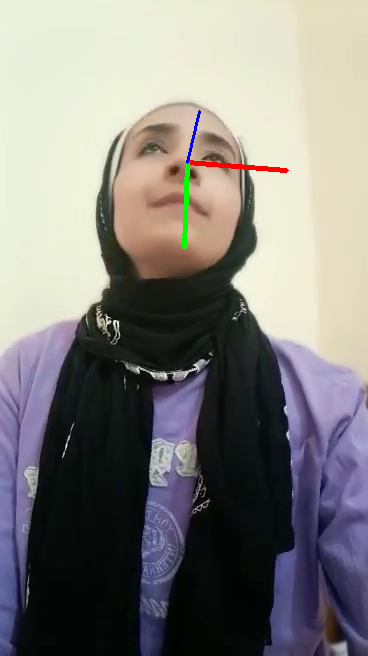

read a new frame: True
0    187
Name: 2, dtype: int64
0    161
Name: 3, dtype: int64
0    187
Name: 2, dtype: int64


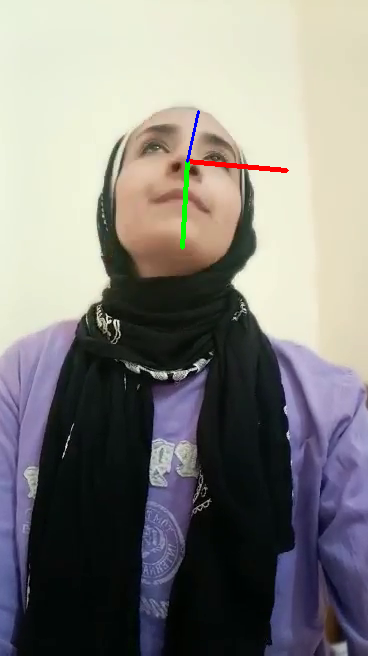

read a new frame: True
0    188
Name: 2, dtype: int64
0    158
Name: 3, dtype: int64
0    188
Name: 2, dtype: int64


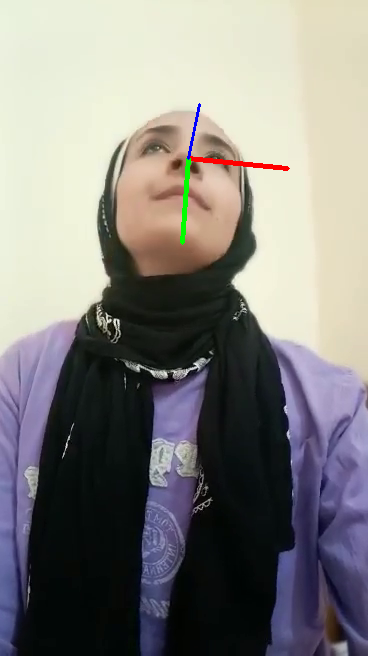

read a new frame: True
0    191
Name: 2, dtype: int64
0    158
Name: 3, dtype: int64
0    191
Name: 2, dtype: int64


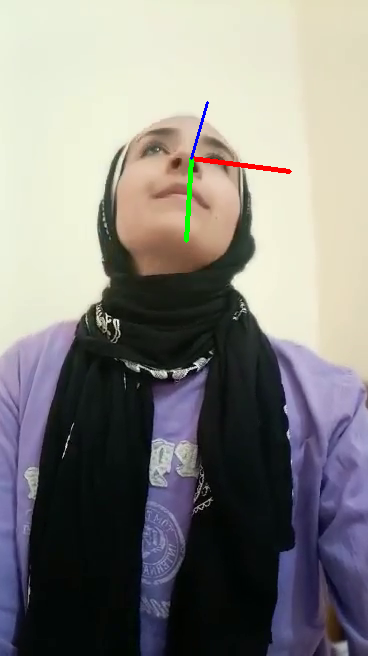

read a new frame: True
0    190
Name: 2, dtype: int64
0    158
Name: 3, dtype: int64
0    190
Name: 2, dtype: int64


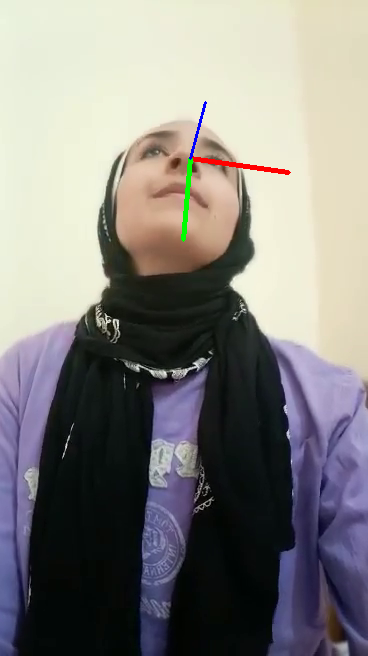

read a new frame: True
0    188
Name: 2, dtype: int64
0    159
Name: 3, dtype: int64
0    188
Name: 2, dtype: int64


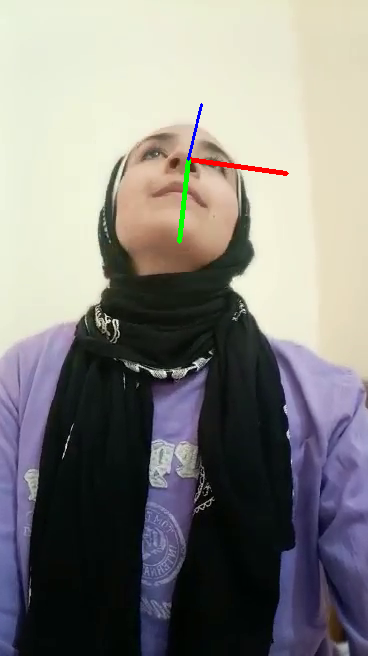

read a new frame: True
0    186
Name: 2, dtype: int64
0    163
Name: 3, dtype: int64
0    186
Name: 2, dtype: int64


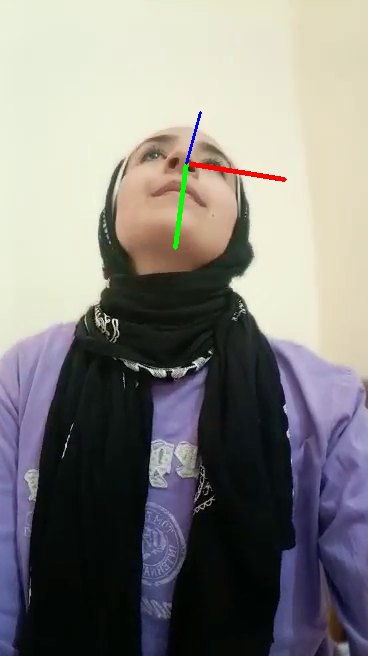

read a new frame: True
0    184
Name: 2, dtype: int64
0    162
Name: 3, dtype: int64
0    184
Name: 2, dtype: int64


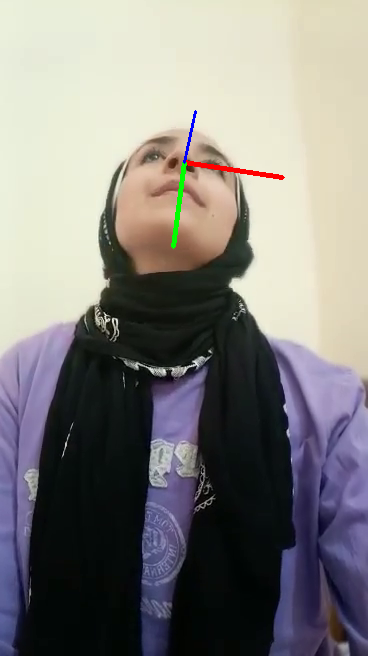

read a new frame: True
0    186
Name: 2, dtype: int64
0    164
Name: 3, dtype: int64
0    186
Name: 2, dtype: int64


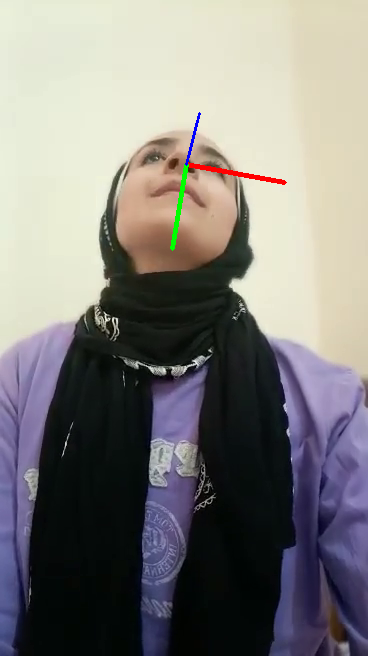

read a new frame: True
0    186
Name: 2, dtype: int64
0    166
Name: 3, dtype: int64
0    186
Name: 2, dtype: int64


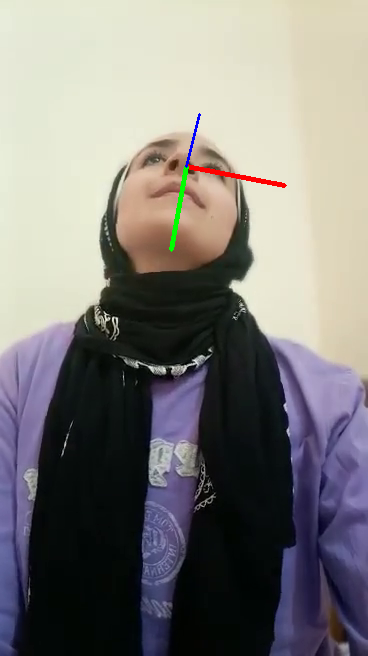

read a new frame: True
0    186
Name: 2, dtype: int64
0    167
Name: 3, dtype: int64
0    186
Name: 2, dtype: int64


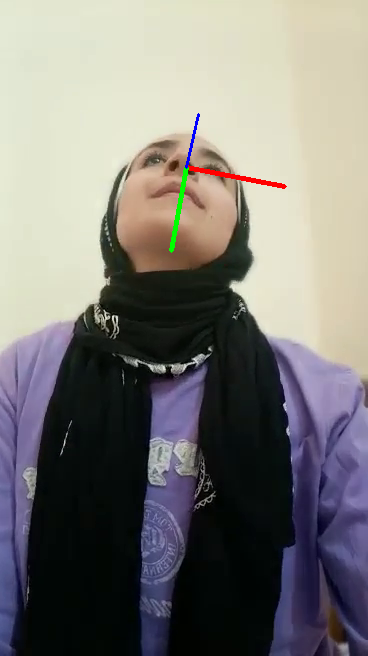

read a new frame: True
0    186
Name: 2, dtype: int64
0    172
Name: 3, dtype: int64
0    186
Name: 2, dtype: int64


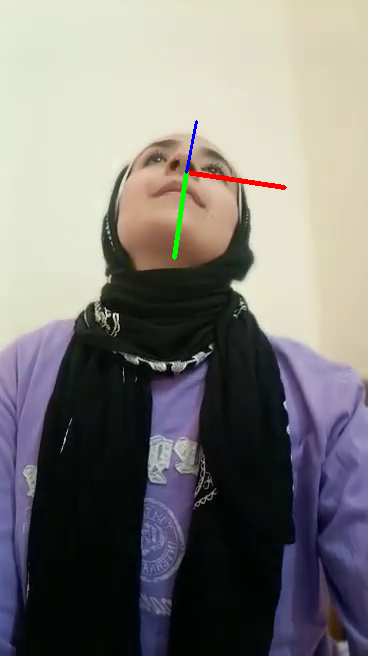

read a new frame: True
0    185
Name: 2, dtype: int64
0    183
Name: 3, dtype: int64
0    185
Name: 2, dtype: int64


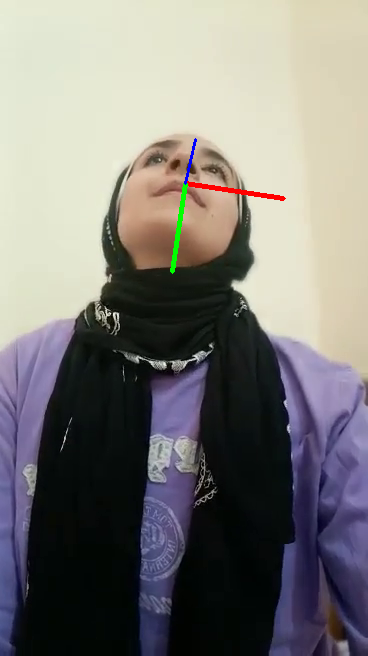

read a new frame: True
0    187
Name: 2, dtype: int64
0    173
Name: 3, dtype: int64
0    187
Name: 2, dtype: int64


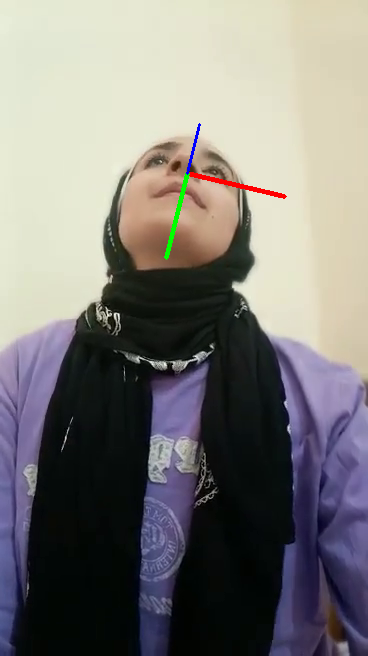

read a new frame: True
0    189
Name: 2, dtype: int64
0    167
Name: 3, dtype: int64
0    189
Name: 2, dtype: int64


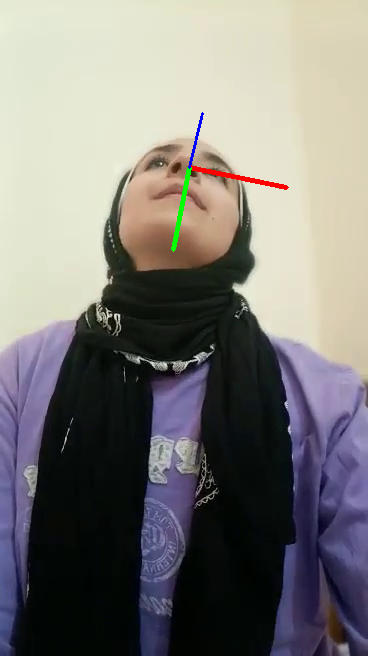

read a new frame: True
0    188
Name: 2, dtype: int64
0    163
Name: 3, dtype: int64
0    188
Name: 2, dtype: int64


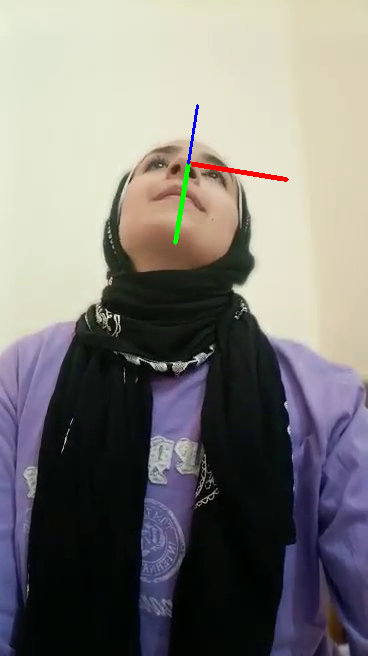

read a new frame: True
0    187
Name: 2, dtype: int64
0    165
Name: 3, dtype: int64
0    187
Name: 2, dtype: int64


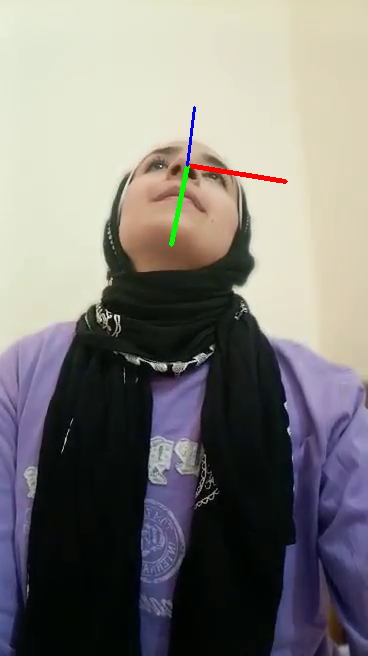

read a new frame: True
0    189
Name: 2, dtype: int64
0    164
Name: 3, dtype: int64
0    189
Name: 2, dtype: int64


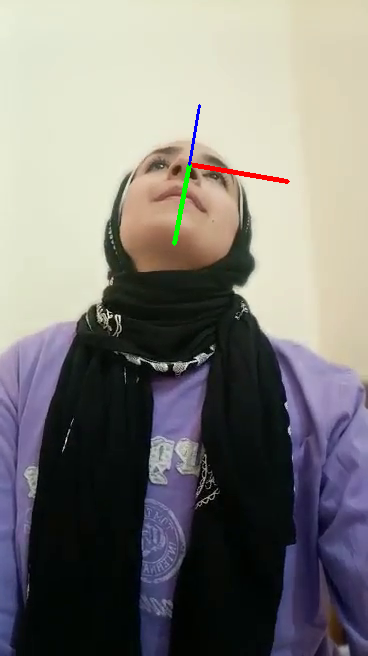

read a new frame: True
0    189
Name: 2, dtype: int64
0    166
Name: 3, dtype: int64
0    189
Name: 2, dtype: int64


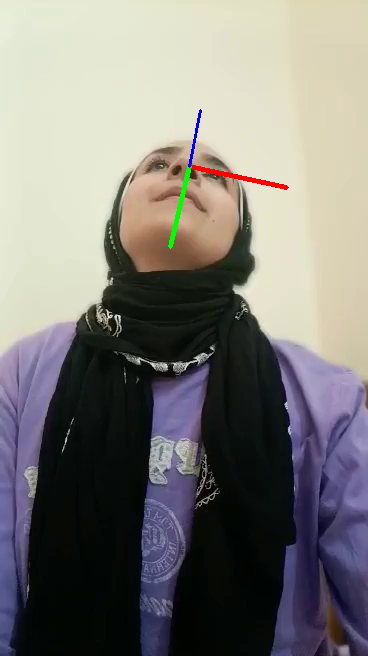

read a new frame: True
0    189
Name: 2, dtype: int64
0    166
Name: 3, dtype: int64
0    189
Name: 2, dtype: int64


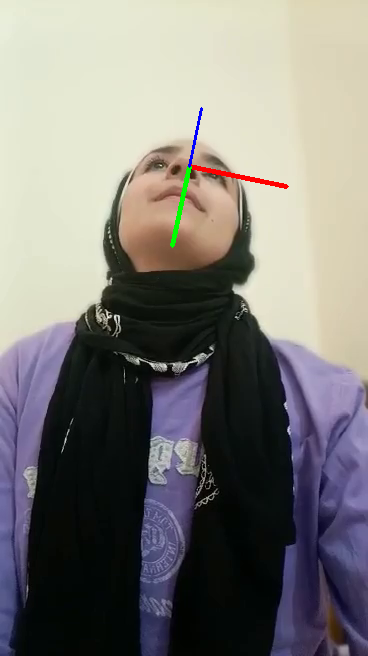

read a new frame: True
0    189
Name: 2, dtype: int64
0    166
Name: 3, dtype: int64
0    189
Name: 2, dtype: int64


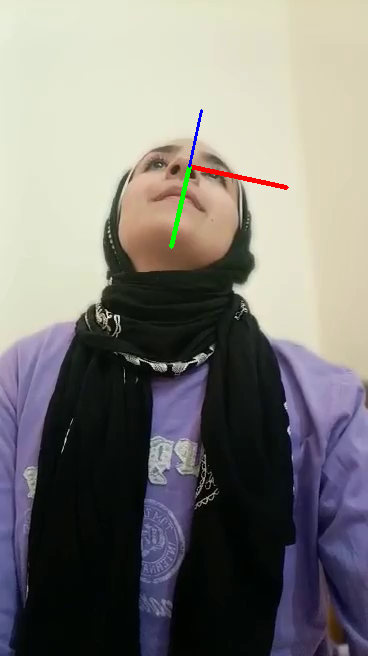

read a new frame: True
0    187
Name: 2, dtype: int64
0    167
Name: 3, dtype: int64
0    187
Name: 2, dtype: int64


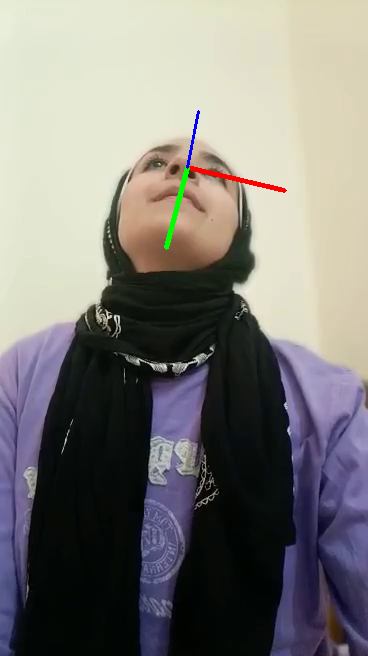

read a new frame: True
0    186
Name: 2, dtype: int64
0    166
Name: 3, dtype: int64
0    186
Name: 2, dtype: int64


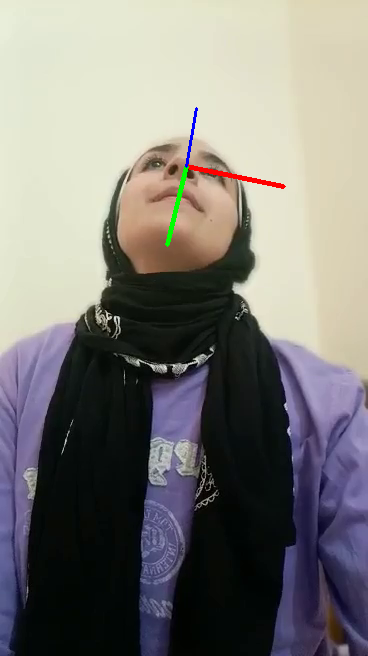

read a new frame: True
0    184
Name: 2, dtype: int64
0    166
Name: 3, dtype: int64
0    184
Name: 2, dtype: int64


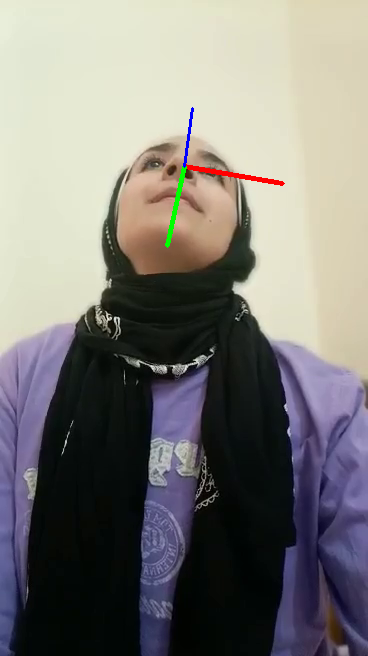

read a new frame: True
0    182
Name: 2, dtype: int64
0    164
Name: 3, dtype: int64
0    182
Name: 2, dtype: int64


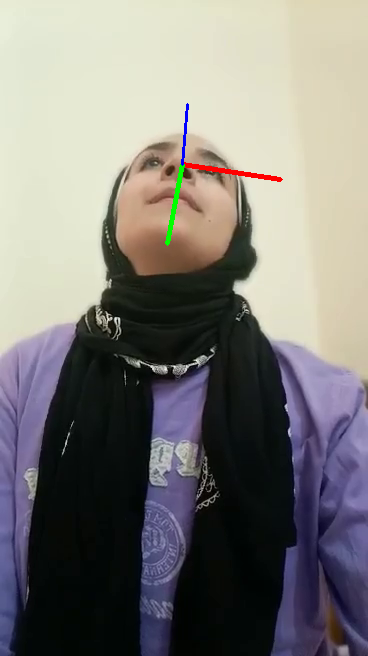

read a new frame: True
0    179
Name: 2, dtype: int64
0    163
Name: 3, dtype: int64
0    179
Name: 2, dtype: int64


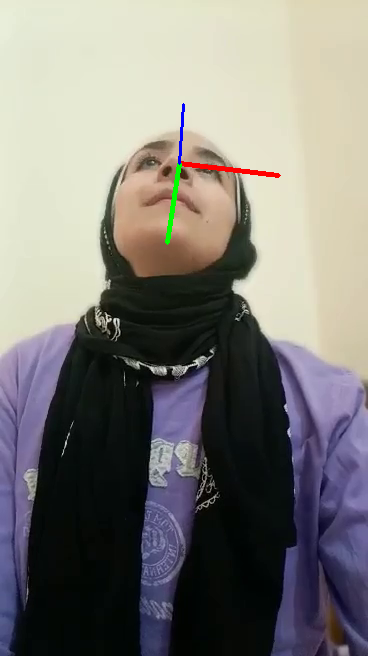

read a new frame: True
0    175
Name: 2, dtype: int64
0    168
Name: 3, dtype: int64
0    175
Name: 2, dtype: int64


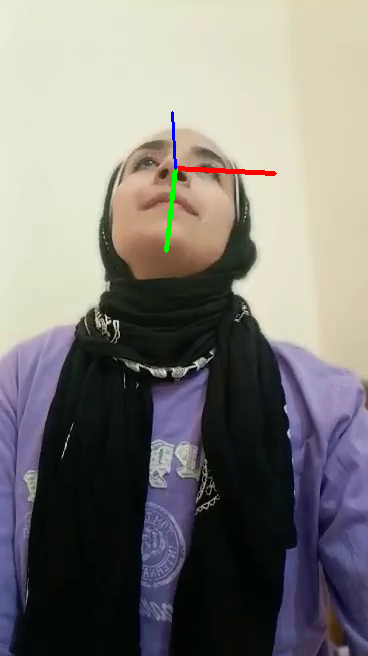

read a new frame: True
0    174
Name: 2, dtype: int64
0    169
Name: 3, dtype: int64
0    174
Name: 2, dtype: int64


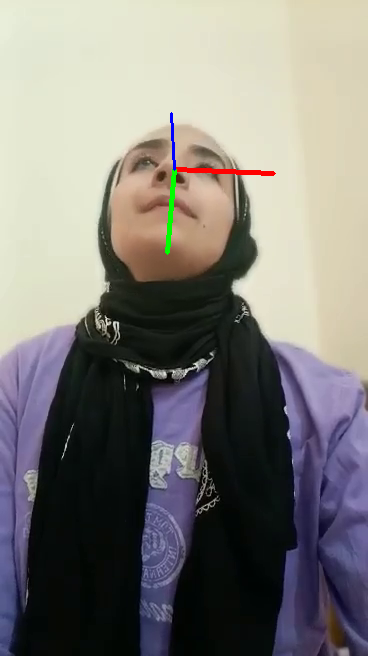

read a new frame: True
0    172
Name: 2, dtype: int64
0    170
Name: 3, dtype: int64
0    172
Name: 2, dtype: int64


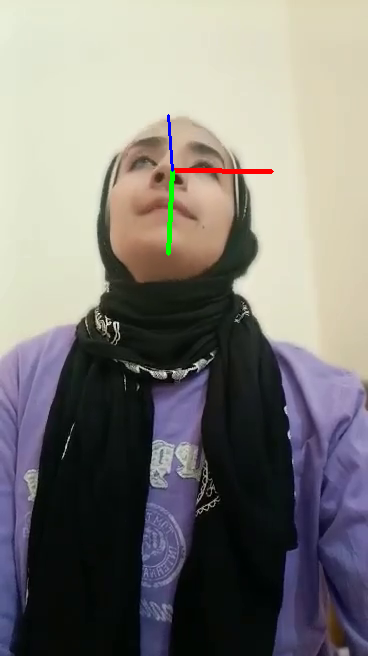

read a new frame: True
0    169
Name: 2, dtype: int64
0    172
Name: 3, dtype: int64
0    169
Name: 2, dtype: int64


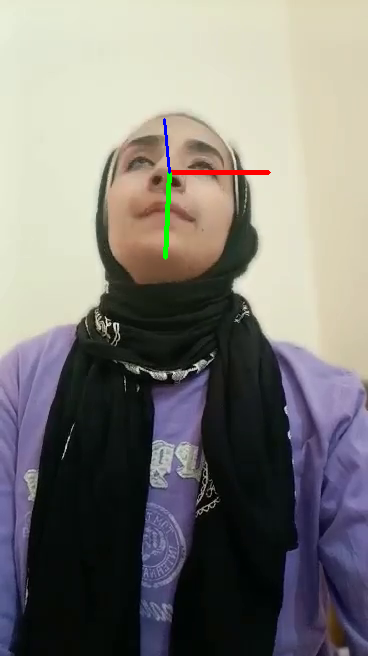

read a new frame: True
0    166
Name: 2, dtype: int64
0    175
Name: 3, dtype: int64
0    166
Name: 2, dtype: int64


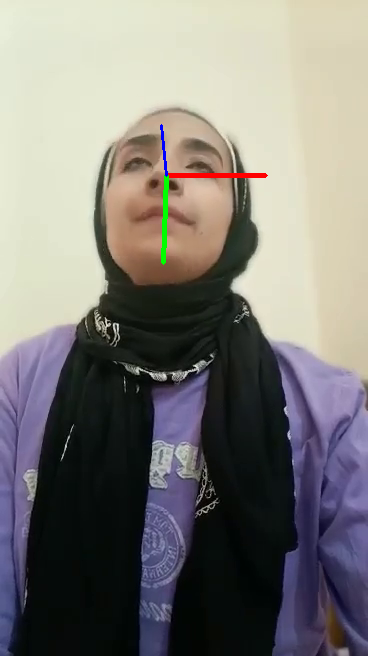

read a new frame: True
0    164
Name: 2, dtype: int64
0    180
Name: 3, dtype: int64
0    164
Name: 2, dtype: int64


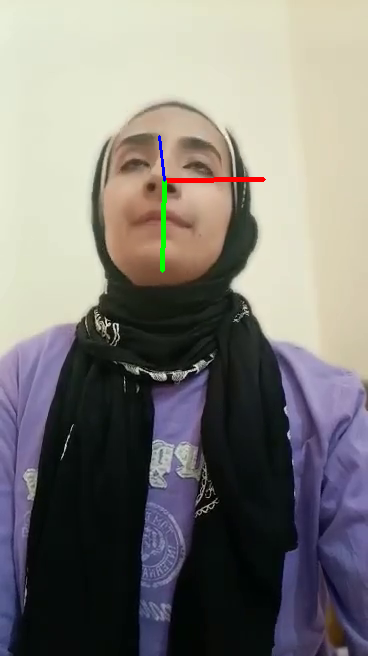

read a new frame: True
0    161
Name: 2, dtype: int64
0    183
Name: 3, dtype: int64
0    161
Name: 2, dtype: int64


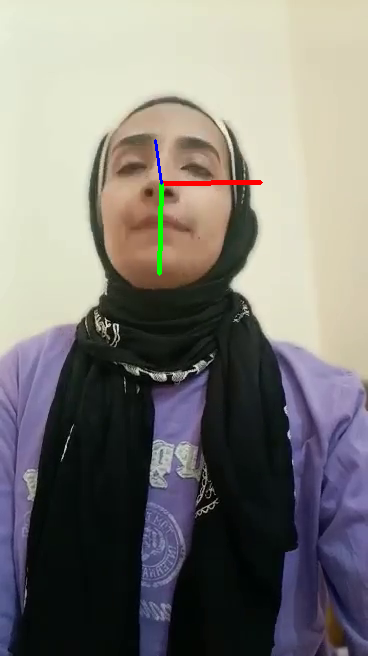

read a new frame: True
0    157
Name: 2, dtype: int64
0    192
Name: 3, dtype: int64
0    157
Name: 2, dtype: int64


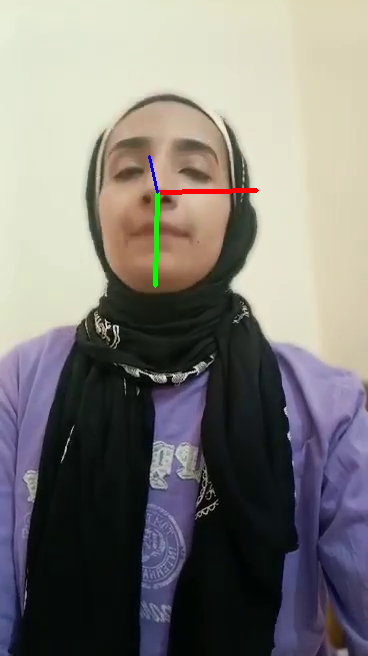

read a new frame: True
0    155
Name: 2, dtype: int64
0    200
Name: 3, dtype: int64
0    155
Name: 2, dtype: int64


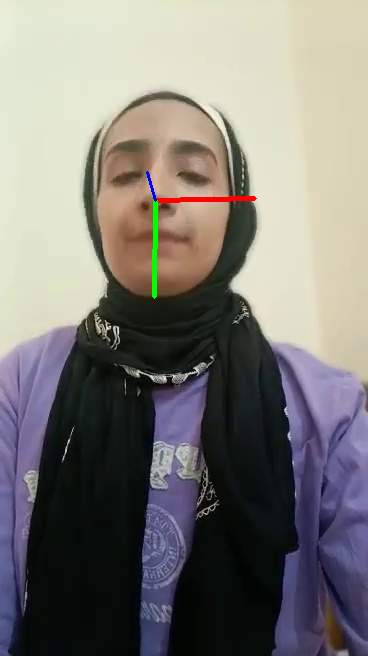

read a new frame: True
0    153
Name: 2, dtype: int64
0    209
Name: 3, dtype: int64
0    153
Name: 2, dtype: int64


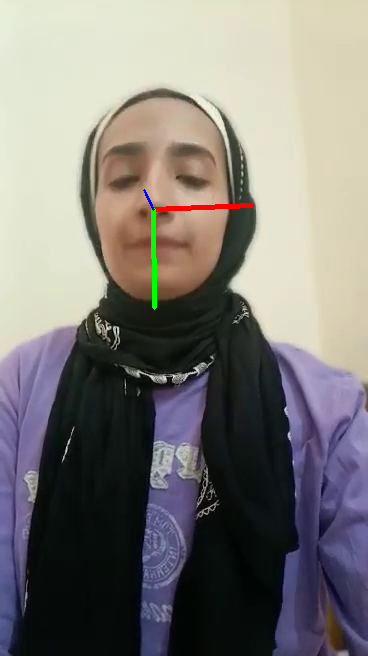

read a new frame: True
0    154
Name: 2, dtype: int64
0    214
Name: 3, dtype: int64
0    154
Name: 2, dtype: int64


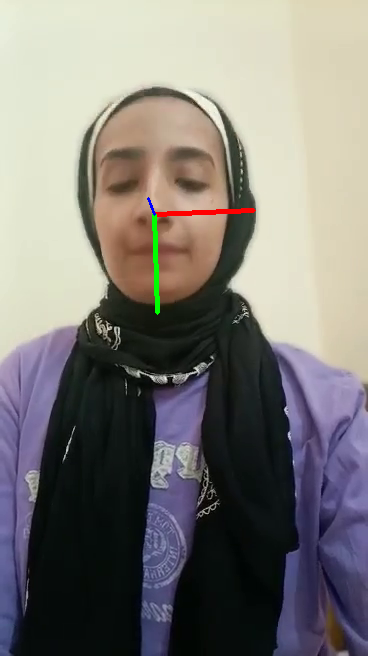

read a new frame: True
0    154
Name: 2, dtype: int64
0    225
Name: 3, dtype: int64
0    154
Name: 2, dtype: int64


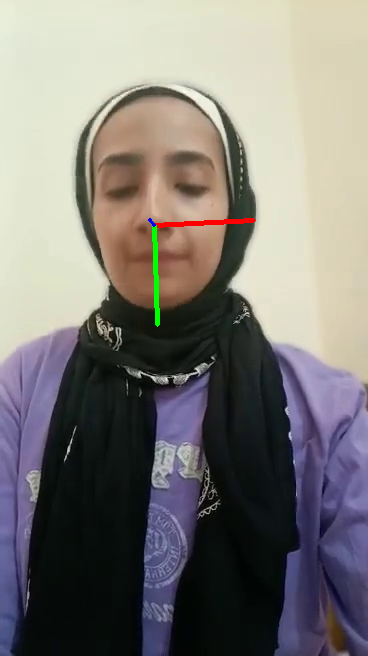

read a new frame: True
0    154
Name: 2, dtype: int64
0    235
Name: 3, dtype: int64
0    154
Name: 2, dtype: int64


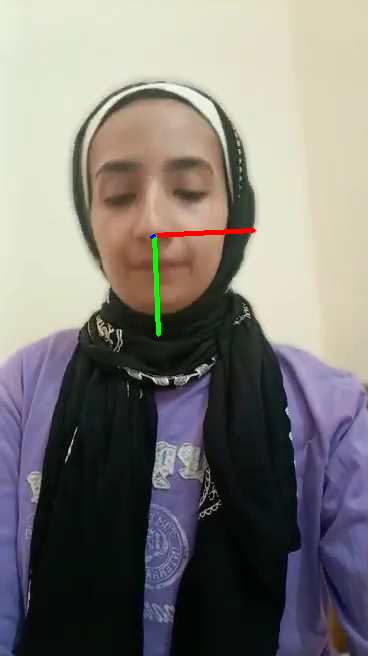

read a new frame: True
0    153
Name: 2, dtype: int64
0    246
Name: 3, dtype: int64
0    153
Name: 2, dtype: int64


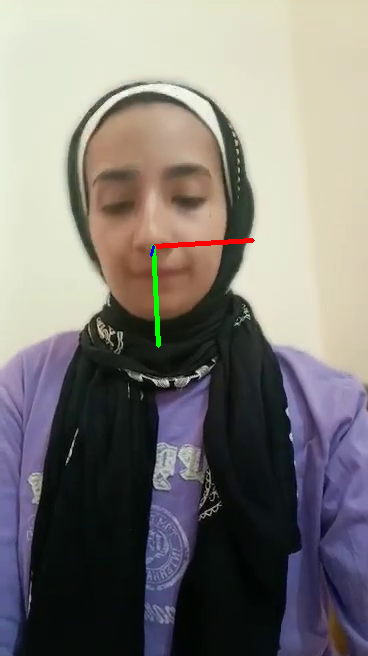

read a new frame: True
0    153
Name: 2, dtype: int64
0    246
Name: 3, dtype: int64
0    153
Name: 2, dtype: int64


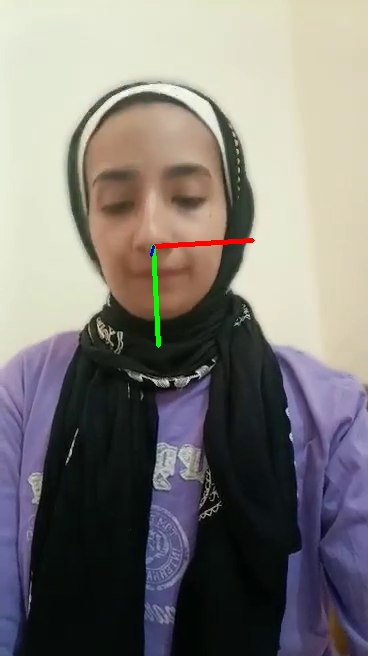

read a new frame: True
0    152
Name: 2, dtype: int64
0    255
Name: 3, dtype: int64
0    152
Name: 2, dtype: int64


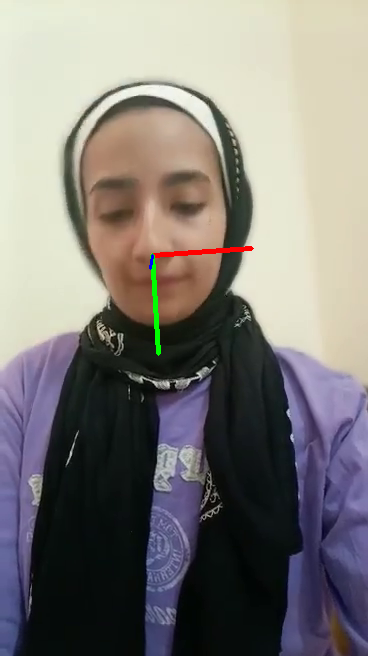

read a new frame: True
0    150
Name: 2, dtype: int64
0    263
Name: 3, dtype: int64
0    150
Name: 2, dtype: int64


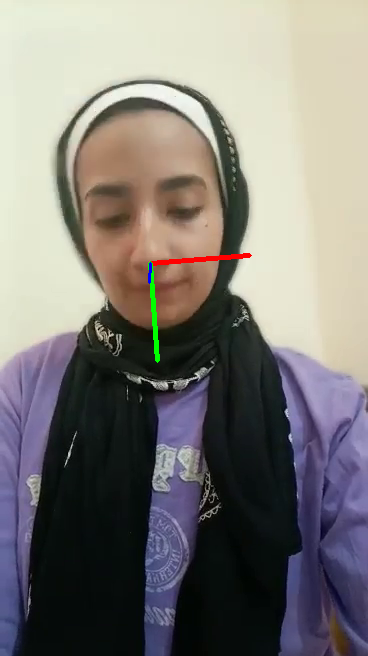

read a new frame: True
0    152
Name: 2, dtype: int64
0    270
Name: 3, dtype: int64
0    152
Name: 2, dtype: int64


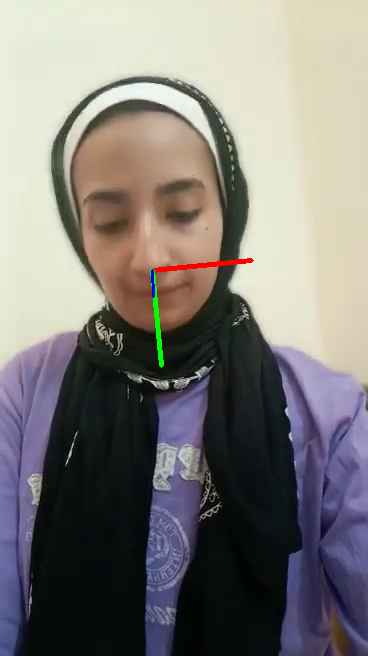

read a new frame: True
0    152
Name: 2, dtype: int64
0    279
Name: 3, dtype: int64
0    152
Name: 2, dtype: int64


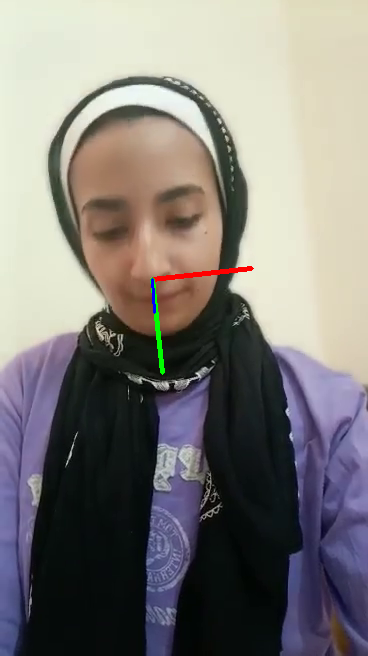

read a new frame: True
0    152
Name: 2, dtype: int64
0    286
Name: 3, dtype: int64
0    152
Name: 2, dtype: int64


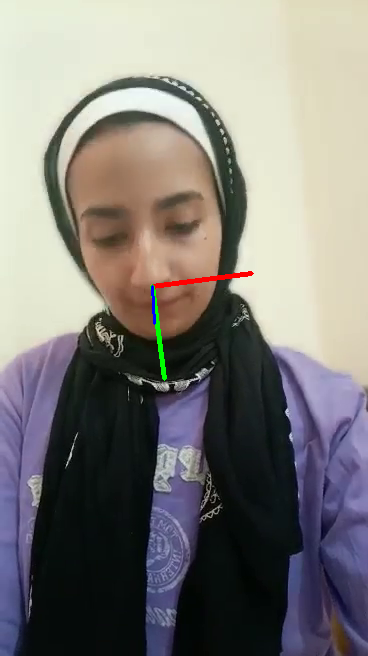

read a new frame: True
0    153
Name: 2, dtype: int64
0    293
Name: 3, dtype: int64
0    153
Name: 2, dtype: int64


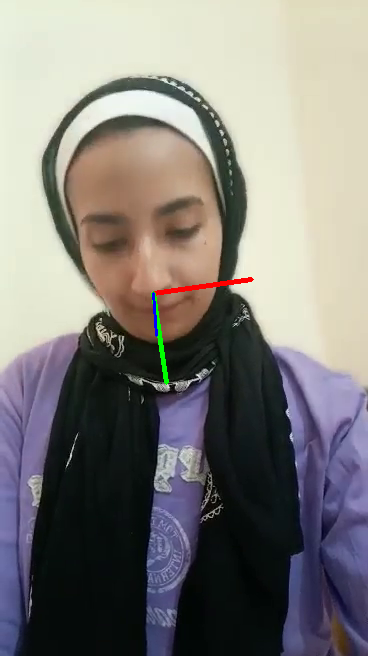

read a new frame: True
0    154
Name: 2, dtype: int64
0    298
Name: 3, dtype: int64
0    154
Name: 2, dtype: int64


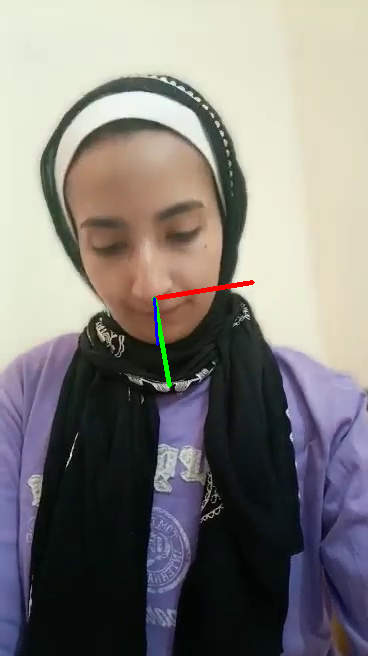

read a new frame: True
0    154
Name: 2, dtype: int64
0    299
Name: 3, dtype: int64
0    154
Name: 2, dtype: int64


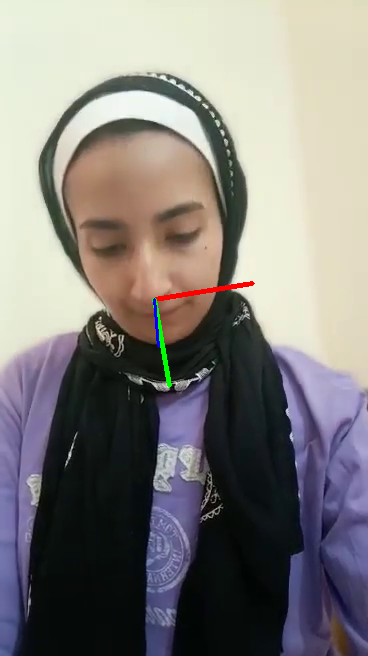

read a new frame: True
0    153
Name: 2, dtype: int64
0    299
Name: 3, dtype: int64
0    153
Name: 2, dtype: int64


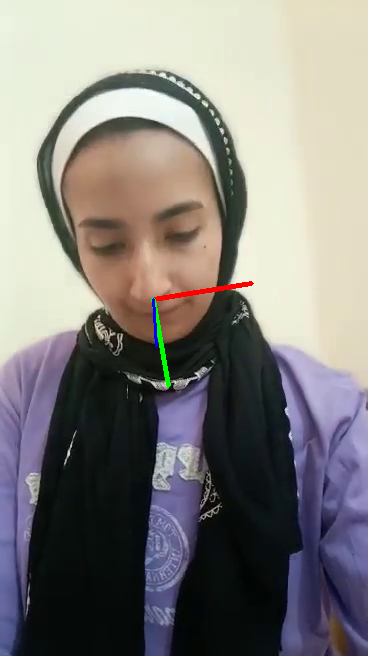

read a new frame: True
0    154
Name: 2, dtype: int64
0    298
Name: 3, dtype: int64
0    154
Name: 2, dtype: int64


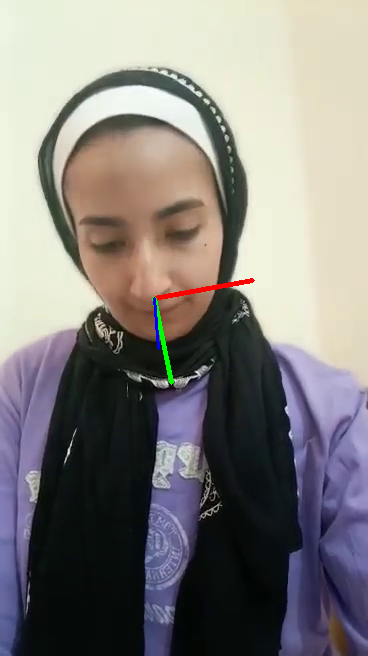

read a new frame: True
0    154
Name: 2, dtype: int64
0    296
Name: 3, dtype: int64
0    154
Name: 2, dtype: int64


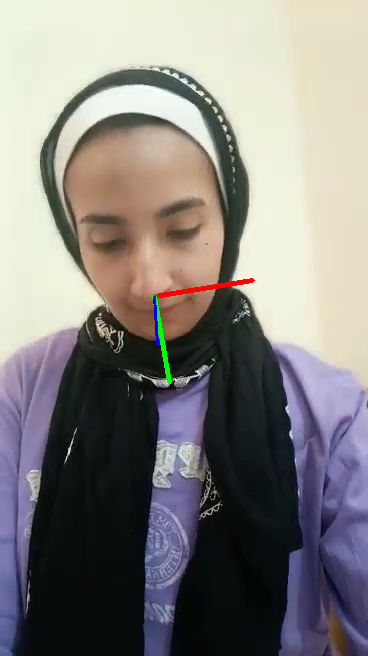

read a new frame: True
0    154
Name: 2, dtype: int64
0    295
Name: 3, dtype: int64
0    154
Name: 2, dtype: int64


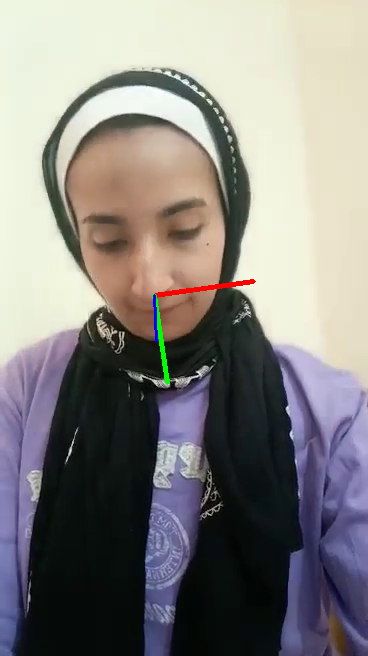

read a new frame: True
0    155
Name: 2, dtype: int64
0    296
Name: 3, dtype: int64
0    155
Name: 2, dtype: int64


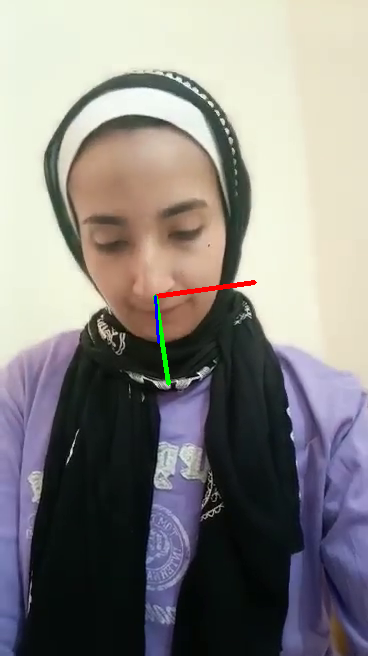

read a new frame: True
0    155
Name: 2, dtype: int64
0    295
Name: 3, dtype: int64
0    155
Name: 2, dtype: int64


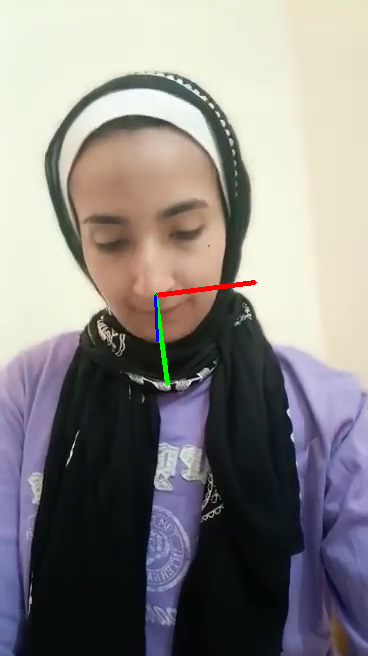

read a new frame: True
0    155
Name: 2, dtype: int64
0    293
Name: 3, dtype: int64
0    155
Name: 2, dtype: int64


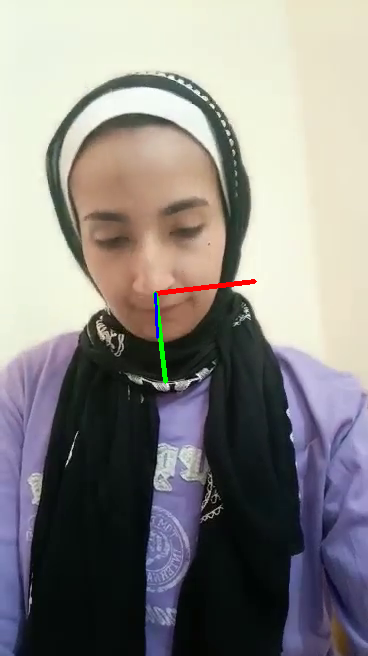

read a new frame: True
0    155
Name: 2, dtype: int64
0    289
Name: 3, dtype: int64
0    155
Name: 2, dtype: int64


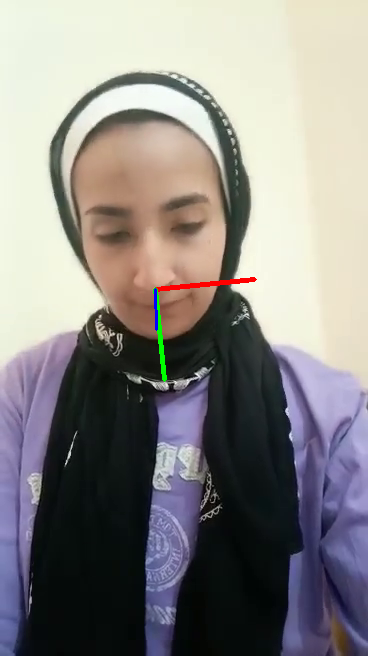

read a new frame: True
0    158
Name: 2, dtype: int64
0    283
Name: 3, dtype: int64
0    158
Name: 2, dtype: int64


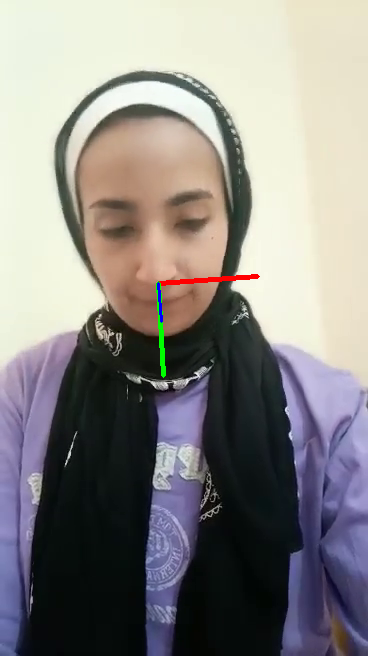

read a new frame: True
0    161
Name: 2, dtype: int64
0    279
Name: 3, dtype: int64
0    161
Name: 2, dtype: int64


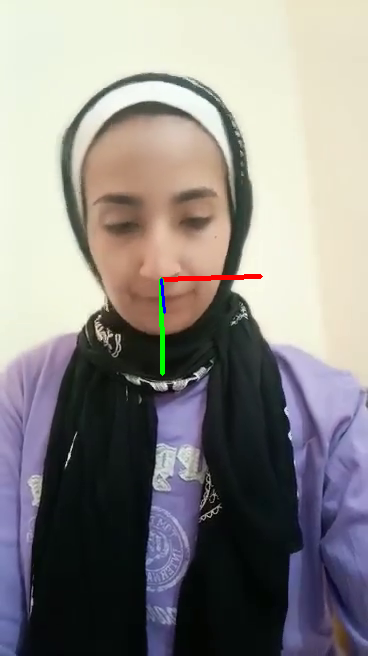

read a new frame: True
0    167
Name: 2, dtype: int64
0    275
Name: 3, dtype: int64
0    167
Name: 2, dtype: int64


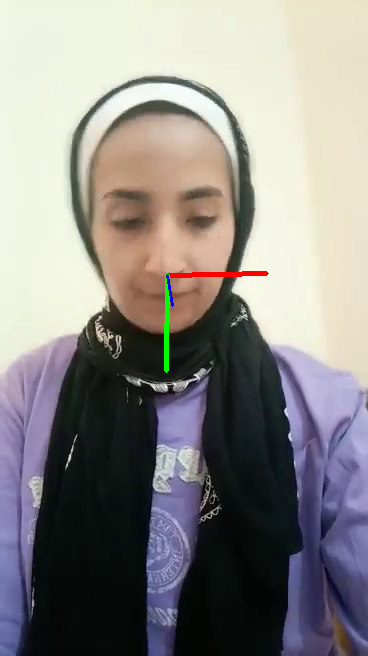

read a new frame: True
0    175
Name: 2, dtype: int64
0    269
Name: 3, dtype: int64
0    175
Name: 2, dtype: int64


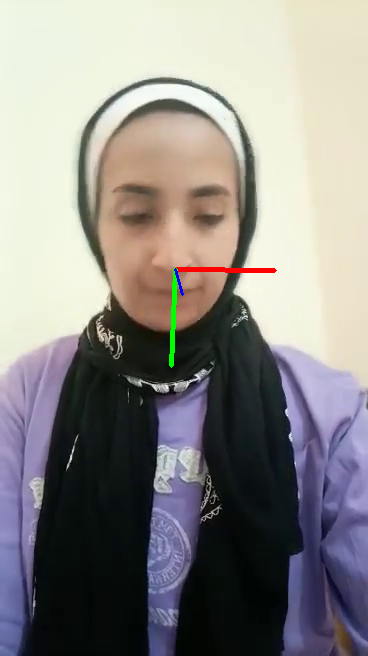

read a new frame: True
0    182
Name: 2, dtype: int64
0    265
Name: 3, dtype: int64
0    182
Name: 2, dtype: int64


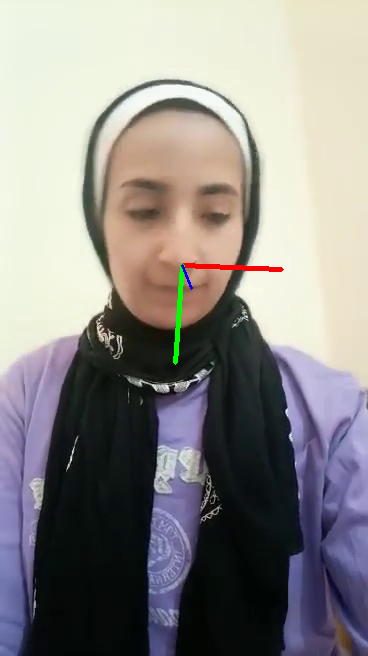

read a new frame: True
0    189
Name: 2, dtype: int64
0    260
Name: 3, dtype: int64
0    189
Name: 2, dtype: int64


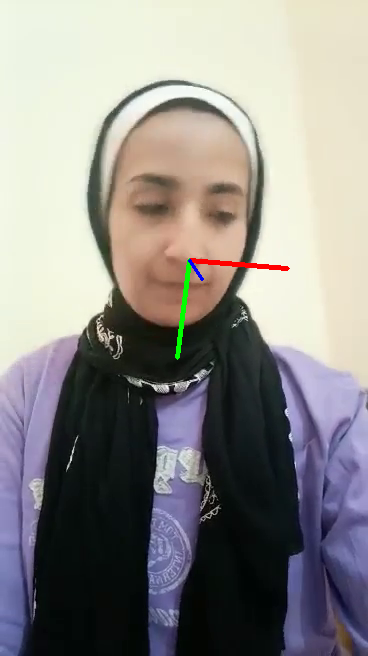

read a new frame: True
0    196
Name: 2, dtype: int64
0    257
Name: 3, dtype: int64
0    196
Name: 2, dtype: int64


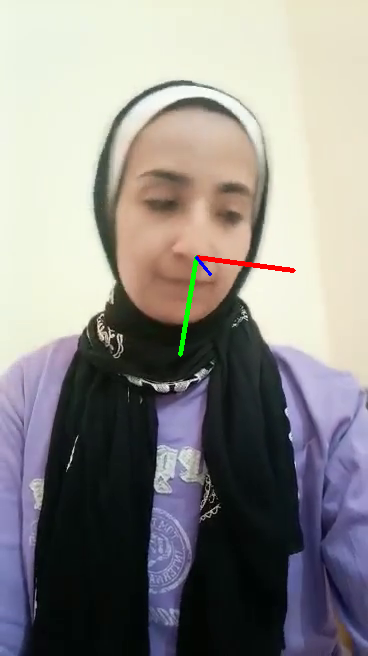

read a new frame: True
0    205
Name: 2, dtype: int64
0    254
Name: 3, dtype: int64
0    205
Name: 2, dtype: int64


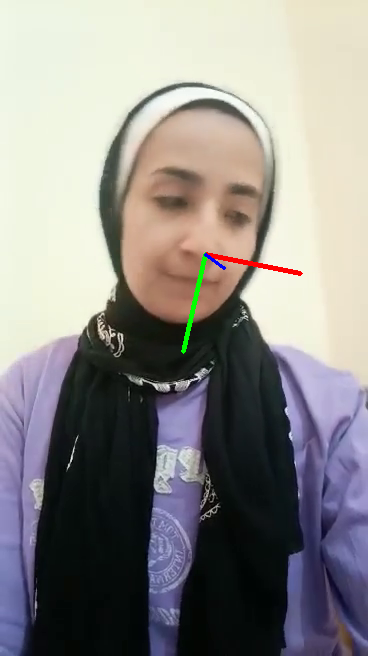

read a new frame: True
0    213
Name: 2, dtype: int64
0    255
Name: 3, dtype: int64
0    213
Name: 2, dtype: int64


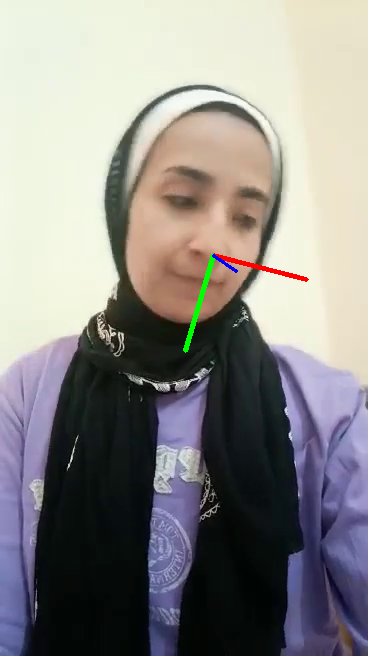

read a new frame: True
0    222
Name: 2, dtype: int64
0    256
Name: 3, dtype: int64
0    222
Name: 2, dtype: int64


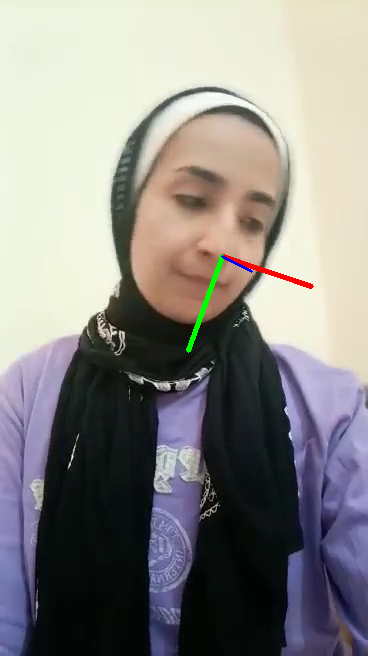

read a new frame: True
0    231
Name: 2, dtype: int64
0    258
Name: 3, dtype: int64
0    231
Name: 2, dtype: int64


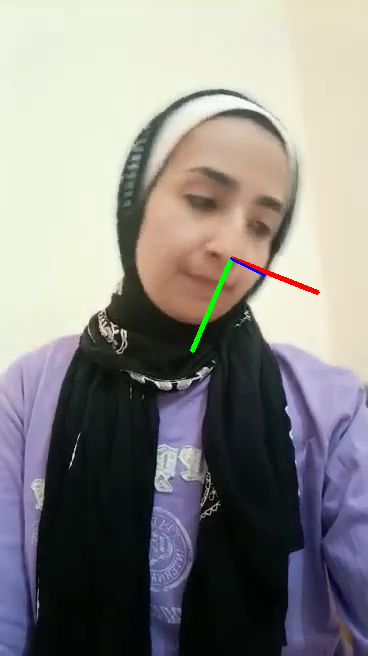

read a new frame: True
0    240
Name: 2, dtype: int64
0    261
Name: 3, dtype: int64
0    240
Name: 2, dtype: int64


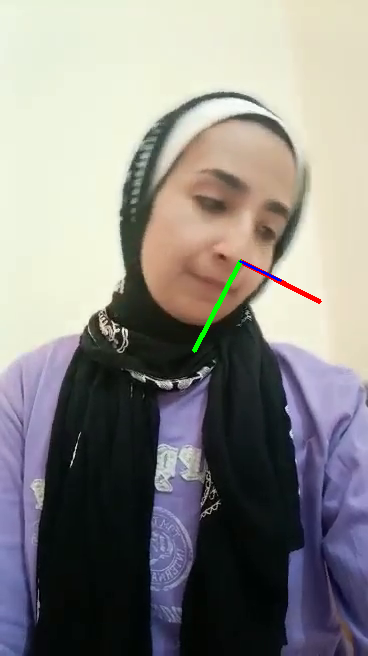

read a new frame: True
0    246
Name: 2, dtype: int64
0    264
Name: 3, dtype: int64
0    246
Name: 2, dtype: int64


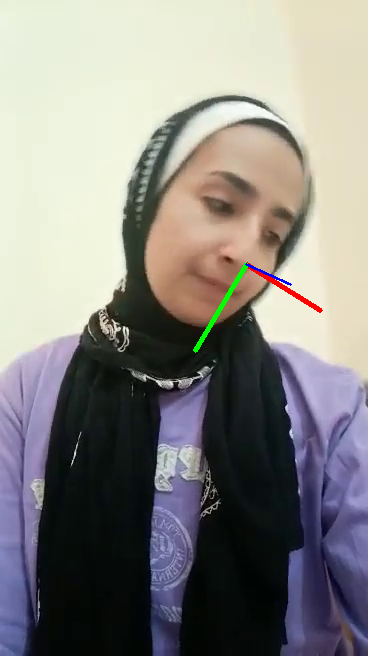

read a new frame: True
0    251
Name: 2, dtype: int64
0    266
Name: 3, dtype: int64
0    251
Name: 2, dtype: int64


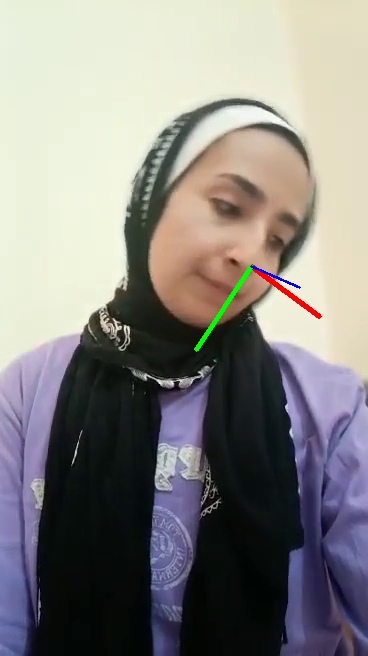

read a new frame: True
0    254
Name: 2, dtype: int64
0    270
Name: 3, dtype: int64
0    254
Name: 2, dtype: int64


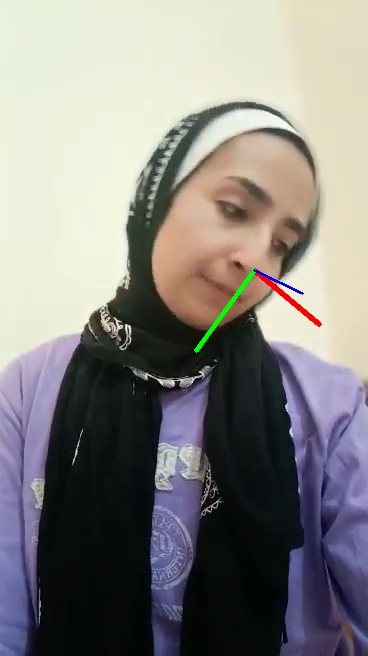

read a new frame: True
0    257
Name: 2, dtype: int64
0    274
Name: 3, dtype: int64
0    257
Name: 2, dtype: int64


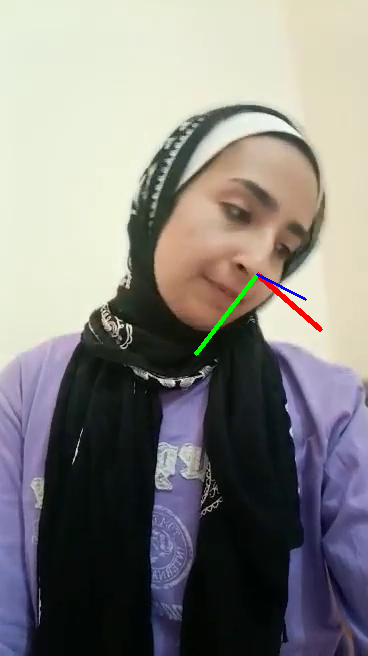

read a new frame: True
0    260
Name: 2, dtype: int64
0    274
Name: 3, dtype: int64
0    260
Name: 2, dtype: int64


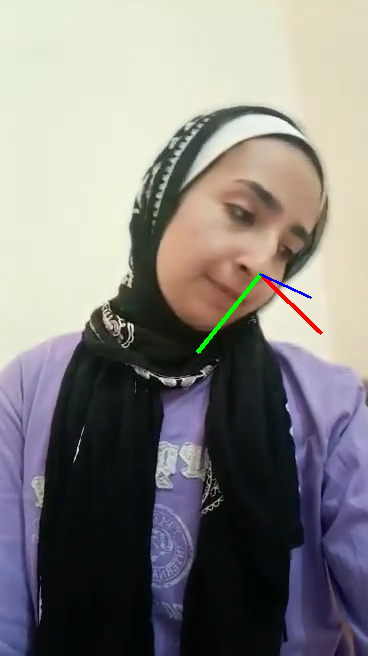

read a new frame: True
0    260
Name: 2, dtype: int64
0    276
Name: 3, dtype: int64
0    260
Name: 2, dtype: int64


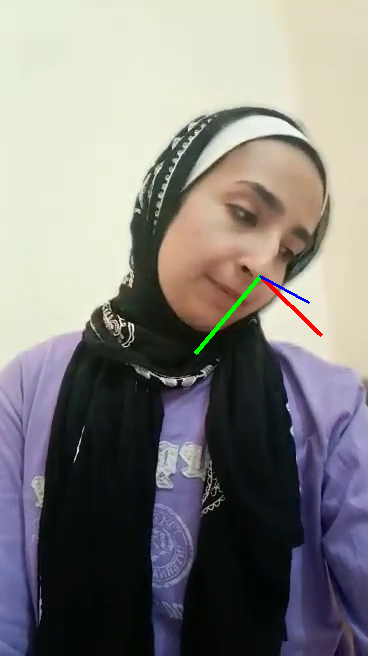

read a new frame: True
0    261
Name: 2, dtype: int64
0    277
Name: 3, dtype: int64
0    261
Name: 2, dtype: int64


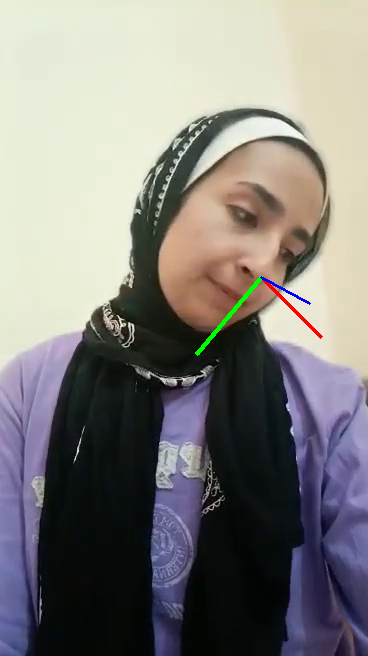

read a new frame: True
0    261
Name: 2, dtype: int64
0    277
Name: 3, dtype: int64
0    261
Name: 2, dtype: int64


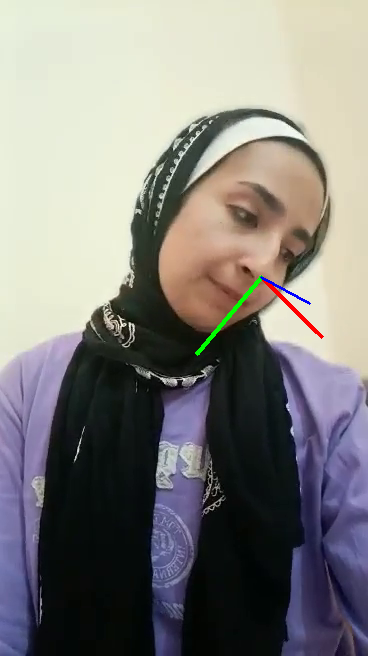

read a new frame: True
0    261
Name: 2, dtype: int64
0    277
Name: 3, dtype: int64
0    261
Name: 2, dtype: int64


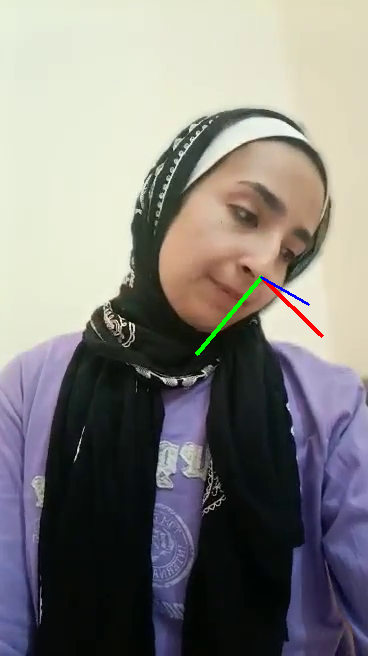

read a new frame: True
0    262
Name: 2, dtype: int64
0    277
Name: 3, dtype: int64
0    262
Name: 2, dtype: int64


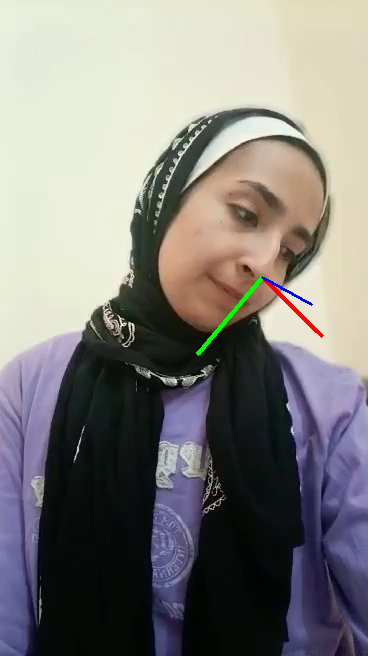

read a new frame: True
0    261
Name: 2, dtype: int64
0    276
Name: 3, dtype: int64
0    261
Name: 2, dtype: int64


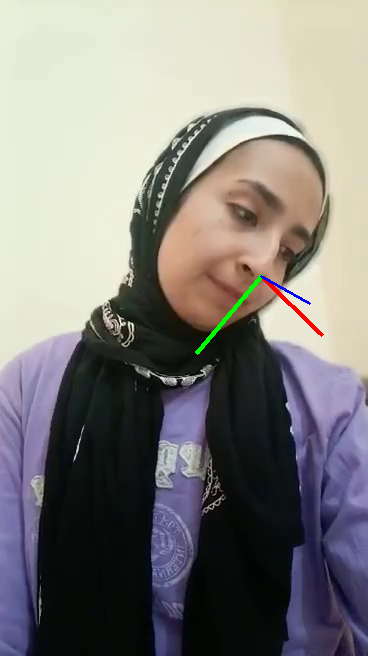

read a new frame: True
0    261
Name: 2, dtype: int64
0    275
Name: 3, dtype: int64
0    261
Name: 2, dtype: int64


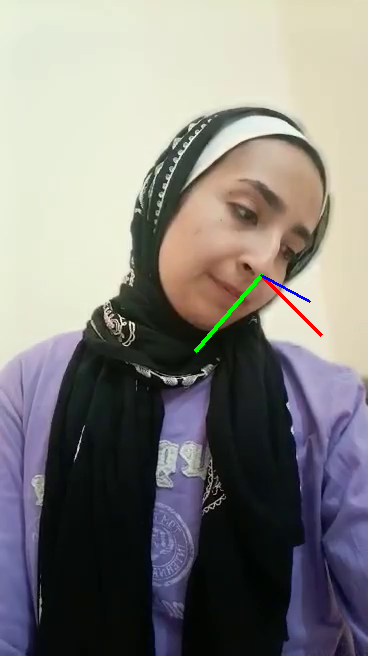

read a new frame: True
0    261
Name: 2, dtype: int64
0    275
Name: 3, dtype: int64
0    261
Name: 2, dtype: int64


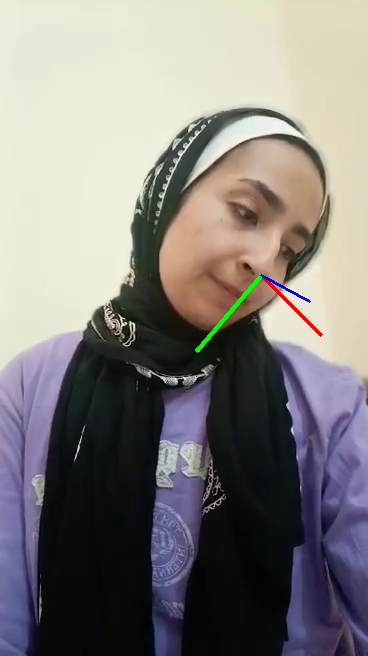

read a new frame: True
0    262
Name: 2, dtype: int64
0    275
Name: 3, dtype: int64
0    262
Name: 2, dtype: int64


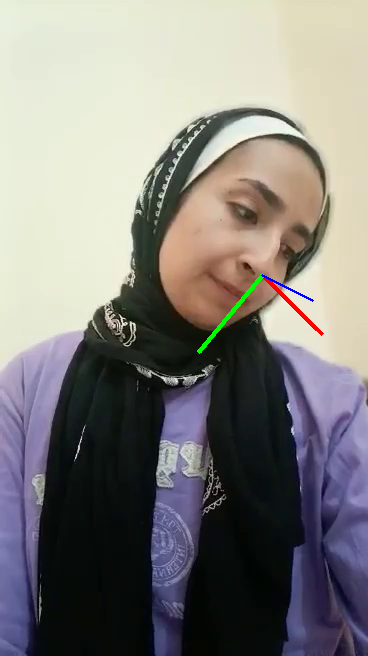

read a new frame: True
0    262
Name: 2, dtype: int64
0    272
Name: 3, dtype: int64
0    262
Name: 2, dtype: int64


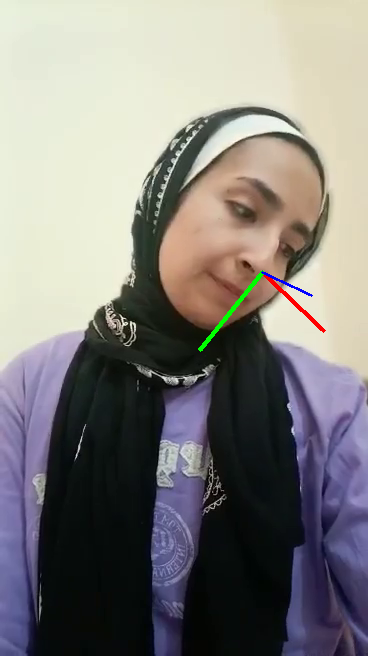

read a new frame: True
0    261
Name: 2, dtype: int64
0    269
Name: 3, dtype: int64
0    261
Name: 2, dtype: int64


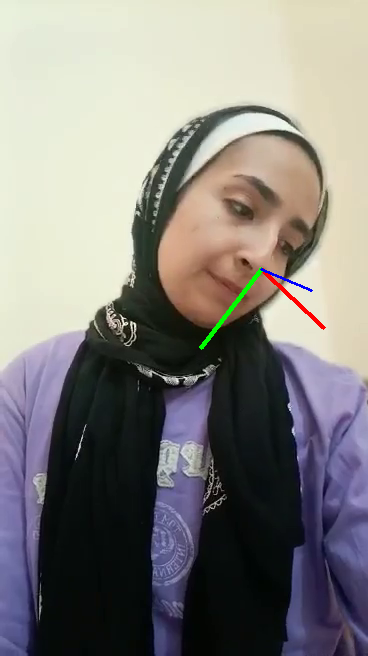

read a new frame: True
0    257
Name: 2, dtype: int64
0    266
Name: 3, dtype: int64
0    257
Name: 2, dtype: int64


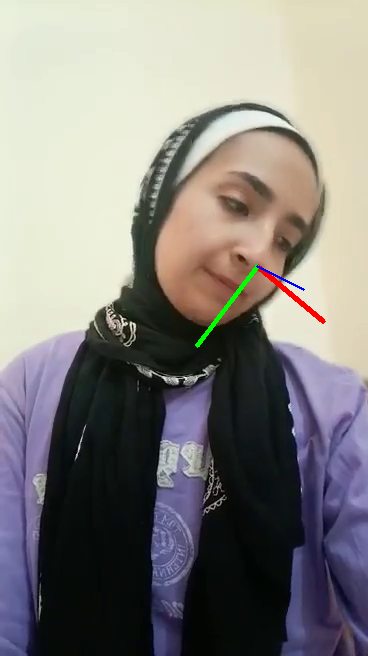

read a new frame: True
0    251
Name: 2, dtype: int64
0    259
Name: 3, dtype: int64
0    251
Name: 2, dtype: int64


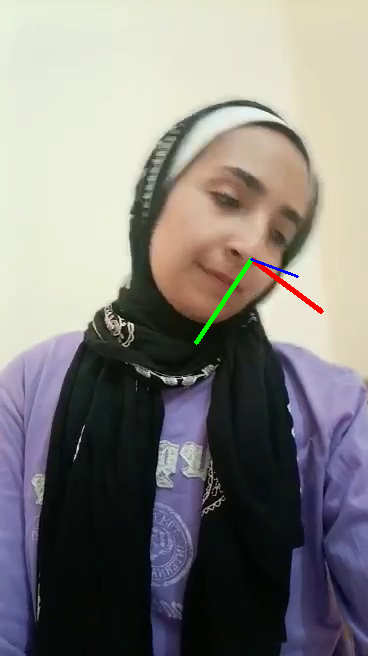

read a new frame: True
0    242
Name: 2, dtype: int64
0    248
Name: 3, dtype: int64
0    242
Name: 2, dtype: int64


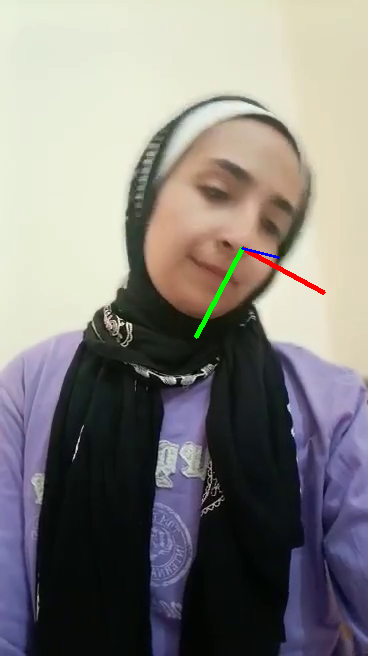

read a new frame: True
0    231
Name: 2, dtype: int64
0    239
Name: 3, dtype: int64
0    231
Name: 2, dtype: int64


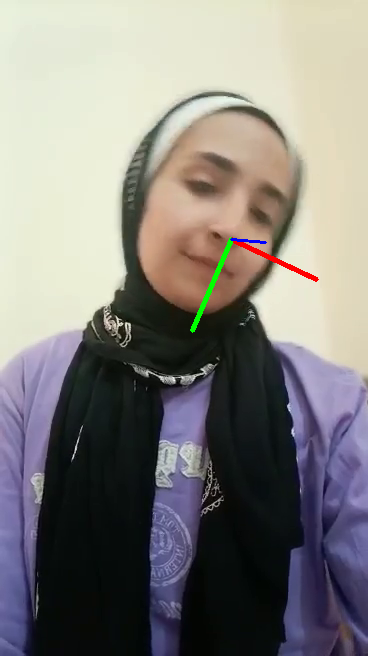

read a new frame: True
0    218
Name: 2, dtype: int64
0    227
Name: 3, dtype: int64
0    218
Name: 2, dtype: int64


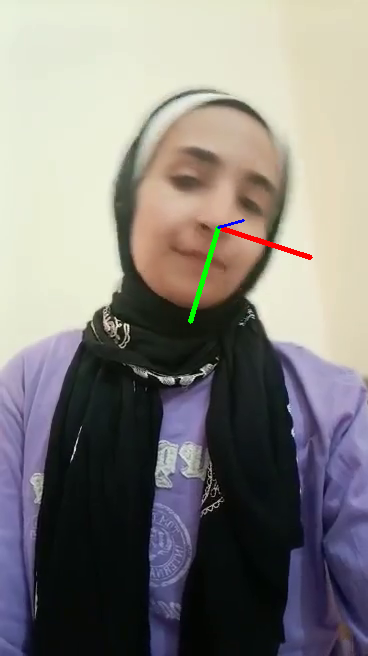

read a new frame: True
0    204
Name: 2, dtype: int64
0    217
Name: 3, dtype: int64
0    204
Name: 2, dtype: int64


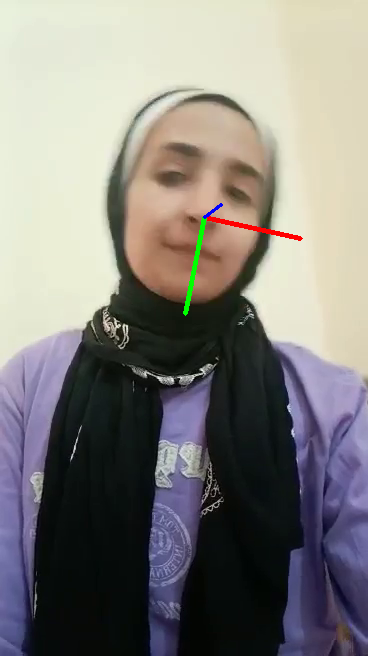

read a new frame: True
0    191
Name: 2, dtype: int64
0    211
Name: 3, dtype: int64
0    191
Name: 2, dtype: int64


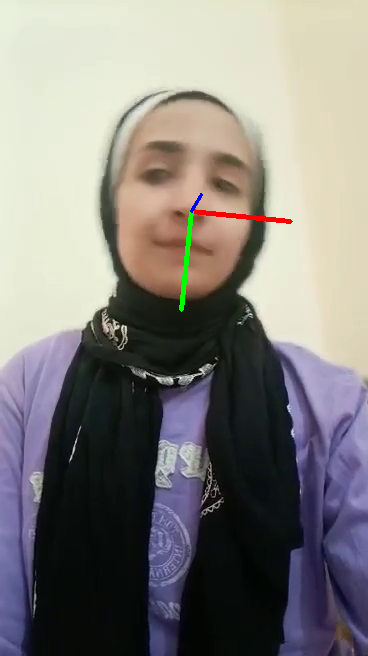

read a new frame: True
0    178
Name: 2, dtype: int64
0    207
Name: 3, dtype: int64
0    178
Name: 2, dtype: int64


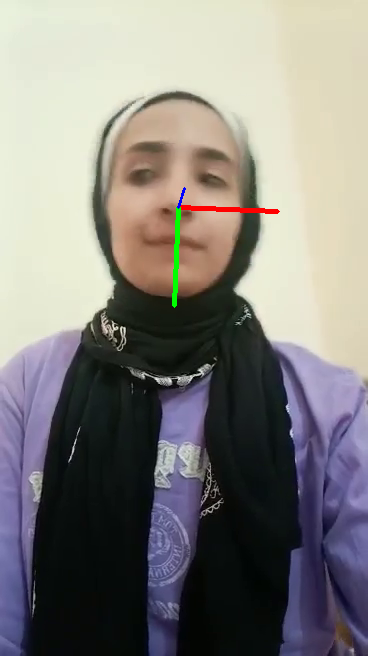

read a new frame: True
0    167
Name: 2, dtype: int64
0    206
Name: 3, dtype: int64
0    167
Name: 2, dtype: int64


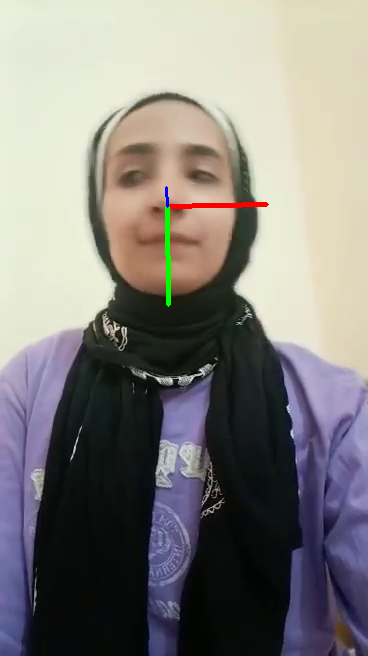

read a new frame: True
0    156
Name: 2, dtype: int64
0    203
Name: 3, dtype: int64
0    156
Name: 2, dtype: int64


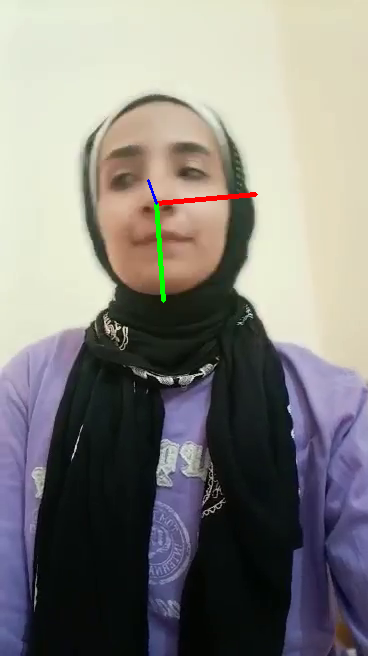

read a new frame: True
0    147
Name: 2, dtype: int64
0    203
Name: 3, dtype: int64
0    147
Name: 2, dtype: int64


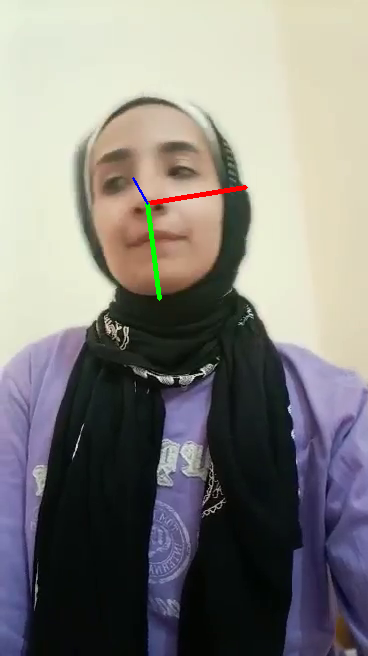

read a new frame: True
0    139
Name: 2, dtype: int64
0    204
Name: 3, dtype: int64
0    139
Name: 2, dtype: int64


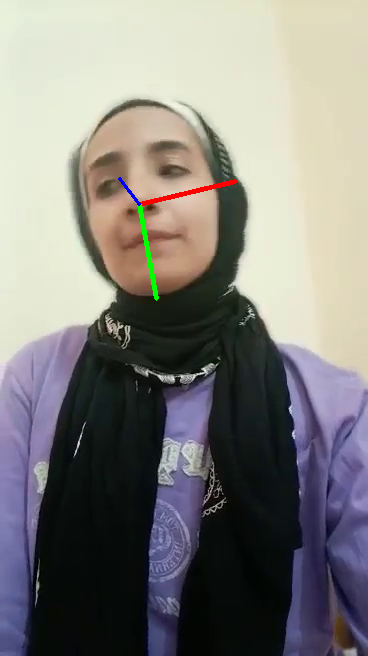

read a new frame: True
0    132
Name: 2, dtype: int64
0    204
Name: 3, dtype: int64
0    132
Name: 2, dtype: int64


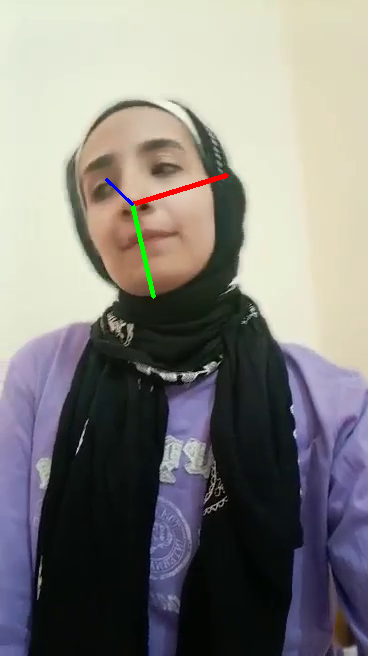

read a new frame: True
0    129
Name: 2, dtype: int64
0    205
Name: 3, dtype: int64
0    129
Name: 2, dtype: int64


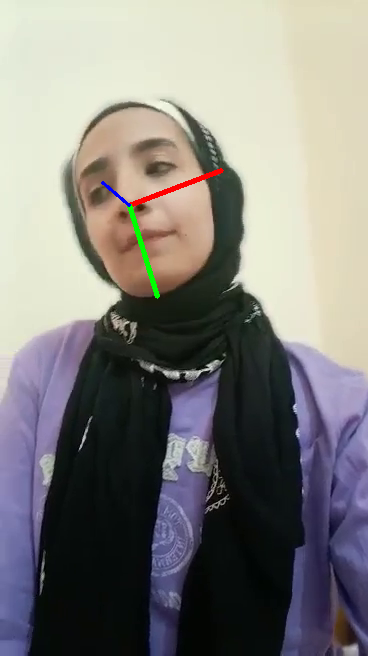

read a new frame: True
0    127
Name: 2, dtype: int64
0    210
Name: 3, dtype: int64
0    127
Name: 2, dtype: int64


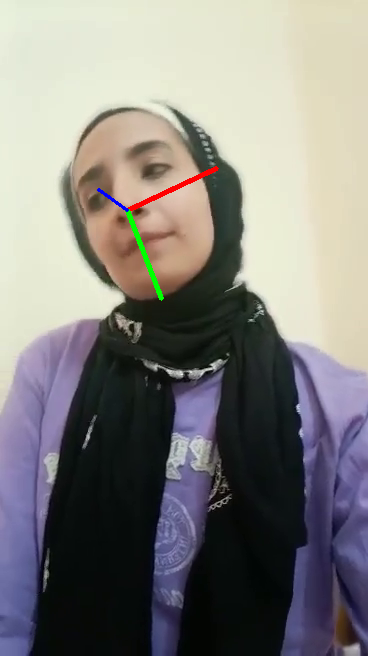

read a new frame: True
0    125
Name: 2, dtype: int64
0    216
Name: 3, dtype: int64
0    125
Name: 2, dtype: int64


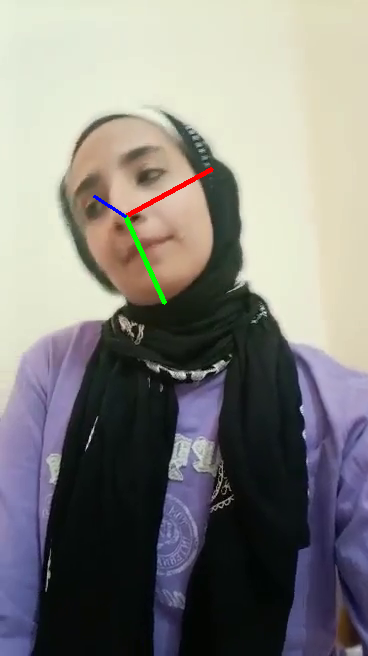

read a new frame: True
0    121
Name: 2, dtype: int64
0    224
Name: 3, dtype: int64
0    121
Name: 2, dtype: int64


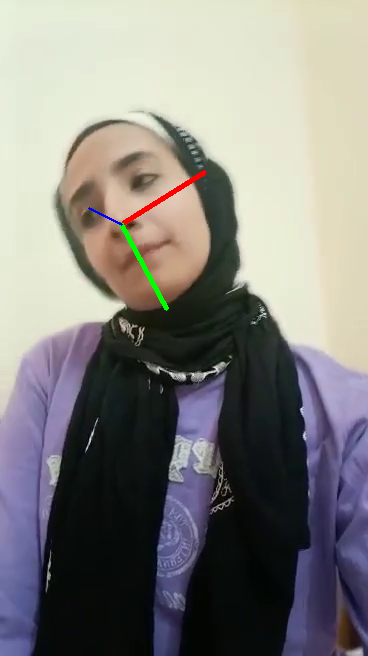

read a new frame: True
0    119
Name: 2, dtype: int64
0    229
Name: 3, dtype: int64
0    119
Name: 2, dtype: int64


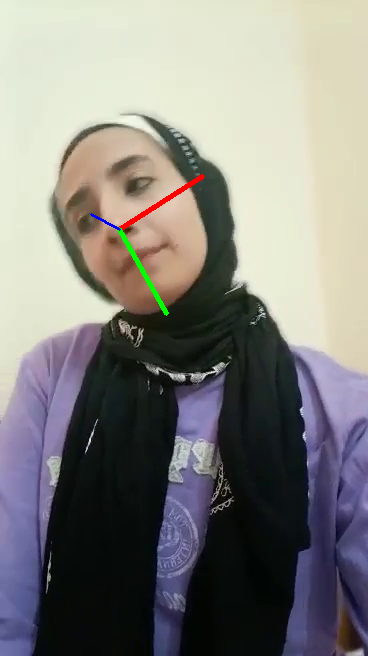

read a new frame: True
0    117
Name: 2, dtype: int64
0    232
Name: 3, dtype: int64
0    117
Name: 2, dtype: int64


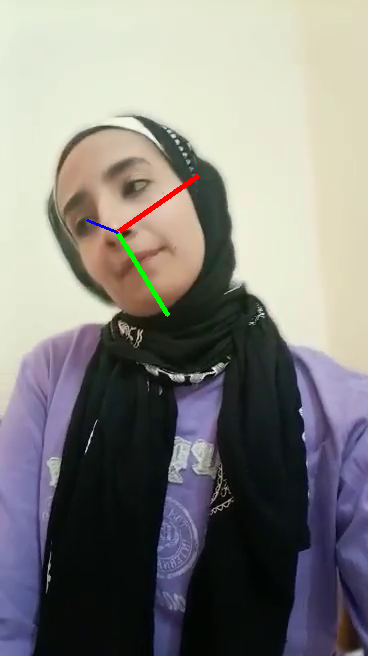

read a new frame: True
0    115
Name: 2, dtype: int64
0    236
Name: 3, dtype: int64
0    115
Name: 2, dtype: int64


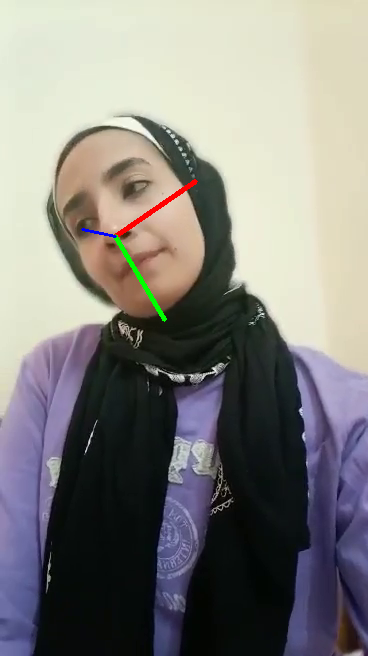

read a new frame: True
0    115
Name: 2, dtype: int64
0    235
Name: 3, dtype: int64
0    115
Name: 2, dtype: int64


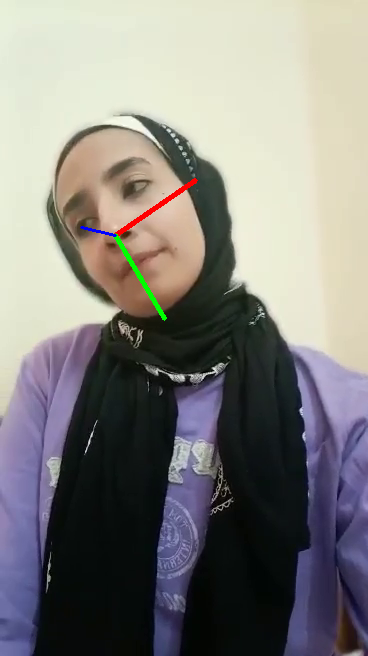

read a new frame: True
0    117
Name: 2, dtype: int64
0    235
Name: 3, dtype: int64
0    117
Name: 2, dtype: int64


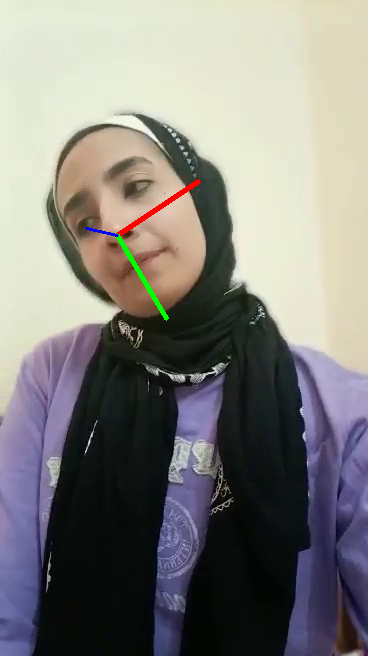

read a new frame: True
0    119
Name: 2, dtype: int64
0    234
Name: 3, dtype: int64
0    119
Name: 2, dtype: int64


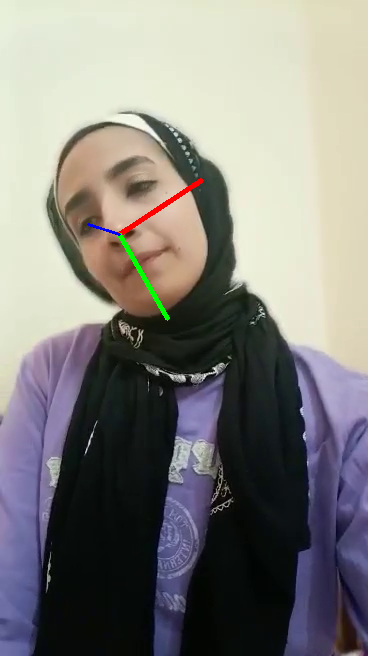

read a new frame: True
0    121
Name: 2, dtype: int64
0    231
Name: 3, dtype: int64
0    121
Name: 2, dtype: int64


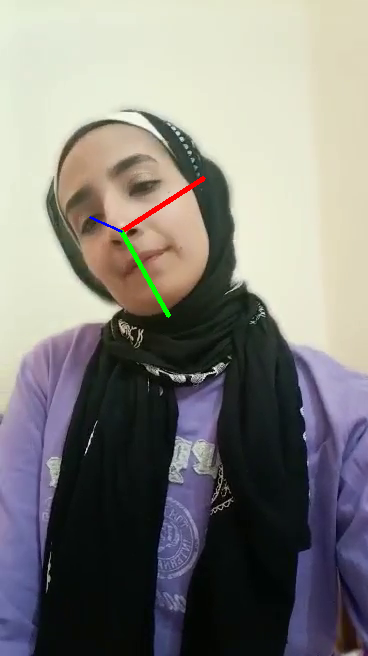

read a new frame: True
0    122
Name: 2, dtype: int64
0    231
Name: 3, dtype: int64
0    122
Name: 2, dtype: int64


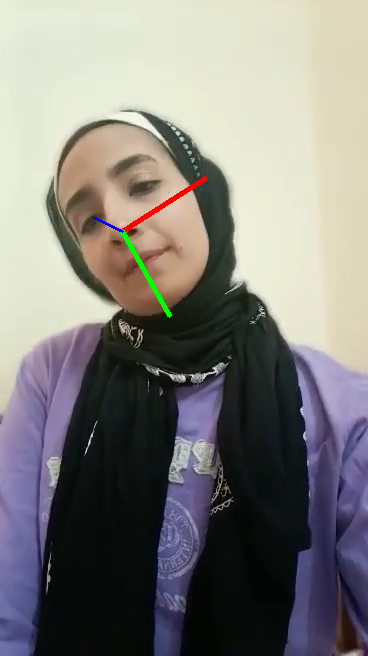

read a new frame: True
0    124
Name: 2, dtype: int64
0    230
Name: 3, dtype: int64
0    124
Name: 2, dtype: int64


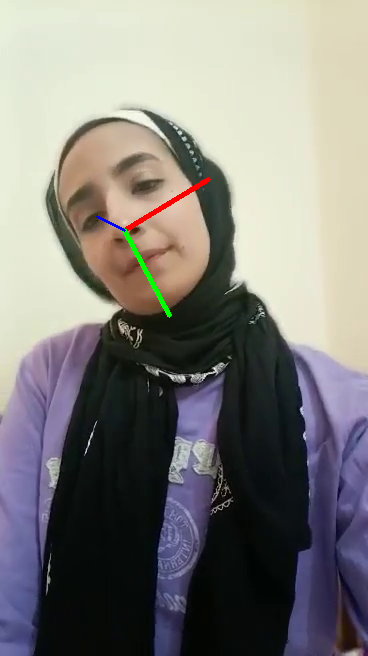

read a new frame: True
0    128
Name: 2, dtype: int64
0    228
Name: 3, dtype: int64
0    128
Name: 2, dtype: int64


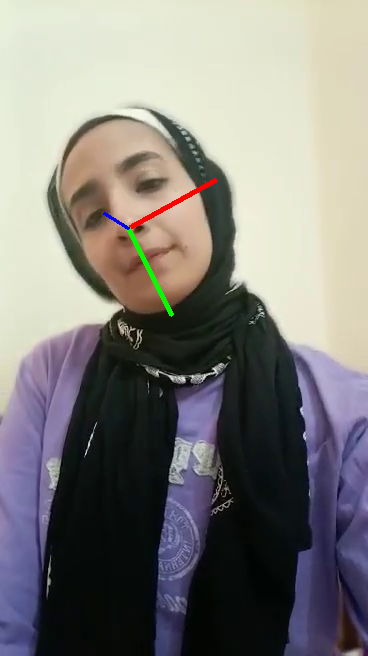

read a new frame: True
0    134
Name: 2, dtype: int64
0    226
Name: 3, dtype: int64
0    134
Name: 2, dtype: int64


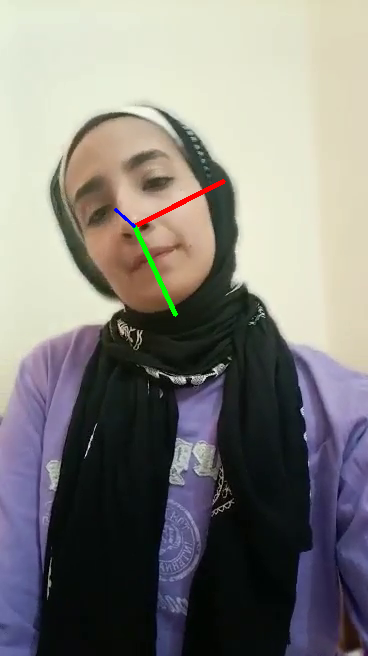

read a new frame: True
0    140
Name: 2, dtype: int64
0    223
Name: 3, dtype: int64
0    140
Name: 2, dtype: int64


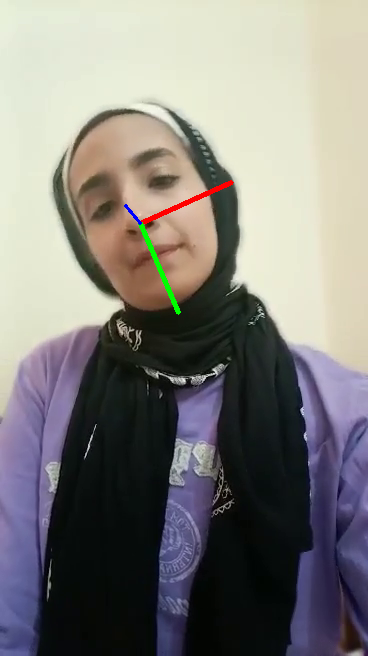

read a new frame: True
0    144
Name: 2, dtype: int64
0    220
Name: 3, dtype: int64
0    144
Name: 2, dtype: int64


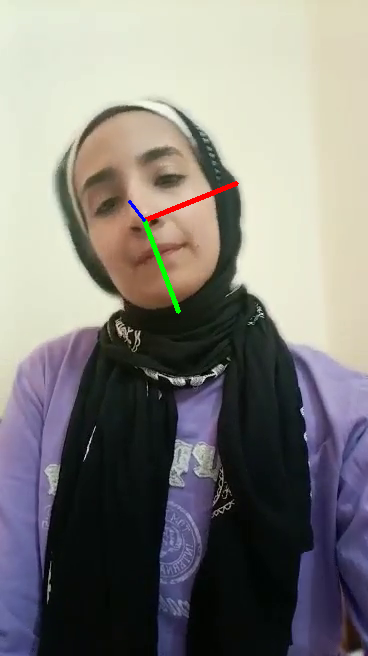

read a new frame: True
0    150
Name: 2, dtype: int64
0    218
Name: 3, dtype: int64
0    150
Name: 2, dtype: int64


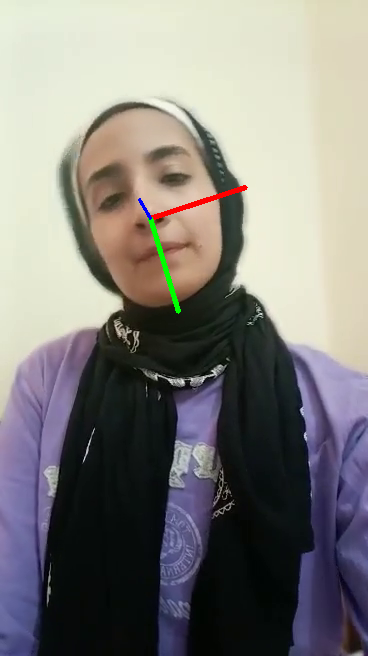

read a new frame: True
0    155
Name: 2, dtype: int64
0    215
Name: 3, dtype: int64
0    155
Name: 2, dtype: int64


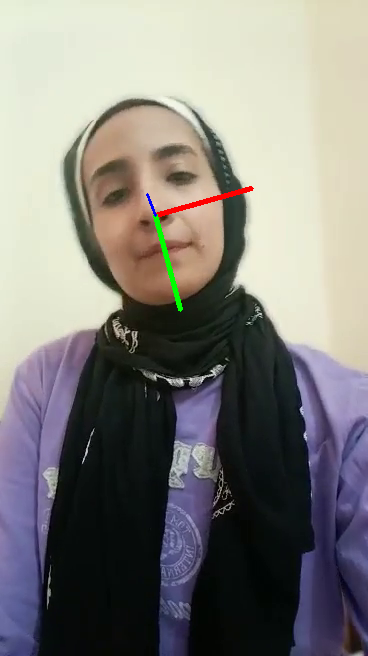

read a new frame: True
0    155
Name: 2, dtype: int64
0    215
Name: 3, dtype: int64
0    155
Name: 2, dtype: int64


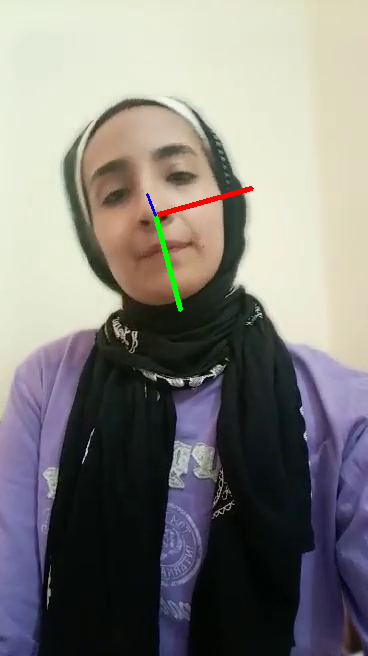

read a new frame: True
0    159
Name: 2, dtype: int64
0    213
Name: 3, dtype: int64
0    159
Name: 2, dtype: int64


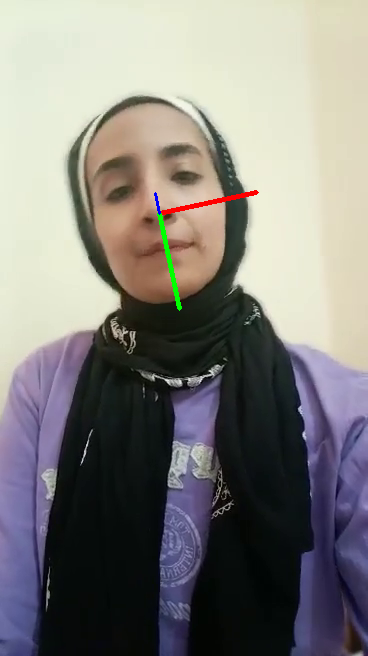

read a new frame: True
0    163
Name: 2, dtype: int64
0    213
Name: 3, dtype: int64
0    163
Name: 2, dtype: int64


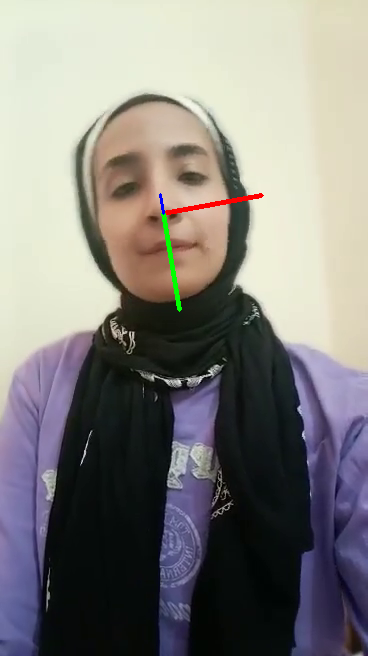

read a new frame: True
0    173
Name: 2, dtype: int64
0    212
Name: 3, dtype: int64
0    173
Name: 2, dtype: int64


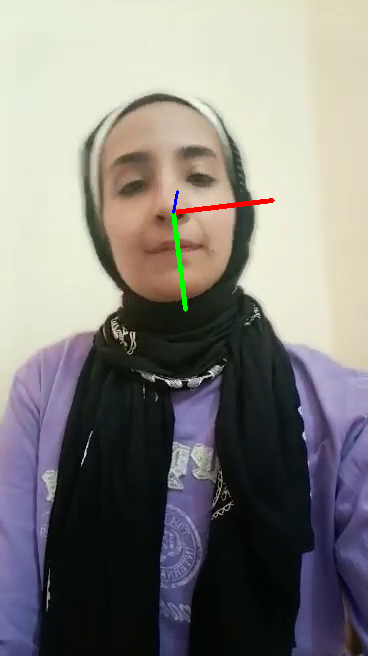

read a new frame: True
0    173
Name: 2, dtype: int64
0    212
Name: 3, dtype: int64
0    173
Name: 2, dtype: int64


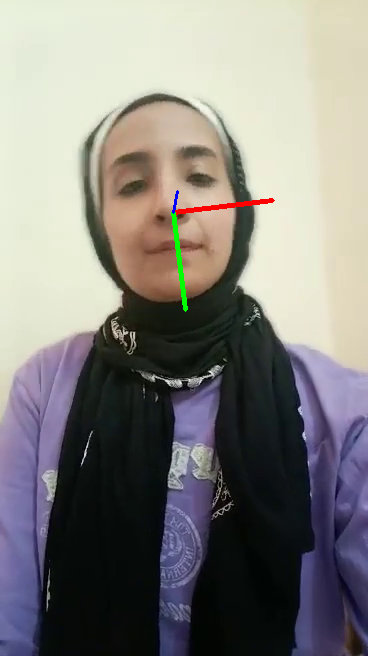

read a new frame: True
0    185
Name: 2, dtype: int64
0    215
Name: 3, dtype: int64
0    185
Name: 2, dtype: int64


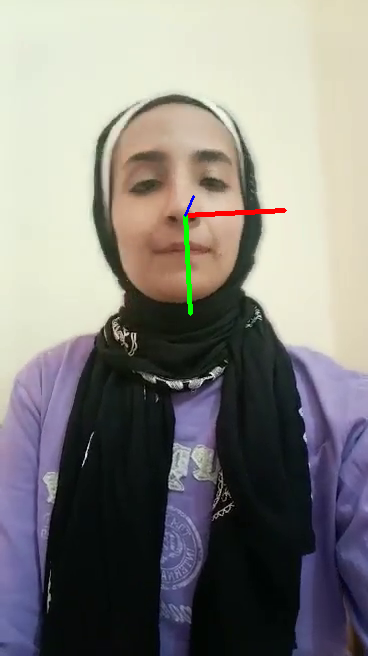

read a new frame: False


error: ignored

In [84]:
video_reading("/content/sample_data/alaa's.mp4")

In [25]:
def test_imj(imj,verbose=0):
        if verbose==1:
          image=imj
        else:
           # loading the image
          image = cv2.imread(imj)
          
        faceModule = mediapipe.solutions.face_mesh
        lfeatures=[]
        with faceModule.FaceMesh(static_image_mode=True) as faces:
       
          # processing the face to extract the landmark points (468 point) for each x,y,z
          results = faces.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
         
          
          if results.multi_face_landmarks != None: 
            # looping over the faces in the image
            for face in results.multi_face_landmarks:
                for landmark in face.landmark:
                    x = landmark.x
                    y = landmark.y
                    
                    # note: the x and y values are scaled to the their width and height so we will get back their actual value in the image
                    shape = image.shape 
                    relative_x = int(x * shape[1])
                    relative_y = int(y * shape[0])
                    lfeatures.extend([relative_x,relative_y])
                    
                
        return lfeatures,image

In [76]:
#transform imj
features,image=test_imj('/content/sample_data/mickey.jpg')
features=pd.DataFrame(features).T
f=features.copy()
origx=f[2]
origy=f[3]
print(origx)
print(origy)


0    242
Name: 2, dtype: int64
0    190
Name: 3, dtype: int64


Test image

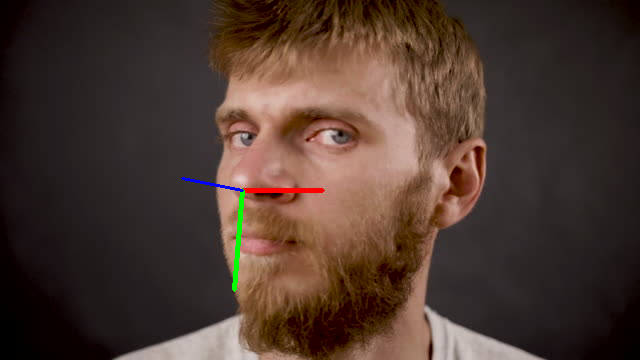

In [77]:
c_features=centeralize_imj(features)
imj_transf=standarize_imj(c_features)
pitch=pitch_sv.predict(imj_transf)
yaw=yaw_sv.predict(imj_transf)
roll=roll_sv.predict(imj_transf)

cv2_imshow(draw_axis(image,pitch,yaw,roll,242,190))
